In [3]:
import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
from PIL import Image
import os
from torchvision import transforms
import pandas as pd
import matplotlib.pyplot as plt
import torch.optim as optim
from tqdm import tqdm
import random
import torch.nn as nn
from hybrid_model_v3 import HybridSegModel
from helper import postprocess_logits_with_fill

import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
from PIL import Image
import os
from torchvision import transforms
import pandas as pd
import matplotlib.pyplot as plt
import torchvision.transforms.functional as tx
import random
import cv2
from PIL import ImageEnhance
from skimage.exposure import match_histograms
import torchvision.transforms as T
import torchvision.transforms.functional as F

In [41]:
image_size = 128
inference_name = "hybrid_model_ge(nodule_gland_inference_v2)_benq(crop_gland)_baseline(1)_freeze_encoder"

model = HybridSegModel(in_channels = 1, out_channels = 2, output_size = image_size, layers_num = 3)
checkpoint = torch.load(f"../../code/models/finetune/ge_benq/{inference_name}/best_checkpoint.pth")
model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

In [42]:
image_dir = os.listdir("images")
print(len(image_dir))

1992


  0%|          | 0/1992 [00:00<?, ?it/s]

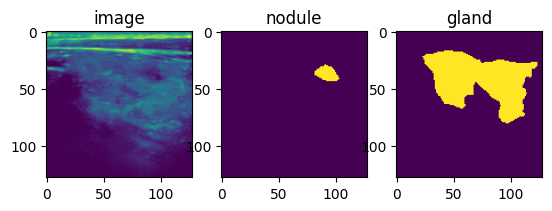

  0%|          | 5/1992 [00:01<11:44,  2.82it/s]

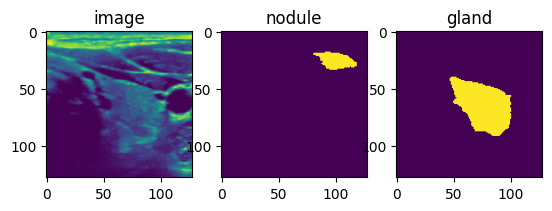

  1%|          | 10/1992 [00:02<08:49,  3.74it/s]

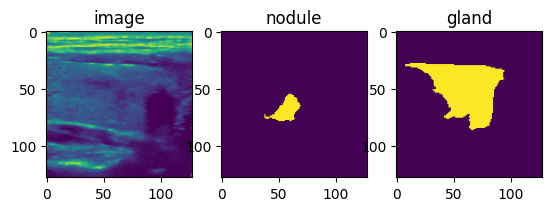

  1%|          | 14/1992 [00:05<15:06,  2.18it/s]

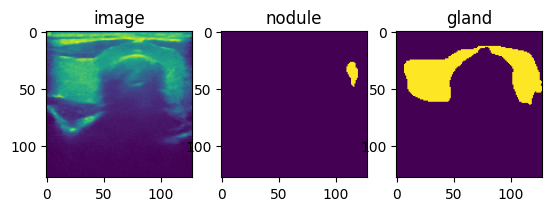

  1%|          | 20/1992 [00:07<13:39,  2.41it/s]

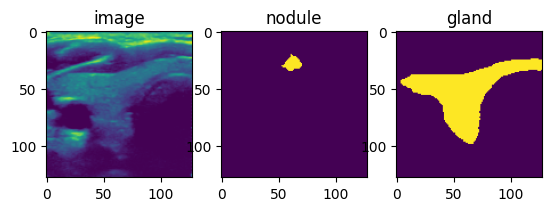

  1%|▏         | 25/1992 [00:09<15:00,  2.19it/s]

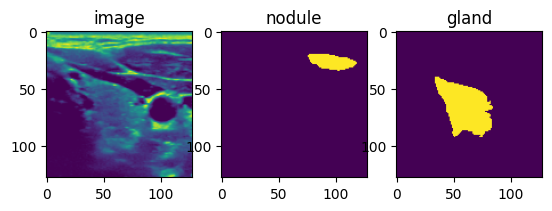

  2%|▏         | 30/1992 [00:13<21:18,  1.53it/s]

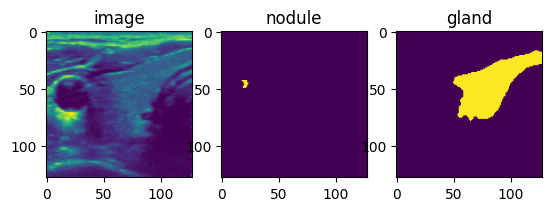

  2%|▏         | 35/1992 [00:16<20:48,  1.57it/s]

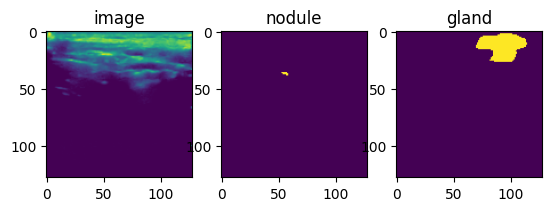

  2%|▏         | 40/1992 [00:17<09:53,  3.29it/s]

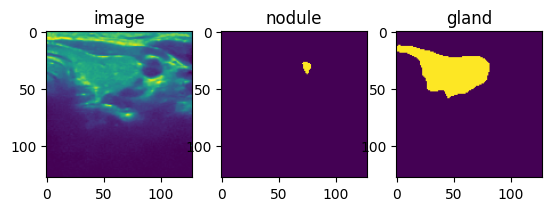

  2%|▏         | 45/1992 [00:18<09:15,  3.51it/s]

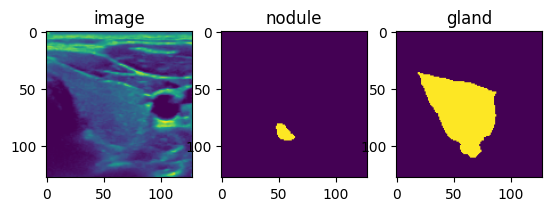

  3%|▎         | 50/1992 [00:20<13:00,  2.49it/s]

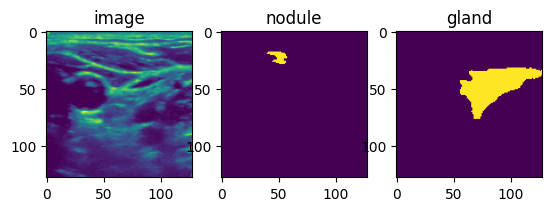

  3%|▎         | 55/1992 [00:24<22:33,  1.43it/s]

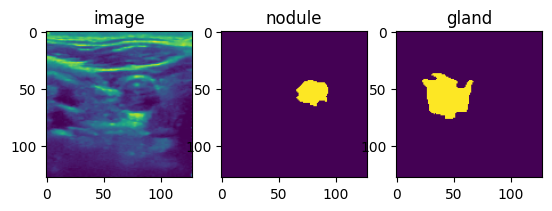

  3%|▎         | 60/1992 [00:32<37:44,  1.17s/it]  

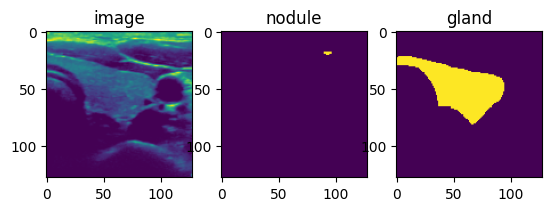

  3%|▎         | 65/1992 [00:36<29:37,  1.08it/s]

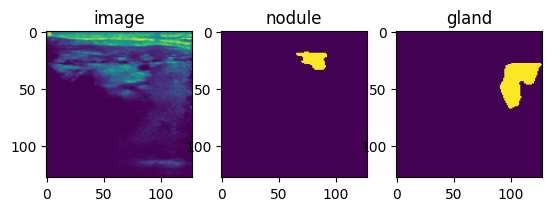

  4%|▎         | 70/1992 [00:37<15:41,  2.04it/s]

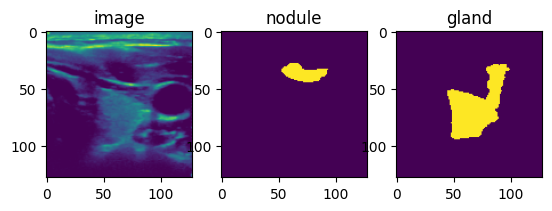

  4%|▍         | 75/1992 [00:40<14:14,  2.24it/s]

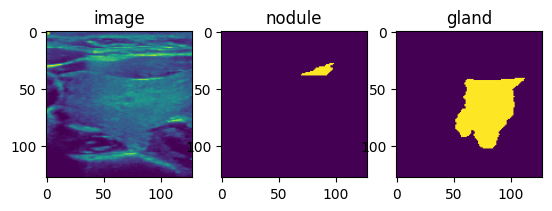

  4%|▍         | 79/1992 [00:42<17:46,  1.79it/s]

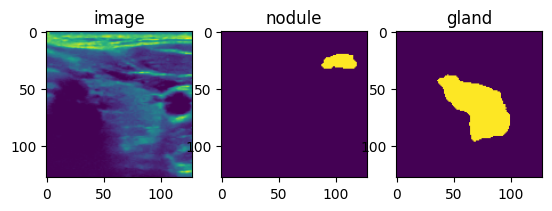

  4%|▍         | 85/1992 [00:44<10:24,  3.06it/s]

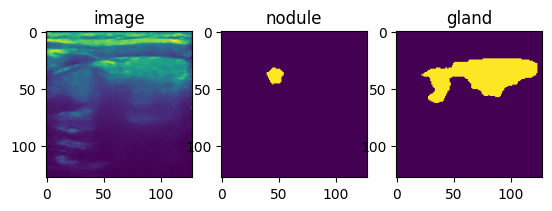

  5%|▍         | 90/1992 [00:47<18:04,  1.75it/s]

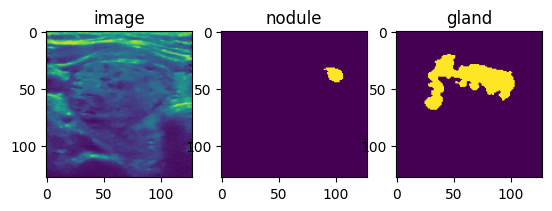

  5%|▍         | 94/1992 [00:49<17:40,  1.79it/s]

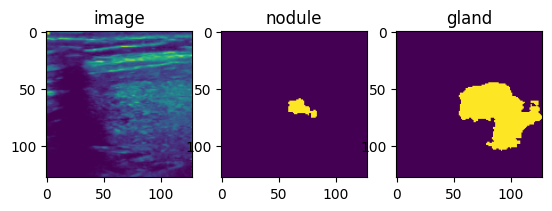

  5%|▌         | 100/1992 [00:52<15:31,  2.03it/s]

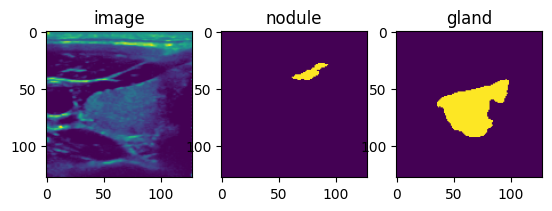

  5%|▌         | 105/1992 [00:54<14:30,  2.17it/s]

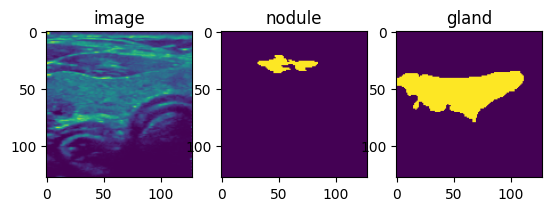

  6%|▌         | 110/1992 [00:58<24:12,  1.30it/s]

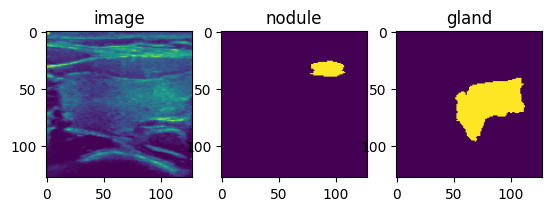

  6%|▌         | 115/1992 [01:00<15:27,  2.02it/s]

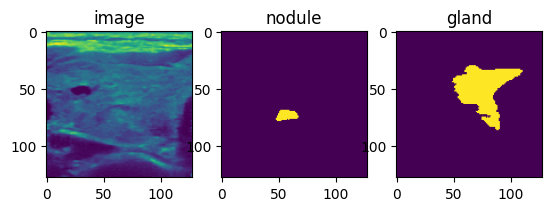

  6%|▌         | 120/1992 [01:06<29:32,  1.06it/s]

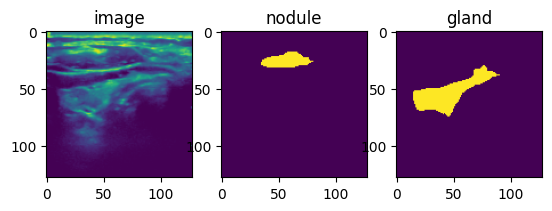

  6%|▌         | 124/1992 [01:08<20:39,  1.51it/s]

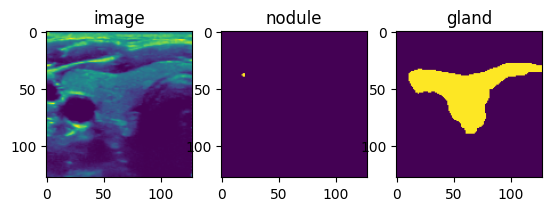

  7%|▋         | 130/1992 [01:11<19:02,  1.63it/s]

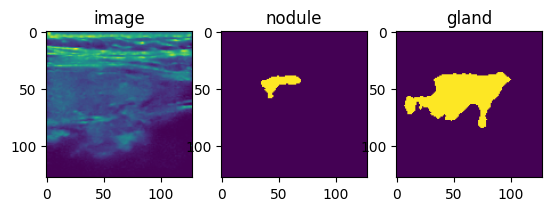

  7%|▋         | 134/1992 [01:13<16:53,  1.83it/s]

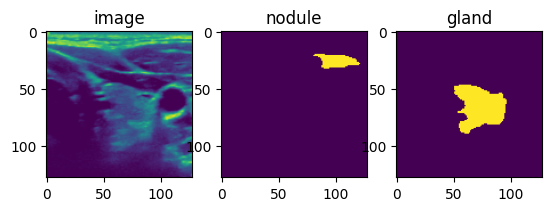

  7%|▋         | 140/1992 [01:17<17:13,  1.79it/s]

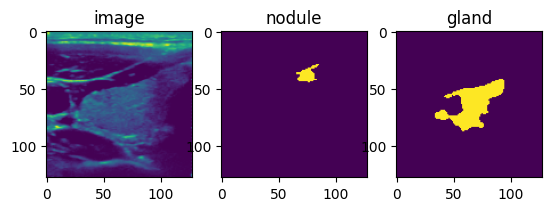

  7%|▋         | 145/1992 [01:21<24:01,  1.28it/s]

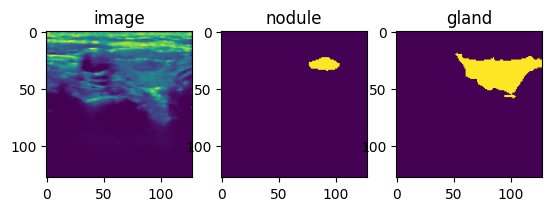

  8%|▊         | 150/1992 [01:24<19:15,  1.59it/s]

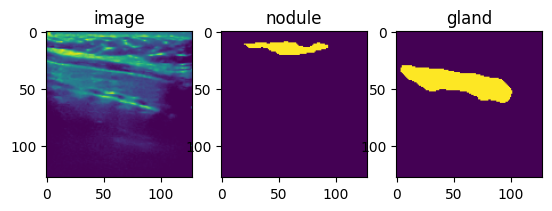

  8%|▊         | 155/1992 [01:28<20:49,  1.47it/s]

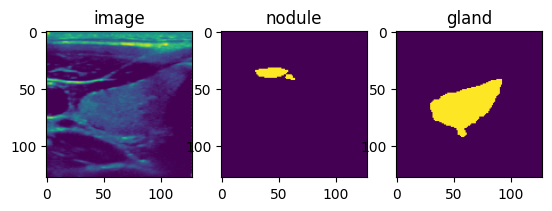

  8%|▊         | 159/1992 [01:31<26:49,  1.14it/s]

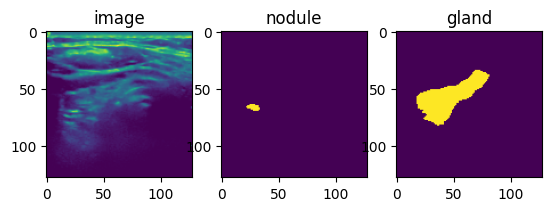

  8%|▊         | 165/1992 [01:36<22:48,  1.33it/s]

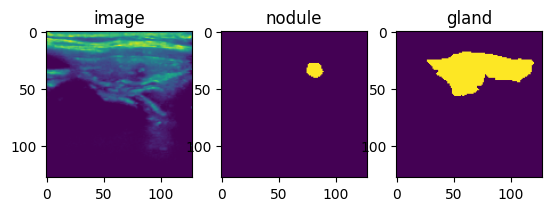

  9%|▊         | 170/1992 [01:42<22:40,  1.34it/s]

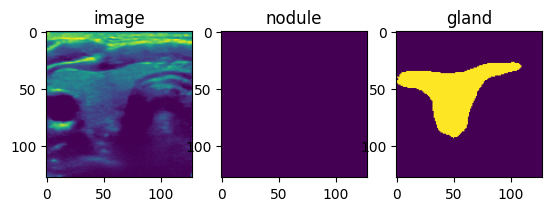

  9%|▉         | 175/1992 [01:43<13:03,  2.32it/s]

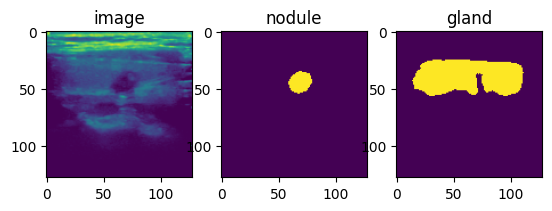

  9%|▉         | 180/1992 [01:45<12:48,  2.36it/s]

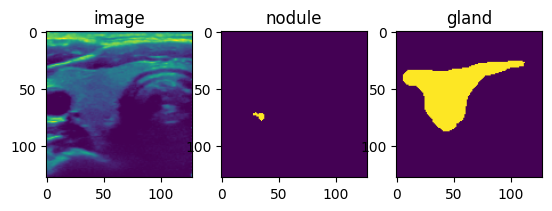

  9%|▉         | 185/1992 [01:49<18:34,  1.62it/s]

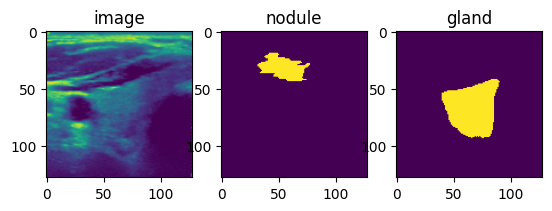

 10%|▉         | 190/1992 [01:53<20:10,  1.49it/s]

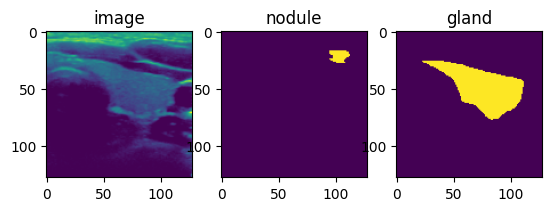

 10%|▉         | 194/1992 [01:53<11:21,  2.64it/s]

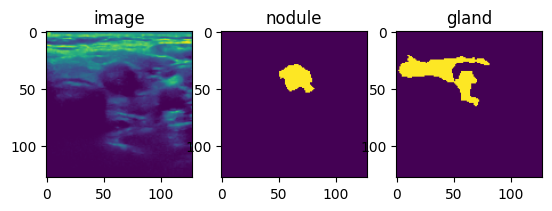

 10%|█         | 200/1992 [01:57<15:13,  1.96it/s]

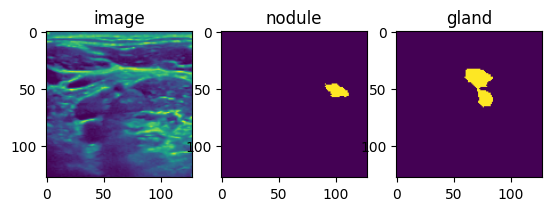

 10%|█         | 205/1992 [01:58<09:28,  3.14it/s]

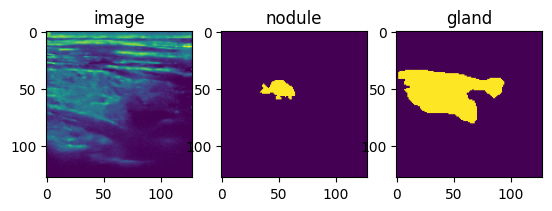

 11%|█         | 210/1992 [02:01<15:43,  1.89it/s]

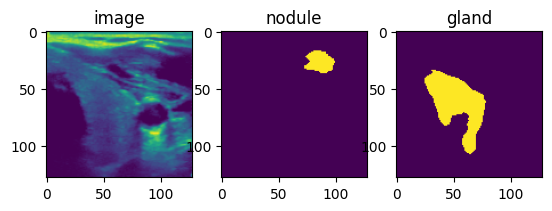

 11%|█         | 215/1992 [02:05<20:31,  1.44it/s]

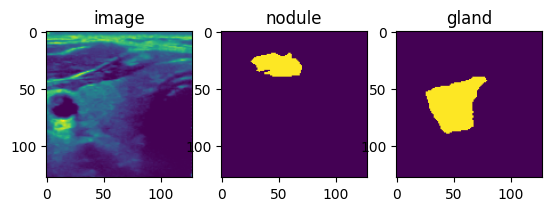

 11%|█         | 220/1992 [02:07<10:35,  2.79it/s]

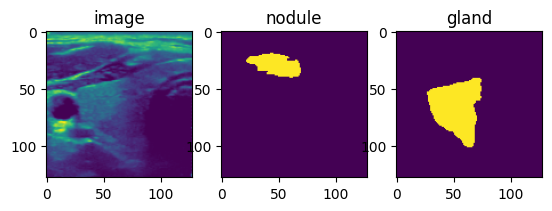

 11%|█▏        | 225/1992 [02:11<24:17,  1.21it/s]

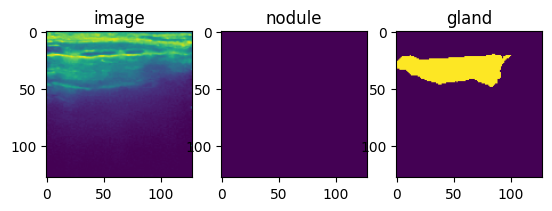

 12%|█▏        | 230/1992 [02:13<10:27,  2.81it/s]

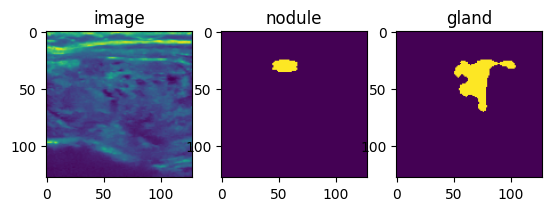

 12%|█▏        | 235/1992 [02:16<14:21,  2.04it/s]

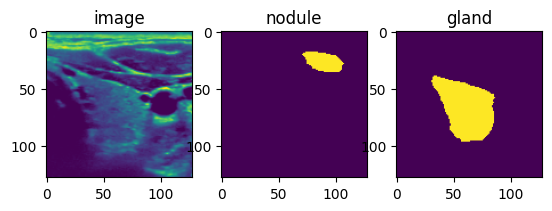

 12%|█▏        | 240/1992 [02:18<12:12,  2.39it/s]

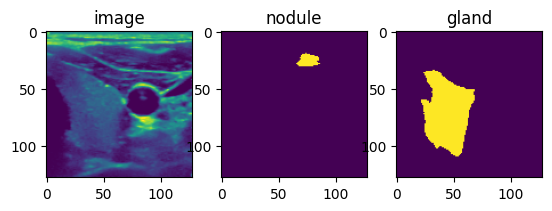

 12%|█▏        | 245/1992 [02:22<20:42,  1.41it/s]

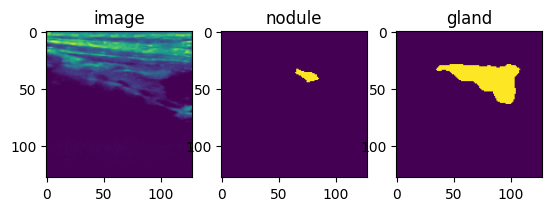

 12%|█▎        | 249/1992 [02:24<16:52,  1.72it/s]

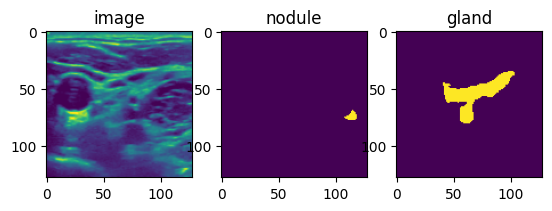

 13%|█▎        | 255/1992 [02:26<11:26,  2.53it/s]

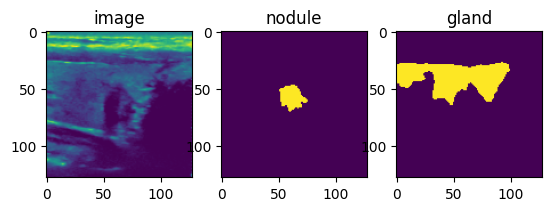

 13%|█▎        | 259/1992 [02:29<16:37,  1.74it/s]

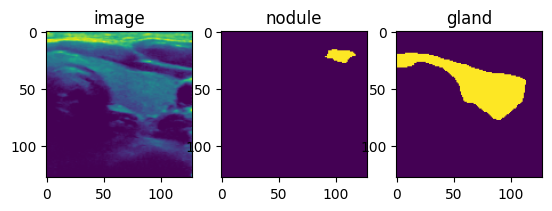

 13%|█▎        | 264/1992 [02:32<14:54,  1.93it/s]

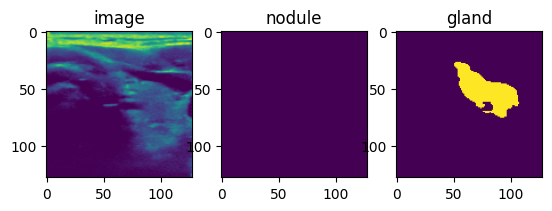

 14%|█▎        | 269/1992 [02:35<14:44,  1.95it/s]

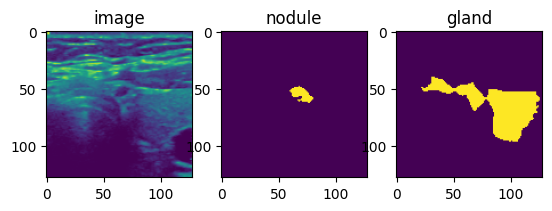

 14%|█▍        | 275/1992 [03:04<1:24:46,  2.96s/it]

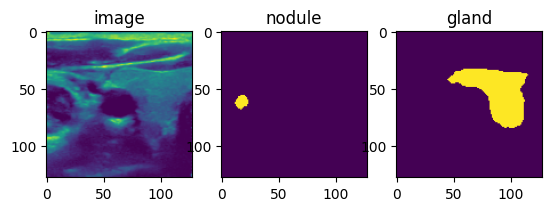

 14%|█▍        | 280/1992 [03:27<2:05:14,  4.39s/it]

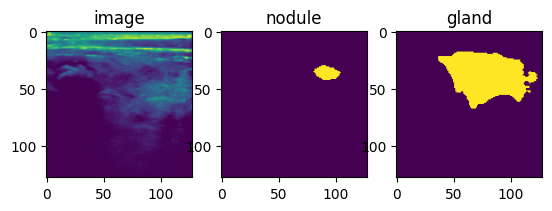

 14%|█▍        | 285/1992 [03:29<31:27,  1.11s/it]  

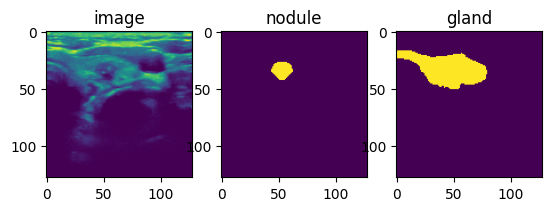

 15%|█▍        | 290/1992 [04:10<3:15:10,  6.88s/it]

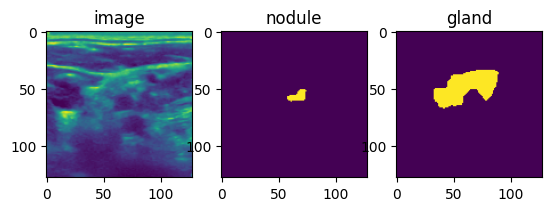

 15%|█▍        | 295/1992 [04:47<2:34:56,  5.48s/it]

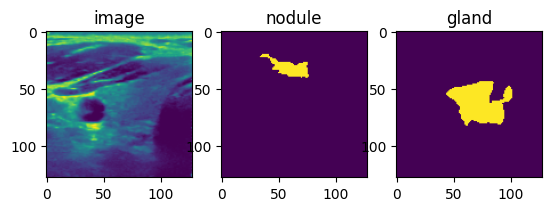

 15%|█▌        | 300/1992 [05:00<1:24:56,  3.01s/it]

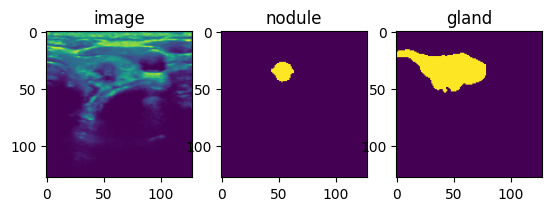

 15%|█▌        | 305/1992 [05:09<45:48,  1.63s/it]  

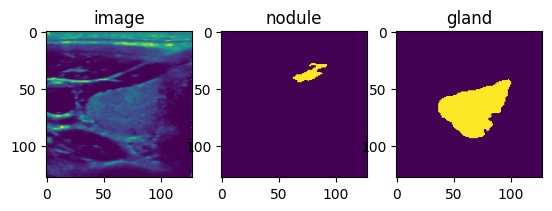

 16%|█▌        | 310/1992 [05:13<27:07,  1.03it/s]

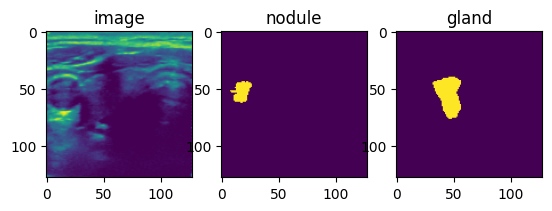

 16%|█▌        | 315/1992 [05:18<28:23,  1.02s/it]

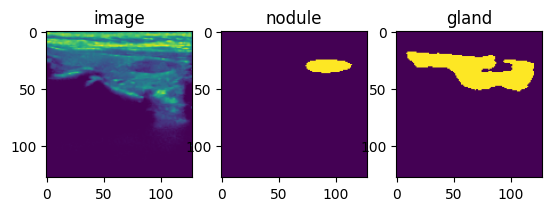

 16%|█▌        | 320/1992 [05:19<12:16,  2.27it/s]

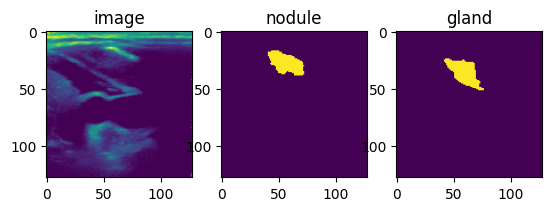

 16%|█▋        | 325/1992 [05:21<10:04,  2.76it/s]

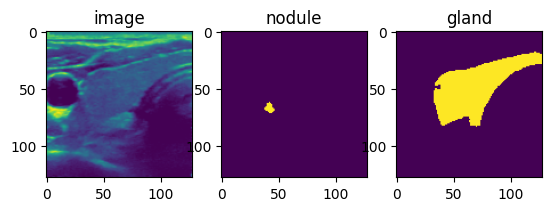

 17%|█▋        | 330/1992 [05:27<25:16,  1.10it/s]

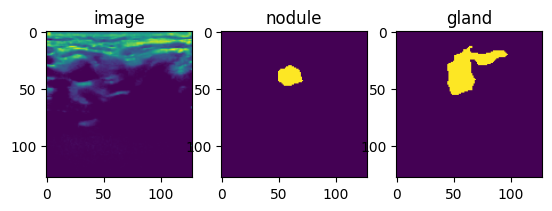

 17%|█▋        | 335/1992 [05:30<15:56,  1.73it/s]

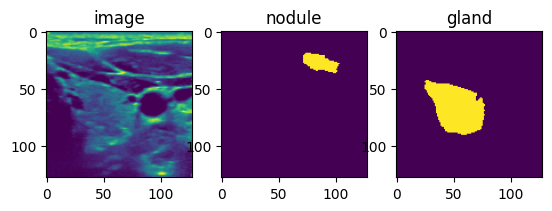

 17%|█▋        | 339/1992 [05:47<1:35:33,  3.47s/it]

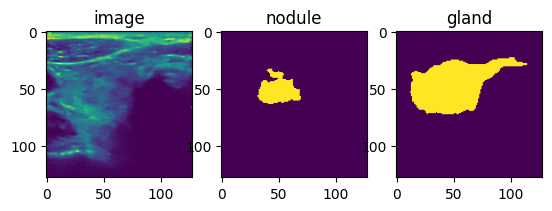

 17%|█▋        | 345/1992 [05:51<29:38,  1.08s/it]  

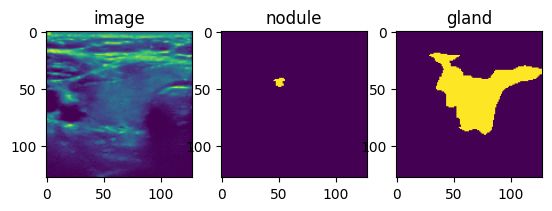

 18%|█▊        | 349/1992 [05:56<26:06,  1.05it/s]

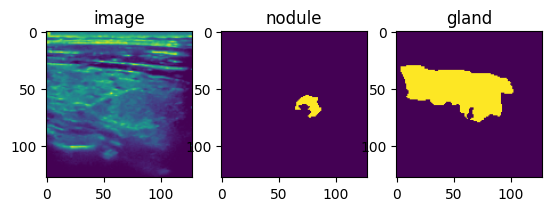

 18%|█▊        | 355/1992 [06:00<21:40,  1.26it/s]

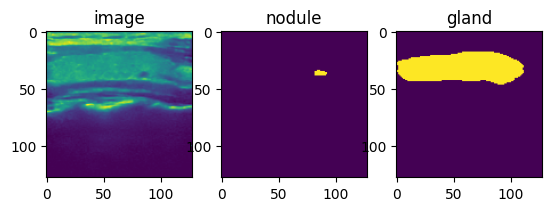

 18%|█▊        | 360/1992 [06:04<24:25,  1.11it/s]

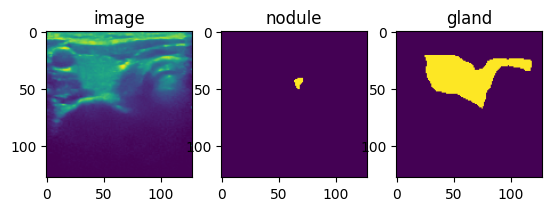

 18%|█▊        | 365/1992 [06:06<11:47,  2.30it/s]

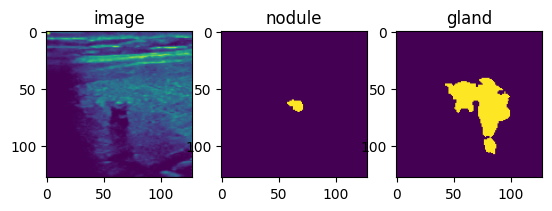

 19%|█▊        | 370/1992 [06:08<09:05,  2.97it/s]

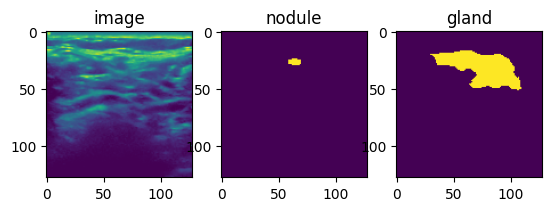

 19%|█▉        | 375/1992 [06:10<12:17,  2.19it/s]

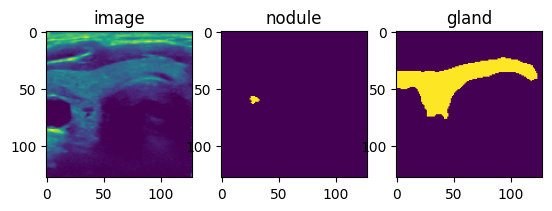

 19%|█▉        | 380/1992 [06:16<27:45,  1.03s/it]

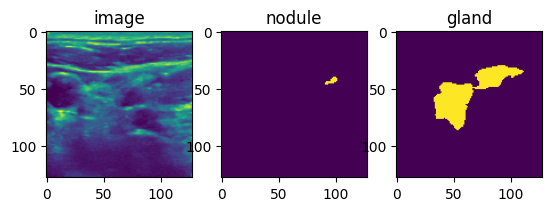

 19%|█▉        | 385/1992 [06:20<24:21,  1.10it/s]

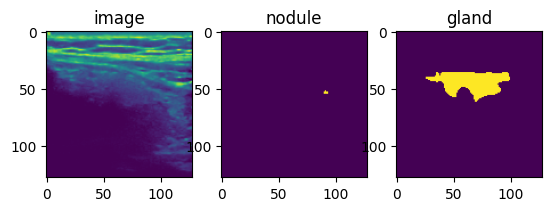

 20%|█▉        | 389/1992 [06:23<18:40,  1.43it/s]

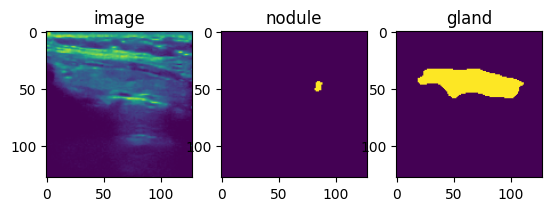

 20%|█▉        | 394/1992 [06:26<20:07,  1.32it/s]

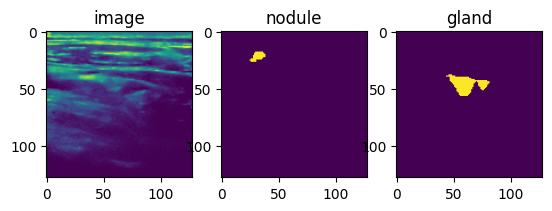

 20%|██        | 400/1992 [06:28<07:53,  3.36it/s]

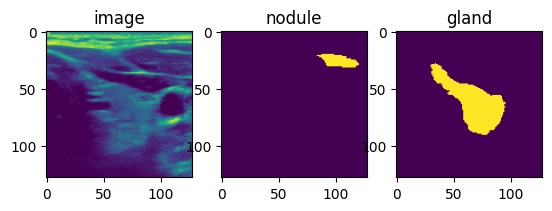

 20%|██        | 405/1992 [06:31<14:59,  1.76it/s]

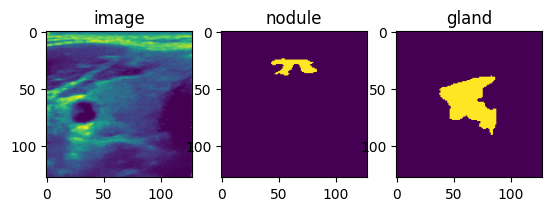

 21%|██        | 410/1992 [06:39<31:59,  1.21s/it]

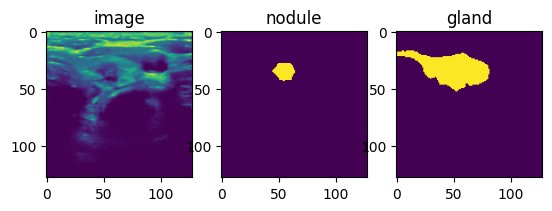

 21%|██        | 415/1992 [06:40<09:35,  2.74it/s]

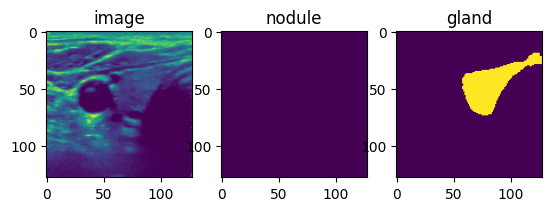

 21%|██        | 420/1992 [06:41<04:39,  5.62it/s]

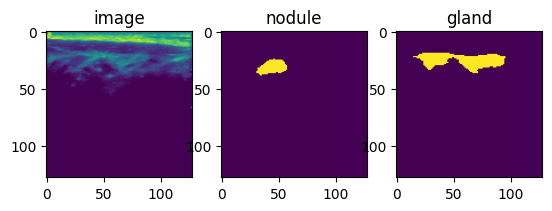

 21%|██▏       | 424/1992 [06:43<09:23,  2.78it/s]

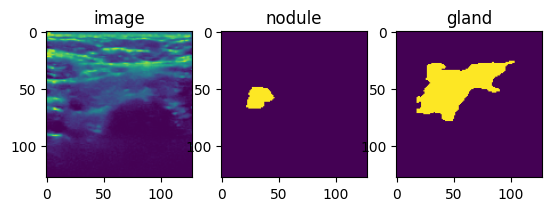

 22%|██▏       | 429/1992 [06:45<12:57,  2.01it/s]

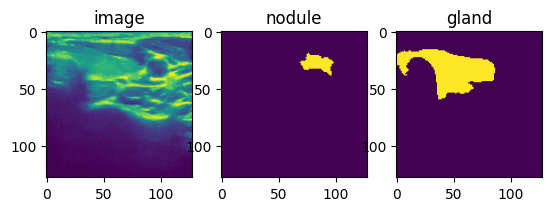

 22%|██▏       | 434/1992 [06:49<17:58,  1.44it/s]

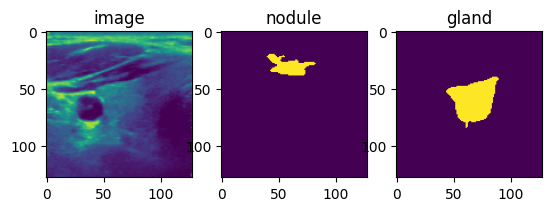

 22%|██▏       | 439/1992 [06:50<07:27,  3.47it/s]

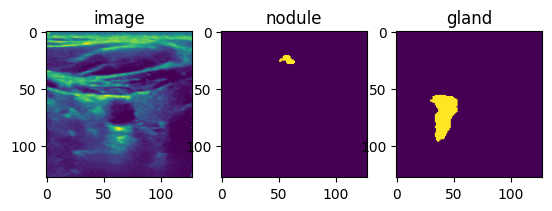

 22%|██▏       | 445/1992 [06:54<16:58,  1.52it/s]

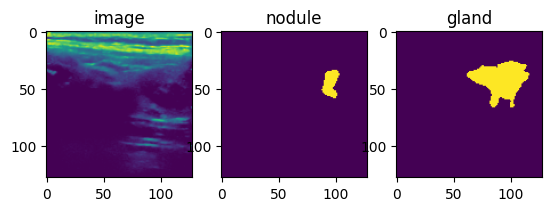

 23%|██▎       | 450/1992 [06:55<09:27,  2.72it/s]

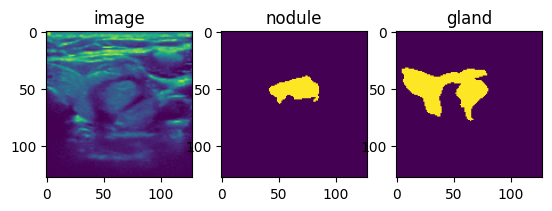

 23%|██▎       | 455/1992 [06:57<08:45,  2.93it/s]

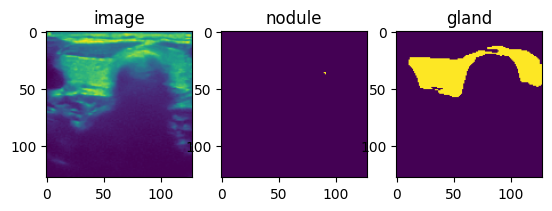

 23%|██▎       | 460/1992 [06:59<08:02,  3.18it/s]

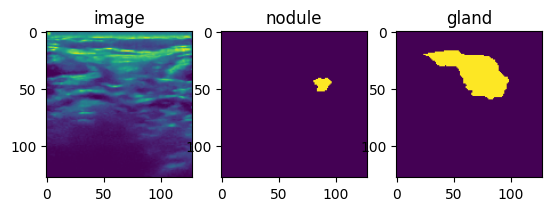

 23%|██▎       | 464/1992 [07:01<11:52,  2.14it/s]

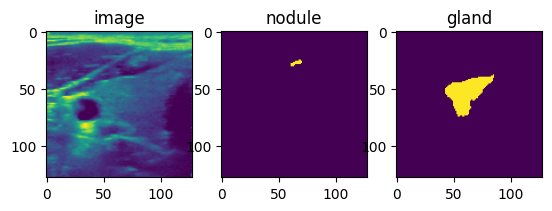

 24%|██▎       | 470/1992 [07:02<09:15,  2.74it/s]

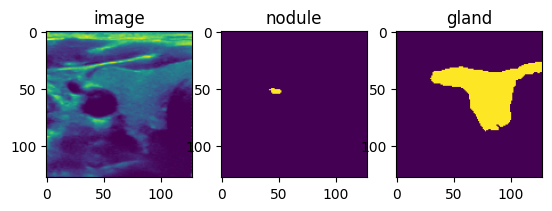

 24%|██▍       | 475/1992 [07:06<17:59,  1.41it/s]

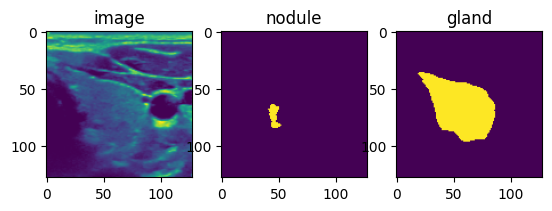

 24%|██▍       | 480/1992 [07:09<15:02,  1.67it/s]

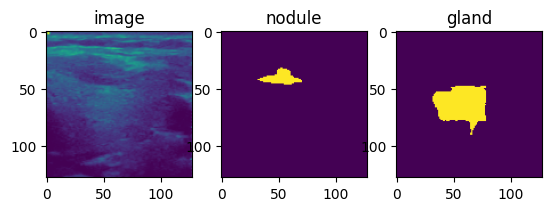

 24%|██▍       | 485/1992 [07:14<23:16,  1.08it/s]

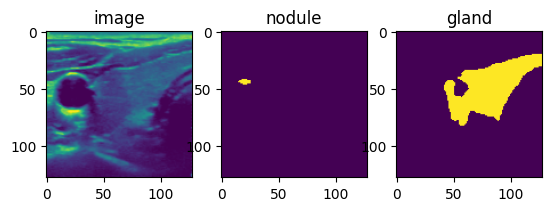

 25%|██▍       | 490/1992 [07:19<33:01,  1.32s/it]

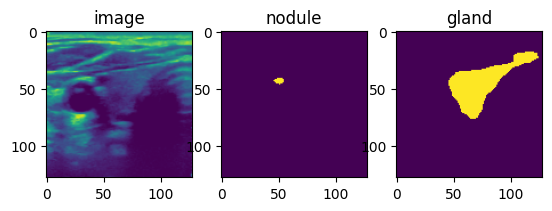

 25%|██▍       | 495/1992 [07:22<15:52,  1.57it/s]

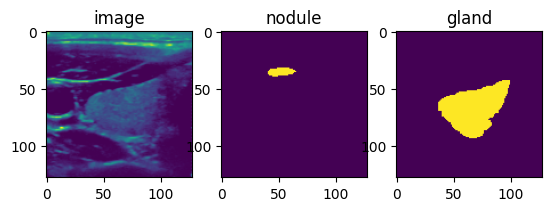

 25%|██▌       | 500/1992 [07:35<1:32:36,  3.72s/it]

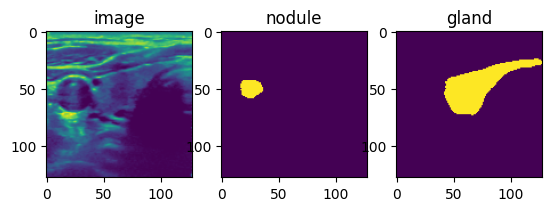

 25%|██▌       | 505/1992 [08:25<3:33:48,  8.63s/it]

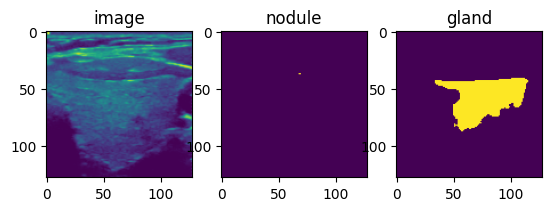

 26%|██▌       | 510/1992 [08:49<2:21:36,  5.73s/it]

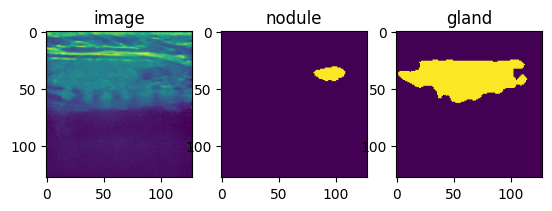

 26%|██▌       | 515/1992 [09:04<1:59:57,  4.87s/it]

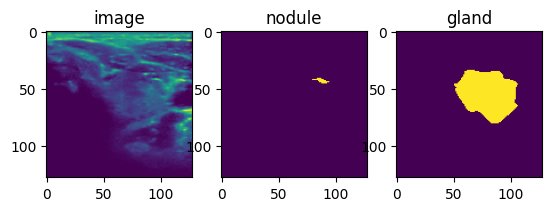

 26%|██▌       | 520/1992 [09:45<2:37:17,  6.41s/it]

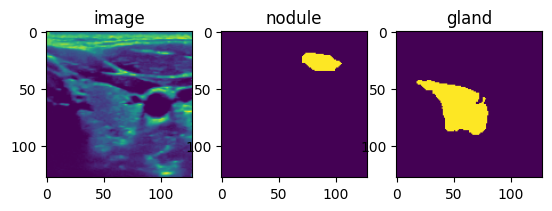

 26%|██▋       | 525/1992 [09:53<1:14:35,  3.05s/it]

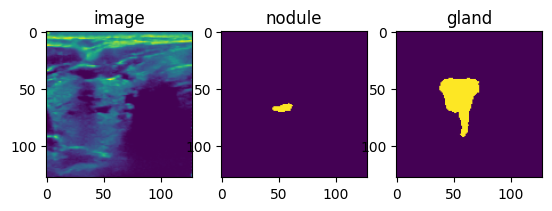

 27%|██▋       | 530/1992 [10:26<2:52:22,  7.07s/it]

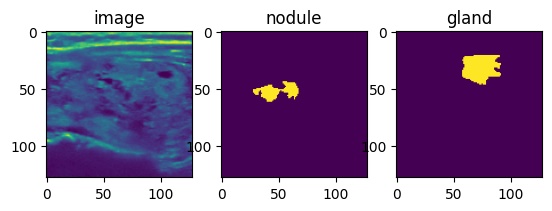

 27%|██▋       | 535/1992 [11:09<3:43:41,  9.21s/it]

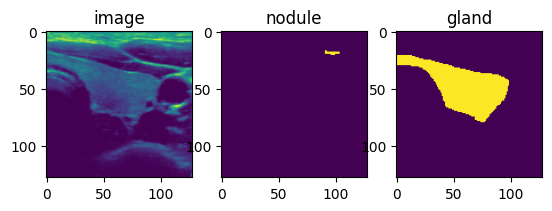

 27%|██▋       | 540/1992 [11:53<3:39:05,  9.05s/it]

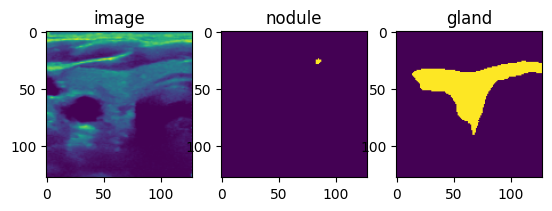

 27%|██▋       | 545/1992 [12:37<3:44:41,  9.32s/it]

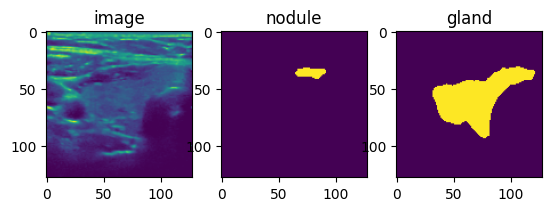

 28%|██▊       | 551/1992 [13:22<3:02:50,  7.61s/it]

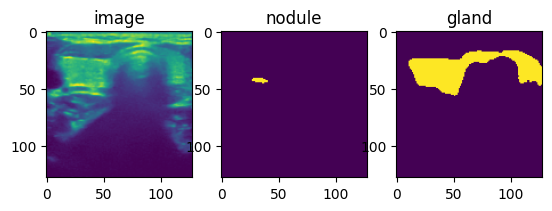

 28%|██▊       | 556/1992 [14:07<3:43:41,  9.35s/it]

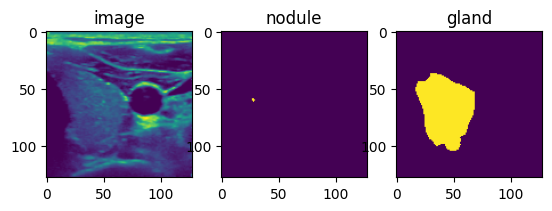

 28%|██▊       | 561/1992 [14:22<1:11:53,  3.01s/it]

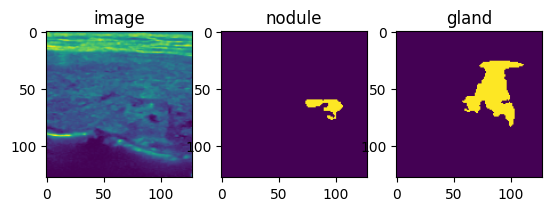

 28%|██▊       | 566/1992 [14:48<2:03:23,  5.19s/it]

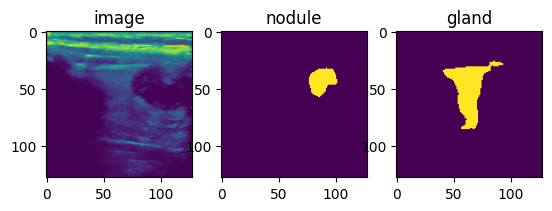

 29%|██▊       | 571/1992 [15:09<1:09:12,  2.92s/it]

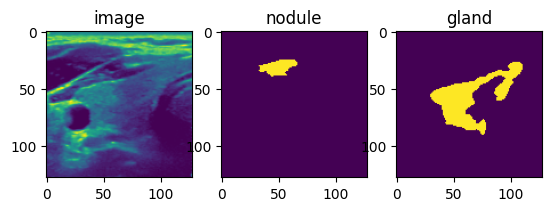

 29%|██▉       | 576/1992 [15:23<45:02,  1.91s/it]  

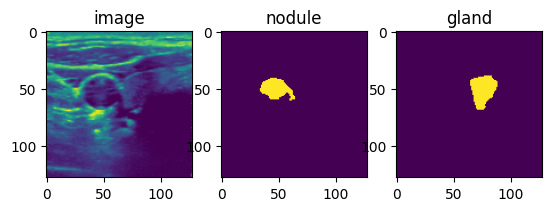

 29%|██▉       | 581/1992 [15:32<51:11,  2.18s/it]  

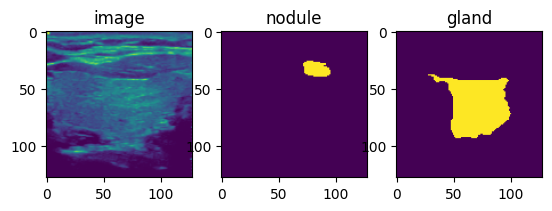

 29%|██▉       | 586/1992 [15:52<1:47:49,  4.60s/it]

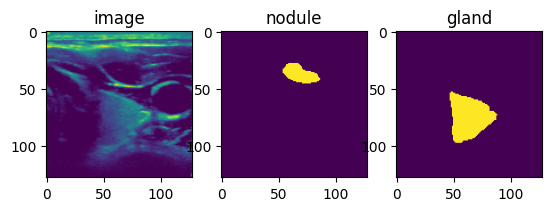

 30%|██▉       | 591/1992 [16:26<2:37:14,  6.73s/it]

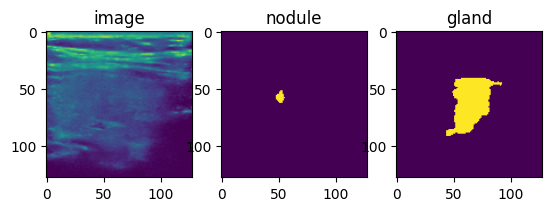

 30%|██▉       | 596/1992 [16:43<1:23:23,  3.58s/it]

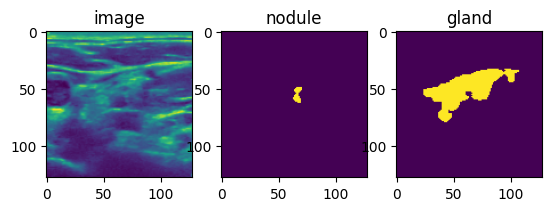

 30%|███       | 601/1992 [16:46<26:34,  1.15s/it]  

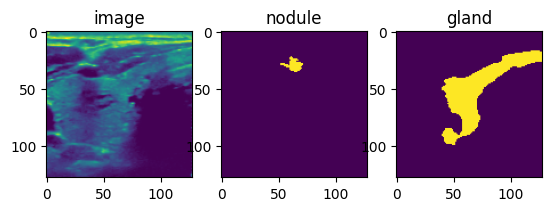

 30%|███       | 606/1992 [17:02<1:17:36,  3.36s/it]

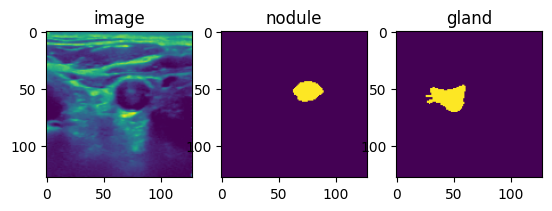

 31%|███       | 611/1992 [17:50<3:10:50,  8.29s/it]

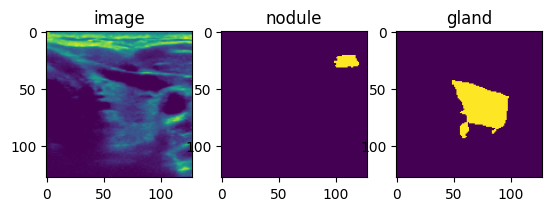

 31%|███       | 616/1992 [17:53<40:31,  1.77s/it]  

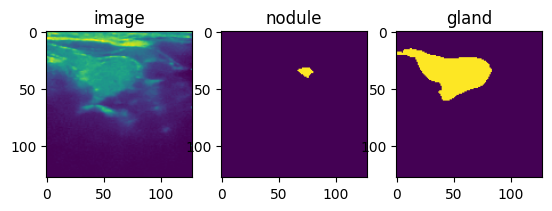

 31%|███       | 621/1992 [18:16<1:36:56,  4.24s/it]

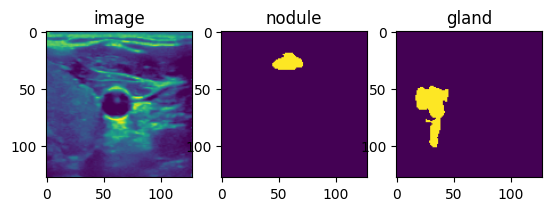

 31%|███▏      | 626/1992 [18:31<52:51,  2.32s/it]  

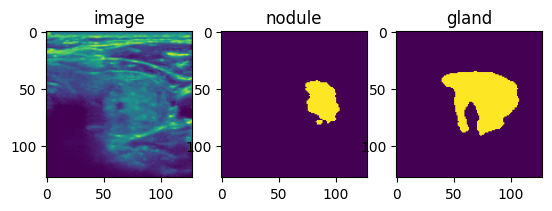

 32%|███▏      | 631/1992 [18:39<57:03,  2.52s/it]

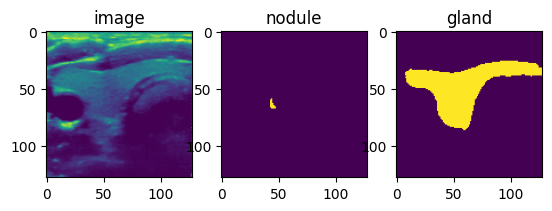

 32%|███▏      | 636/1992 [19:06<1:09:10,  3.06s/it]

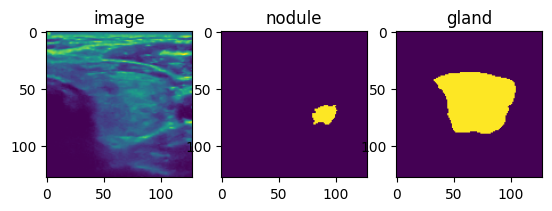

 32%|███▏      | 641/1992 [19:23<1:52:51,  5.01s/it]

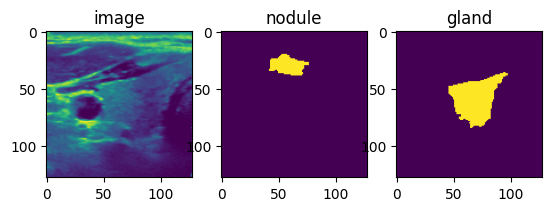

 32%|███▏      | 646/1992 [20:07<2:41:34,  7.20s/it]

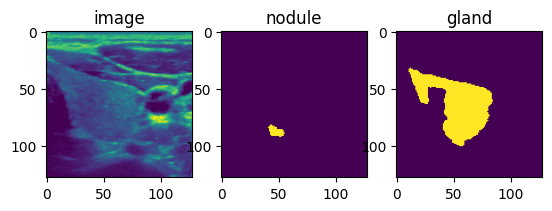

 33%|███▎      | 651/1992 [20:47<3:15:41,  8.76s/it]

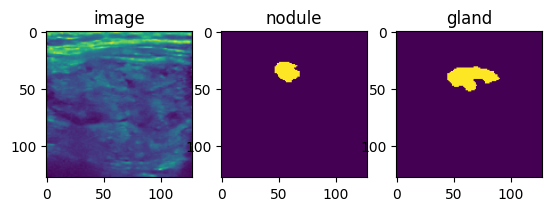

 33%|███▎      | 656/1992 [21:37<3:28:47,  9.38s/it]

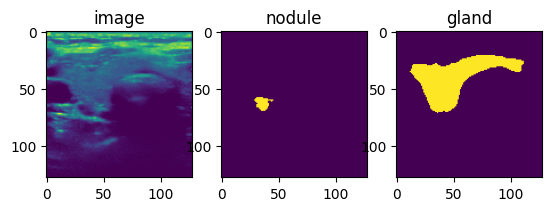

 33%|███▎      | 661/1992 [21:57<1:19:57,  3.60s/it]

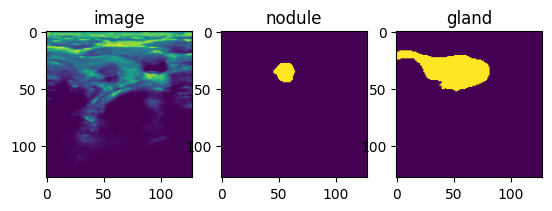

 33%|███▎      | 665/1992 [21:58<24:00,  1.09s/it]  

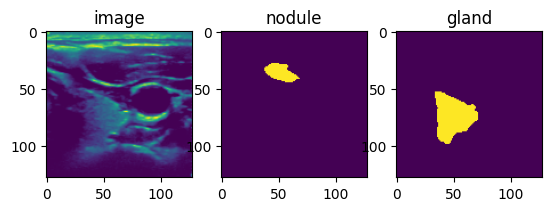

 34%|███▎      | 671/1992 [22:33<2:08:46,  5.85s/it]

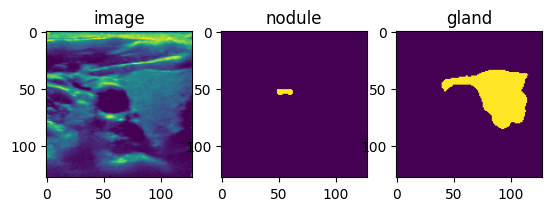

 34%|███▍      | 676/1992 [22:59<2:00:58,  5.52s/it]

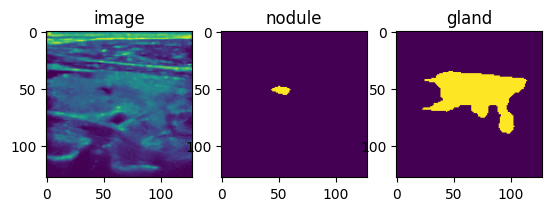

 34%|███▍      | 681/1992 [23:03<39:56,  1.83s/it]  

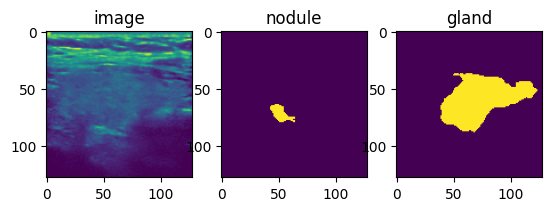

 34%|███▍      | 686/1992 [23:06<23:19,  1.07s/it]

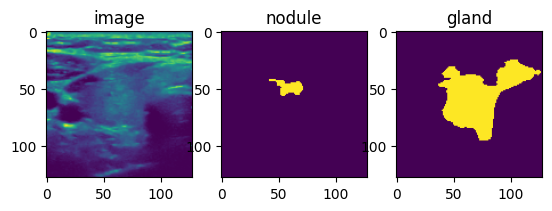

 35%|███▍      | 691/1992 [23:22<1:06:19,  3.06s/it]

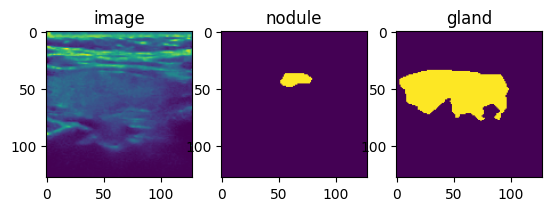

 35%|███▍      | 696/1992 [23:37<52:07,  2.41s/it]  

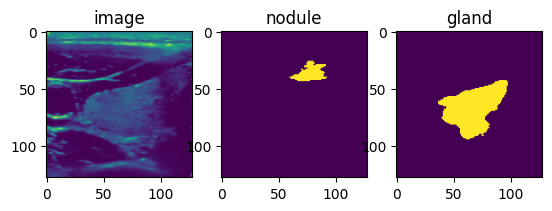

 35%|███▌      | 701/1992 [23:51<1:20:44,  3.75s/it]

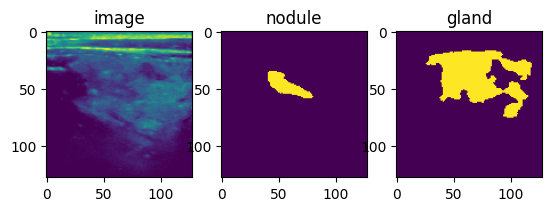

 35%|███▌      | 706/1992 [24:19<2:08:14,  5.98s/it]

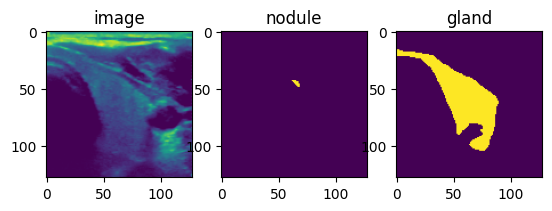

 36%|███▌      | 711/1992 [24:38<1:11:58,  3.37s/it]

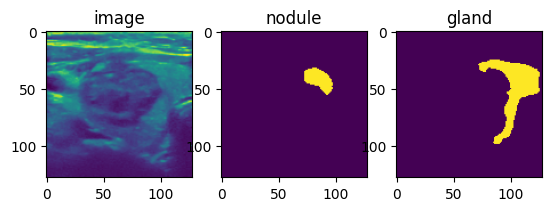

 36%|███▌      | 716/1992 [24:51<51:48,  2.44s/it]  

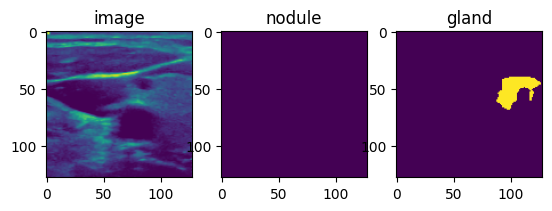

 36%|███▌      | 721/1992 [24:55<17:31,  1.21it/s]

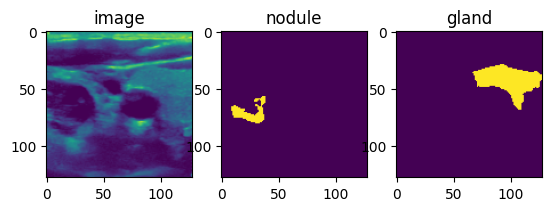

 36%|███▋      | 726/1992 [25:06<40:03,  1.90s/it]

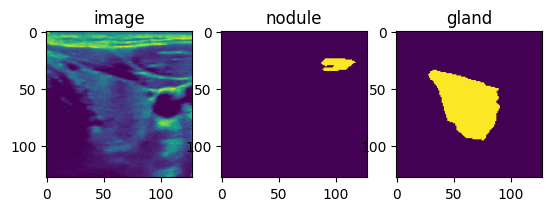

 37%|███▋      | 731/1992 [25:41<2:19:18,  6.63s/it]

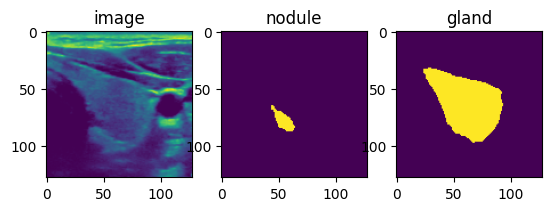

 37%|███▋      | 736/1992 [26:01<1:47:53,  5.15s/it]

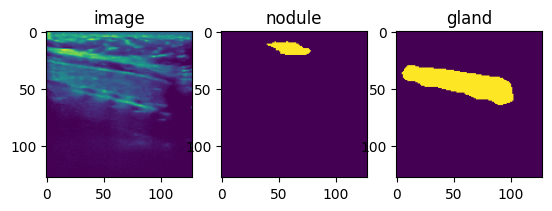

 37%|███▋      | 741/1992 [26:20<1:28:29,  4.24s/it]

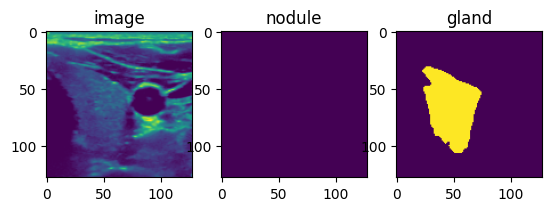

 37%|███▋      | 746/1992 [26:23<27:21,  1.32s/it]  

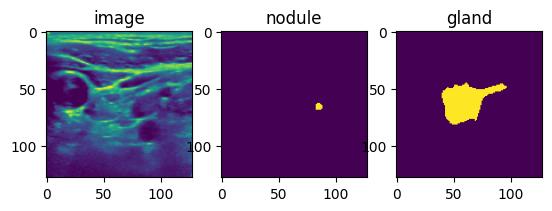

 38%|███▊      | 751/1992 [26:39<37:55,  1.83s/it]  

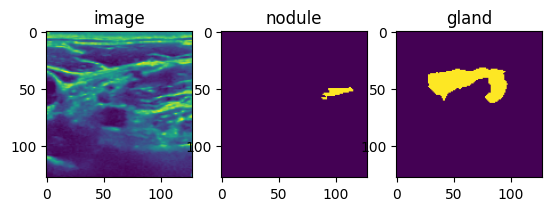

 38%|███▊      | 755/1992 [26:48<33:05,  1.61s/it]

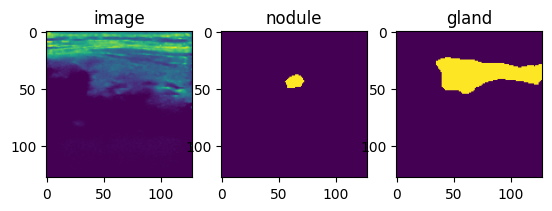

 38%|███▊      | 761/1992 [27:12<1:13:38,  3.59s/it]

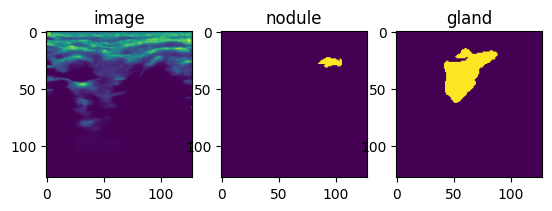

 38%|███▊      | 766/1992 [27:20<49:39,  2.43s/it]  

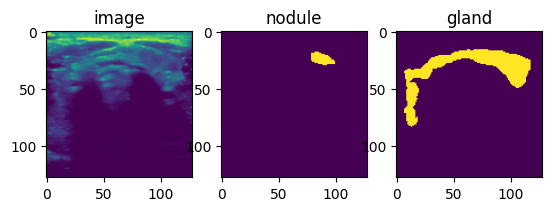

 39%|███▊      | 770/1992 [27:42<1:32:13,  4.53s/it]

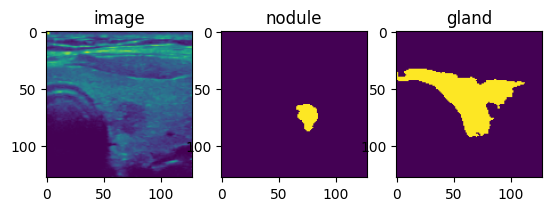

 39%|███▉      | 776/1992 [28:20<2:11:25,  6.49s/it]

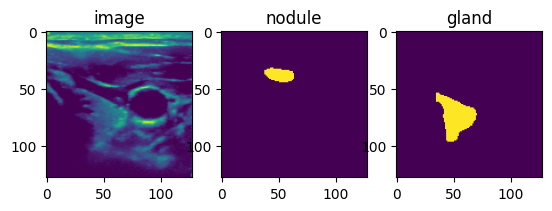

 39%|███▉      | 781/1992 [28:37<1:30:22,  4.48s/it]

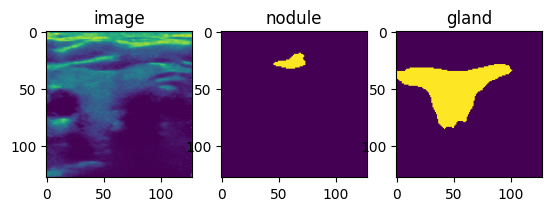

 39%|███▉      | 786/1992 [28:56<1:33:00,  4.63s/it]

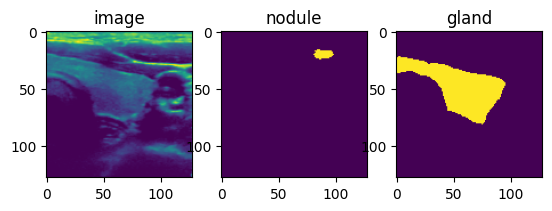

 40%|███▉      | 791/1992 [29:24<2:10:27,  6.52s/it]

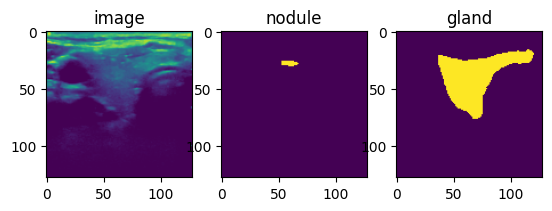

 40%|███▉      | 796/1992 [29:52<1:41:29,  5.09s/it]

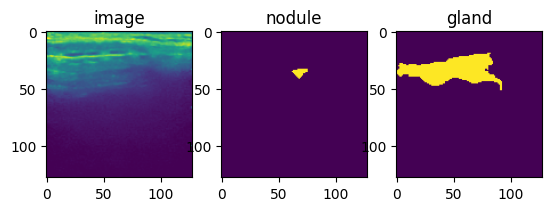

 40%|████      | 801/1992 [30:37<2:34:39,  7.79s/it]

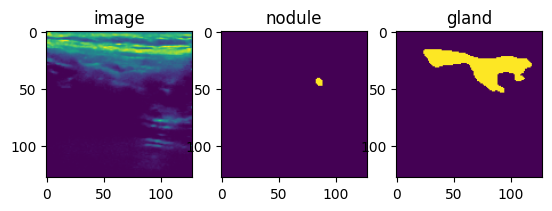

 40%|████      | 806/1992 [30:49<48:26,  2.45s/it]  

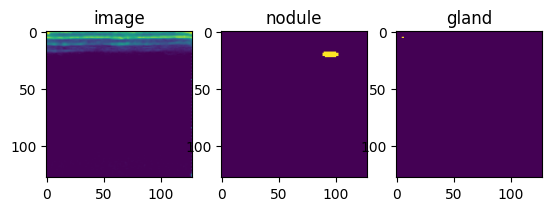

 41%|████      | 811/1992 [31:00<1:10:15,  3.57s/it]

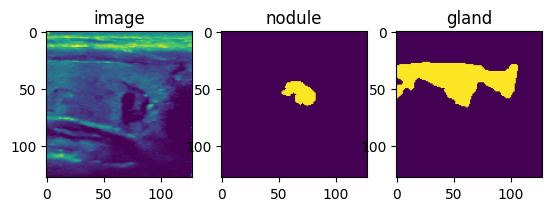

 41%|████      | 816/1992 [31:18<43:28,  2.22s/it]  

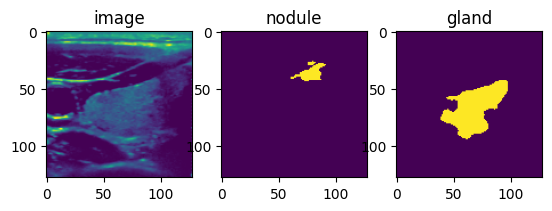

 41%|████      | 820/1992 [31:20<17:25,  1.12it/s]

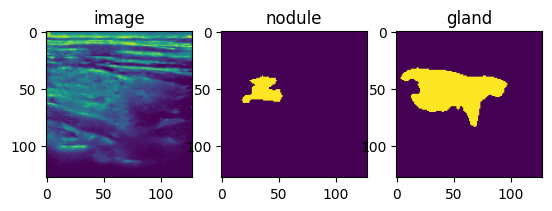

 41%|████▏     | 826/1992 [31:21<06:19,  3.08it/s]

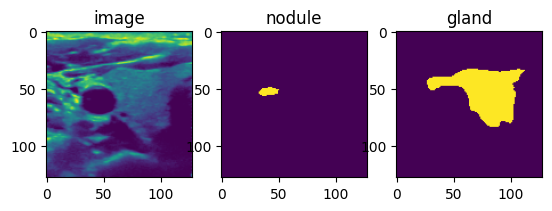

 42%|████▏     | 830/1992 [31:23<08:12,  2.36it/s]

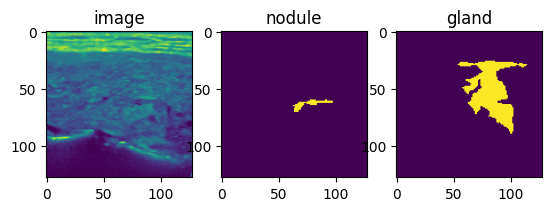

 42%|████▏     | 836/1992 [31:26<07:30,  2.57it/s]

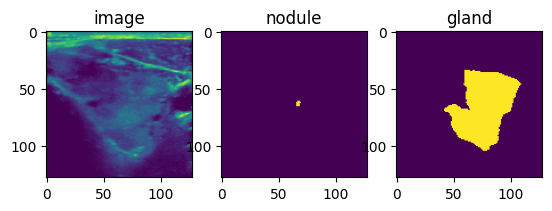

 42%|████▏     | 841/1992 [31:27<06:03,  3.17it/s]

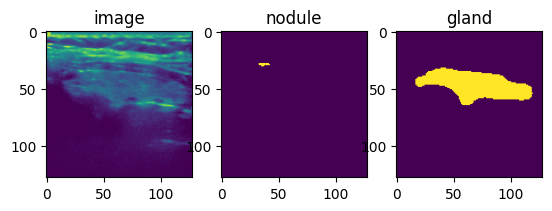

 42%|████▏     | 846/1992 [31:30<07:31,  2.54it/s]

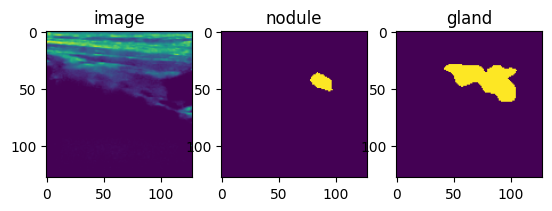

 43%|████▎     | 851/1992 [31:33<11:45,  1.62it/s]

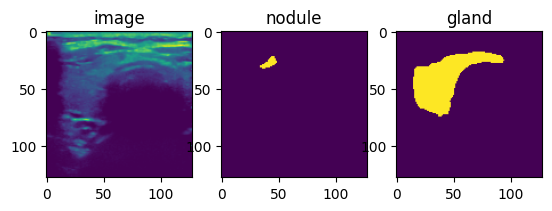

 43%|████▎     | 856/1992 [31:34<05:09,  3.68it/s]

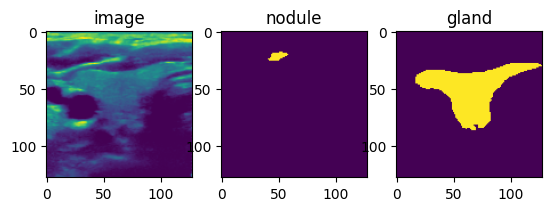

 43%|████▎     | 861/1992 [31:36<10:16,  1.83it/s]

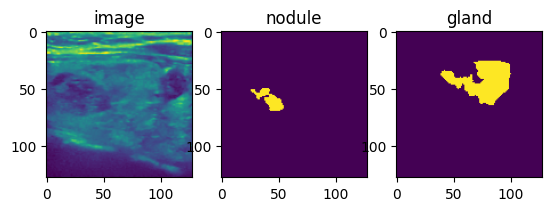

 43%|████▎     | 866/1992 [31:39<10:42,  1.75it/s]

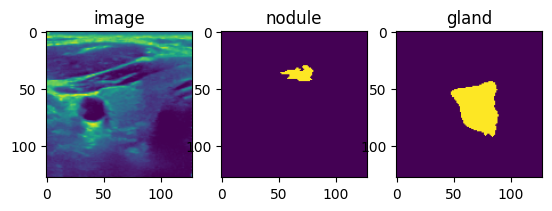

 44%|████▎     | 871/1992 [31:40<06:58,  2.68it/s]

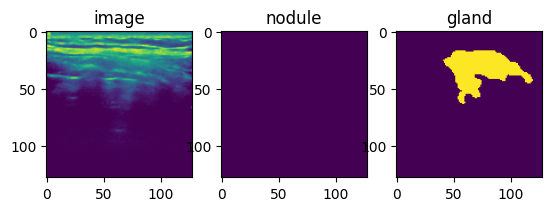

 44%|████▍     | 876/1992 [31:41<03:16,  5.68it/s]

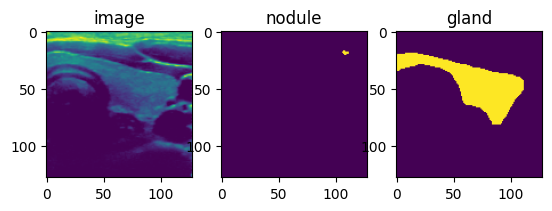

 44%|████▍     | 881/1992 [31:44<08:50,  2.09it/s]

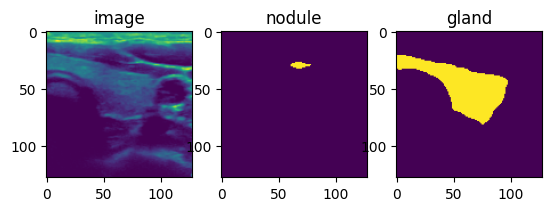

 44%|████▍     | 886/1992 [31:46<07:35,  2.43it/s]

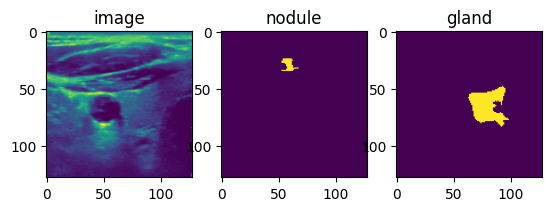

 45%|████▍     | 891/1992 [31:49<10:34,  1.73it/s]

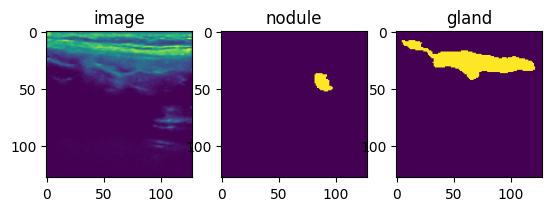

 45%|████▍     | 896/1992 [31:51<09:24,  1.94it/s]

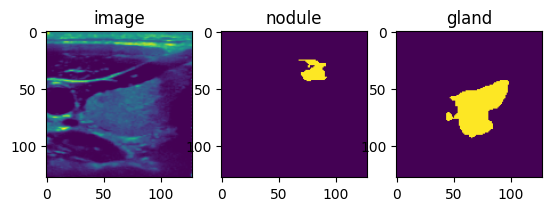

 45%|████▌     | 901/1992 [31:52<06:35,  2.76it/s]

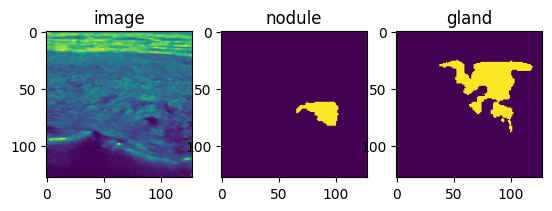

 45%|████▌     | 906/1992 [31:54<04:41,  3.86it/s]

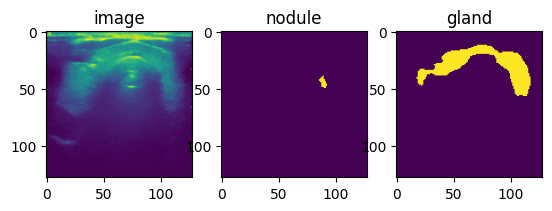

 46%|████▌     | 911/1992 [31:55<04:36,  3.91it/s]

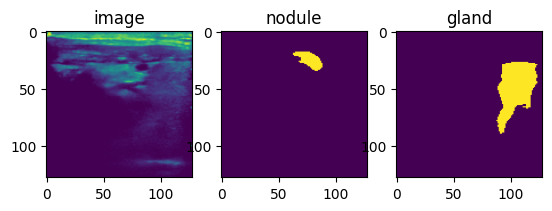

 46%|████▌     | 915/1992 [31:56<02:54,  6.16it/s]

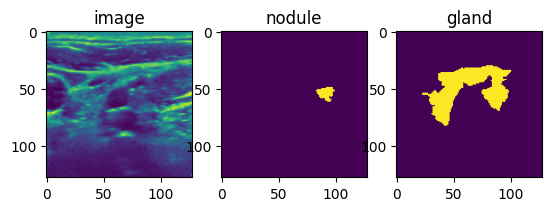

 46%|████▌     | 920/1992 [31:57<04:16,  4.17it/s]

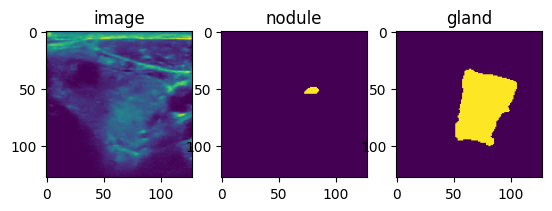

 46%|████▋     | 926/1992 [31:58<05:00,  3.54it/s]

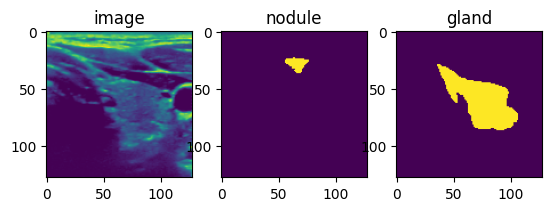

 47%|████▋     | 931/1992 [31:59<03:29,  5.07it/s]

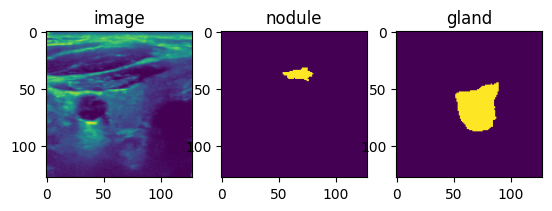

 47%|████▋     | 935/1992 [32:01<06:54,  2.55it/s]

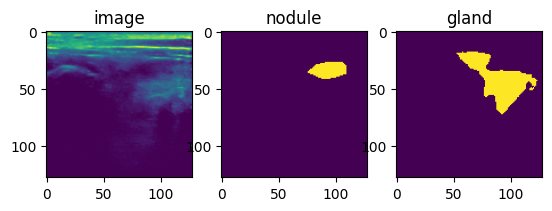

 47%|████▋     | 940/1992 [32:02<03:32,  4.94it/s]

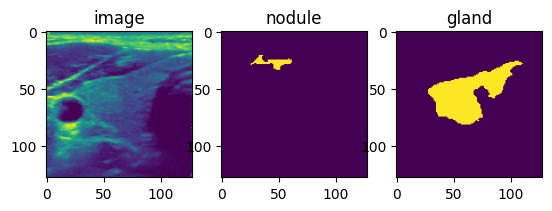

 47%|████▋     | 946/1992 [32:04<03:34,  4.88it/s]

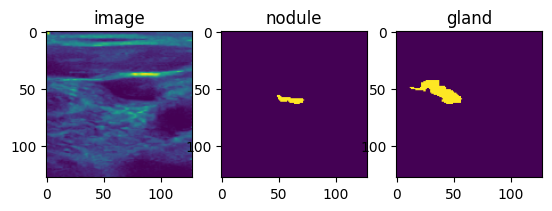

 48%|████▊     | 951/1992 [32:05<04:19,  4.02it/s]

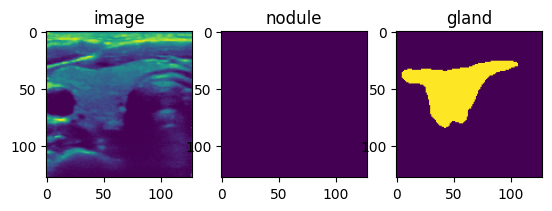

 48%|████▊     | 956/1992 [32:07<05:21,  3.22it/s]

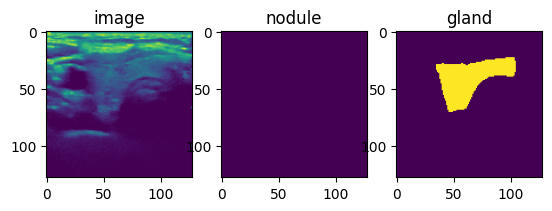

 48%|████▊     | 961/1992 [32:09<04:51,  3.53it/s]

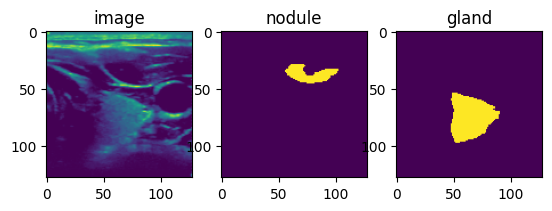

 48%|████▊     | 965/1992 [32:10<04:43,  3.63it/s]

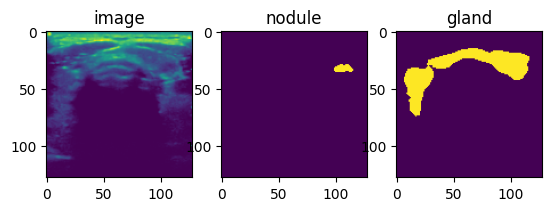

 49%|████▊     | 971/1992 [32:18<19:42,  1.16s/it]

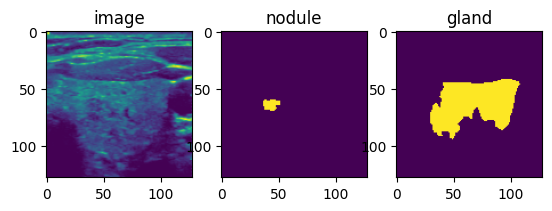

 49%|████▉     | 976/1992 [32:20<09:19,  1.81it/s]

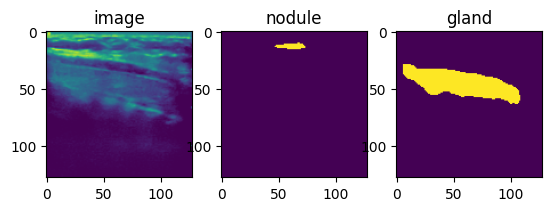

 49%|████▉     | 981/1992 [32:22<05:45,  2.92it/s]

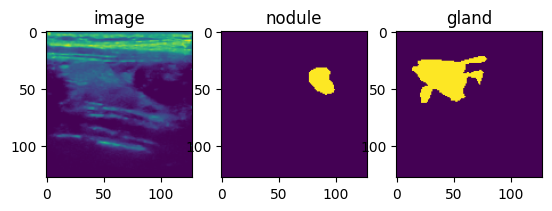

 49%|████▉     | 985/1992 [32:26<09:53,  1.70it/s]

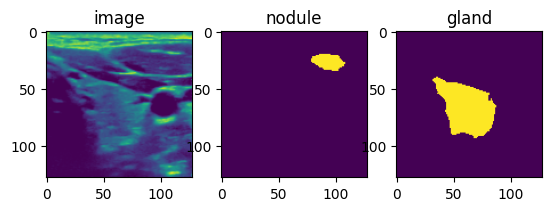

 50%|████▉     | 990/1992 [32:28<08:05,  2.06it/s]

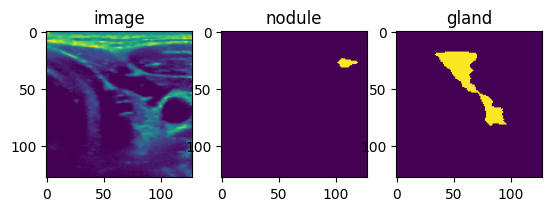

 50%|█████     | 996/1992 [32:29<04:32,  3.66it/s]

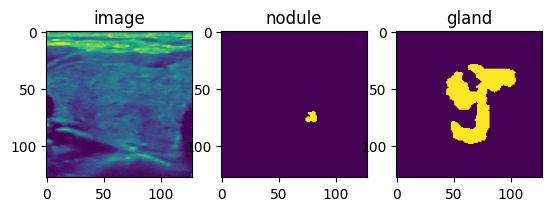

 50%|█████     | 1000/1992 [32:30<04:07,  4.00it/s]

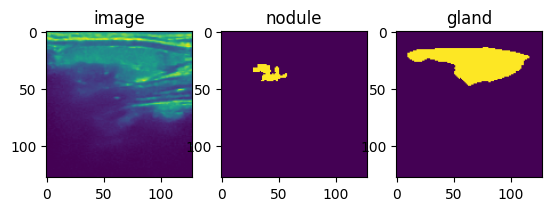

 50%|█████     | 1005/1992 [32:30<02:44,  5.99it/s]

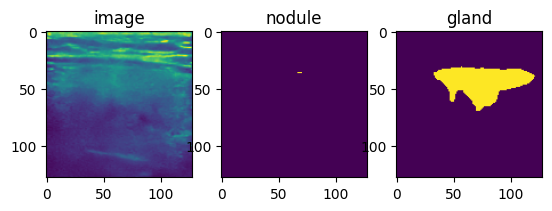

 51%|█████     | 1011/1992 [32:32<03:37,  4.50it/s]

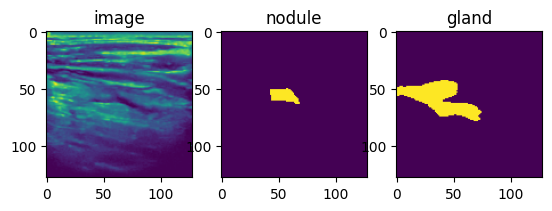

 51%|█████     | 1016/1992 [32:35<07:07,  2.28it/s]

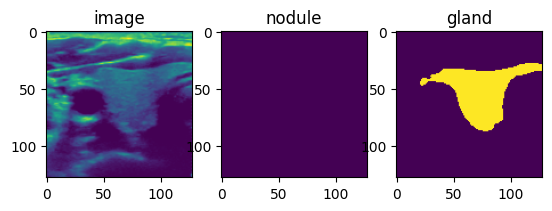

 51%|█████▏    | 1021/1992 [32:37<06:14,  2.60it/s]

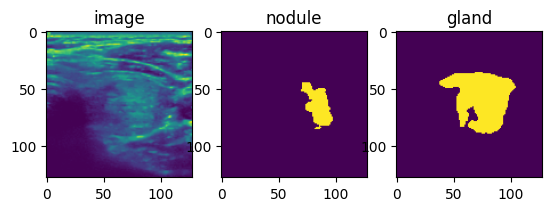

 52%|█████▏    | 1026/1992 [32:38<03:36,  4.47it/s]

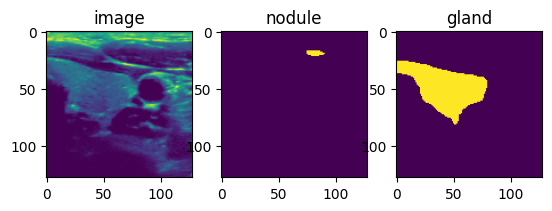

 52%|█████▏    | 1031/1992 [32:42<10:40,  1.50it/s]

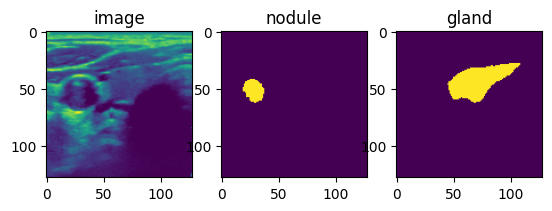

 52%|█████▏    | 1035/1992 [32:42<04:47,  3.32it/s]

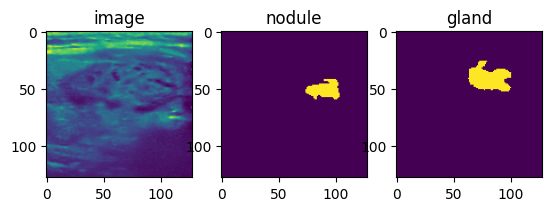

 52%|█████▏    | 1041/1992 [32:46<09:38,  1.64it/s]

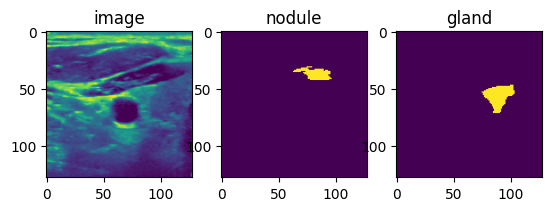

 53%|█████▎    | 1046/1992 [32:48<06:08,  2.57it/s]

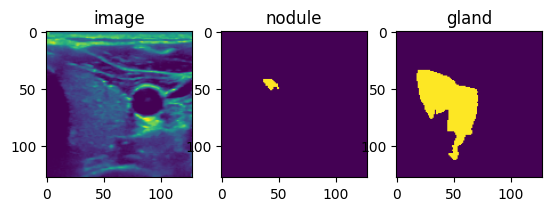

 53%|█████▎    | 1051/1992 [32:50<07:19,  2.14it/s]

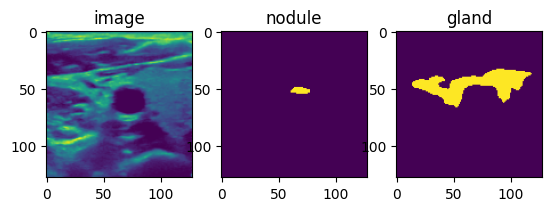

 53%|█████▎    | 1055/1992 [32:52<05:35,  2.80it/s]

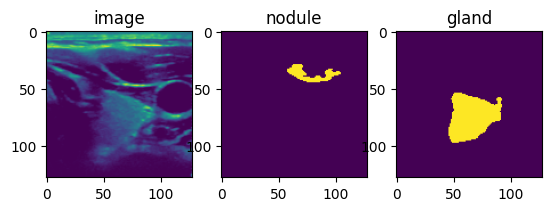

 53%|█████▎    | 1061/1992 [32:55<06:13,  2.49it/s]

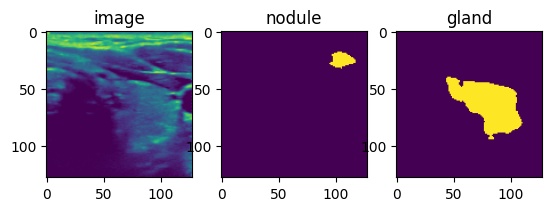

 53%|█████▎    | 1065/1992 [32:59<10:25,  1.48it/s]

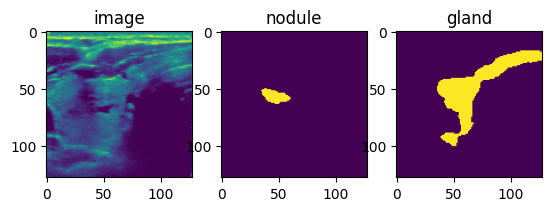

 54%|█████▍    | 1071/1992 [33:01<06:24,  2.39it/s]

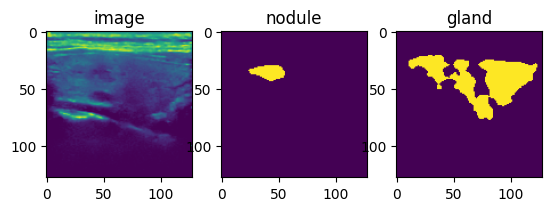

 54%|█████▍    | 1076/1992 [33:02<05:49,  2.62it/s]

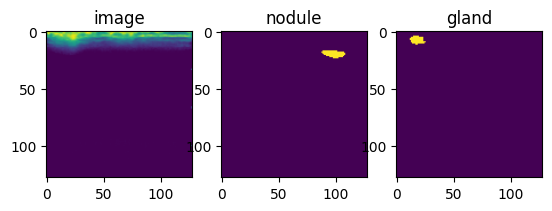

 54%|█████▍    | 1081/1992 [33:06<11:51,  1.28it/s]

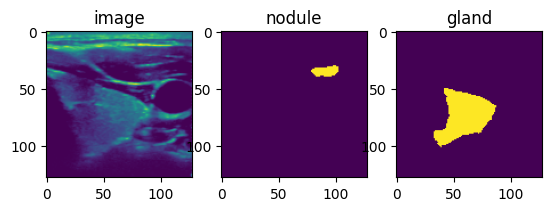

 55%|█████▍    | 1086/1992 [33:08<07:47,  1.94it/s]

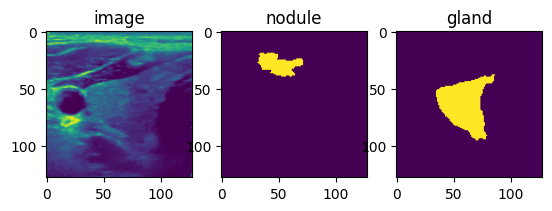

 55%|█████▍    | 1090/1992 [33:11<08:51,  1.70it/s]

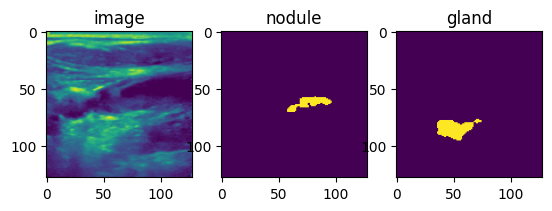

 55%|█████▌    | 1096/1992 [33:13<08:15,  1.81it/s]

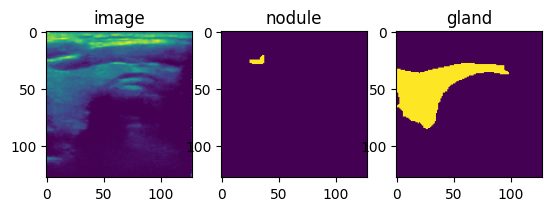

 55%|█████▌    | 1100/1992 [33:15<05:59,  2.48it/s]

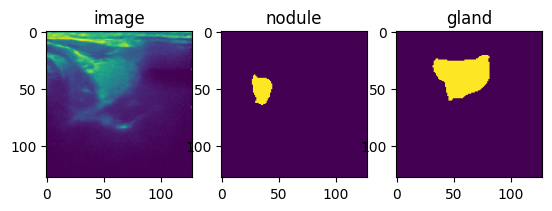

 56%|█████▌    | 1106/1992 [33:19<08:18,  1.78it/s]

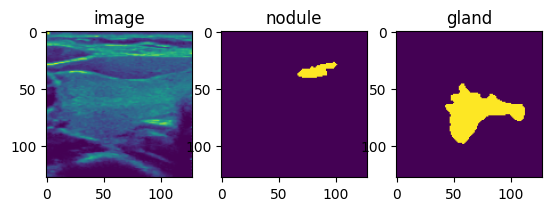

 56%|█████▌    | 1111/1992 [33:20<03:35,  4.09it/s]

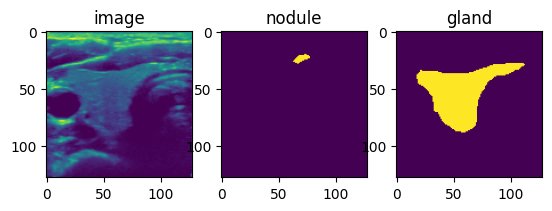

 56%|█████▌    | 1116/1992 [33:21<02:23,  6.10it/s]

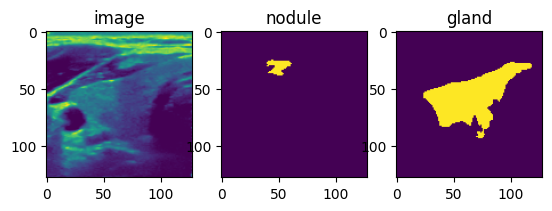

 56%|█████▋    | 1121/1992 [33:23<05:41,  2.55it/s]

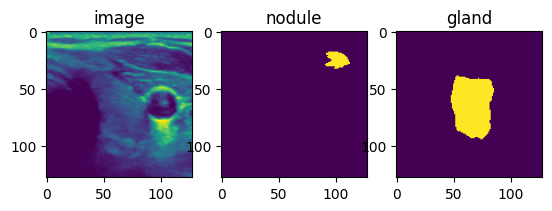

 56%|█████▋    | 1125/1992 [33:24<04:21,  3.31it/s]

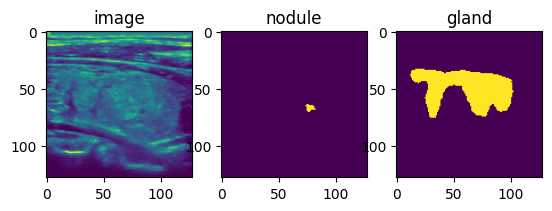

 57%|█████▋    | 1131/1992 [33:25<03:05,  4.65it/s]

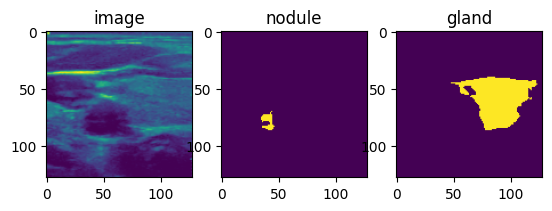

 57%|█████▋    | 1136/1992 [33:29<07:10,  1.99it/s]

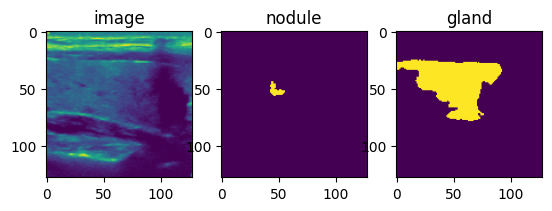

 57%|█████▋    | 1141/1992 [33:30<03:25,  4.14it/s]

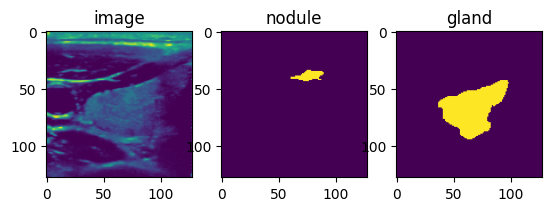

 57%|█████▋    | 1145/1992 [33:32<06:03,  2.33it/s]

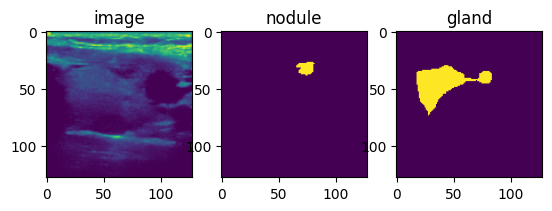

 58%|█████▊    | 1151/1992 [33:34<04:22,  3.20it/s]

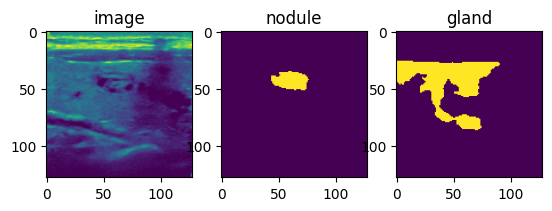

 58%|█████▊    | 1156/1992 [33:39<14:09,  1.02s/it]

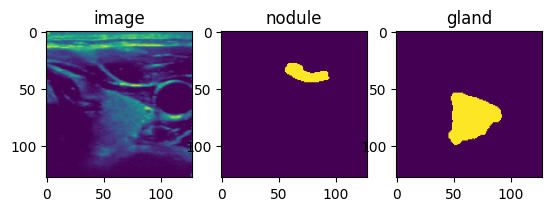

 58%|█████▊    | 1160/1992 [33:39<05:47,  2.40it/s]

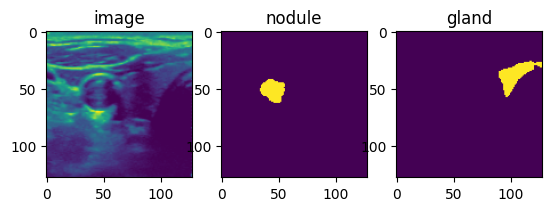

 59%|█████▊    | 1166/1992 [33:40<03:18,  4.17it/s]

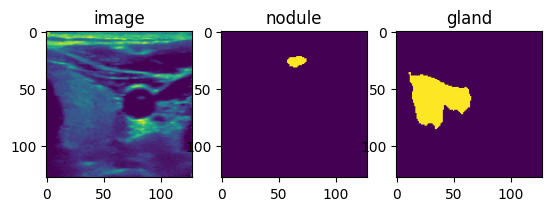

 59%|█████▉    | 1171/1992 [33:43<06:10,  2.22it/s]

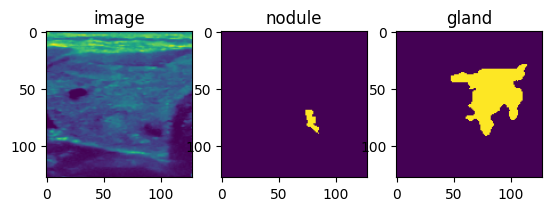

 59%|█████▉    | 1176/1992 [33:45<05:50,  2.33it/s]

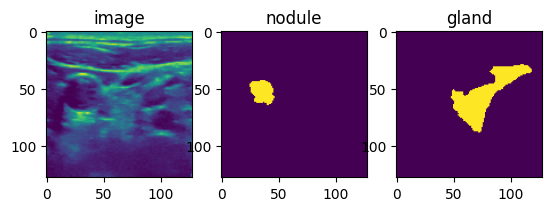

 59%|█████▉    | 1180/1992 [33:46<04:27,  3.04it/s]

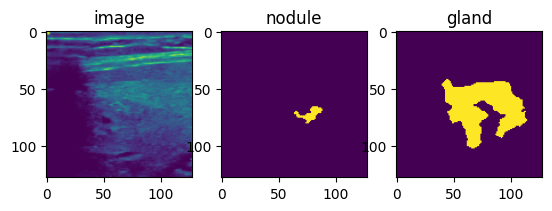

 60%|█████▉    | 1186/1992 [33:47<03:32,  3.80it/s]

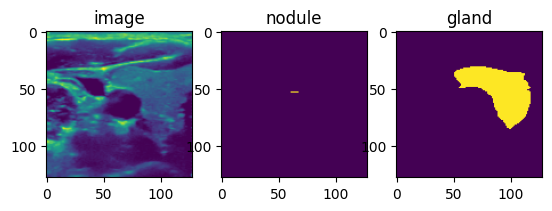

 60%|█████▉    | 1191/1992 [33:49<03:43,  3.59it/s]

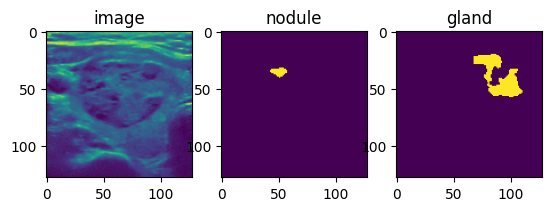

 60%|██████    | 1196/1992 [33:51<05:58,  2.22it/s]

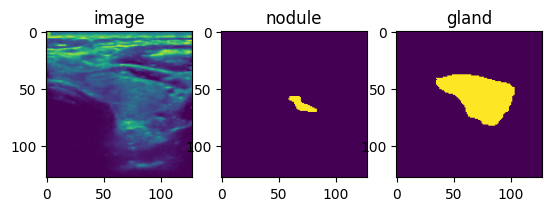

 60%|██████    | 1200/1992 [33:52<03:48,  3.46it/s]

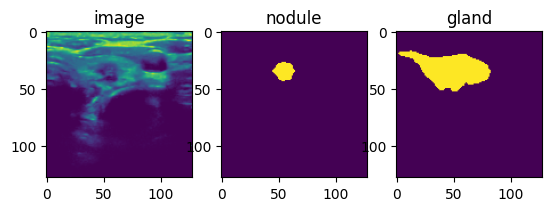

 61%|██████    | 1206/1992 [33:56<09:45,  1.34it/s]

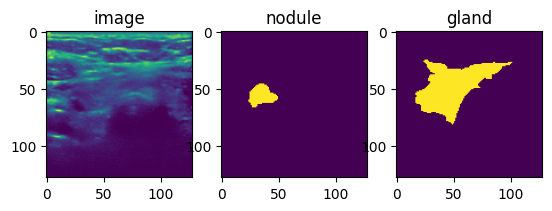

 61%|██████    | 1211/1992 [33:58<06:41,  1.95it/s]

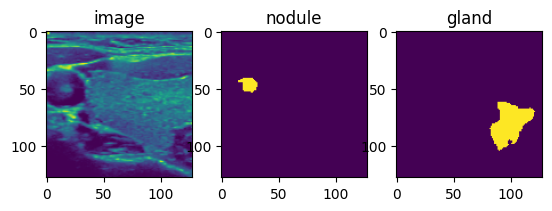

 61%|██████    | 1216/1992 [34:00<05:39,  2.28it/s]

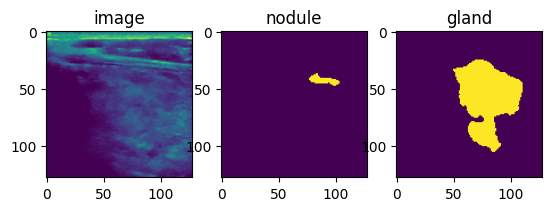

 61%|██████▏   | 1221/1992 [34:02<04:13,  3.04it/s]

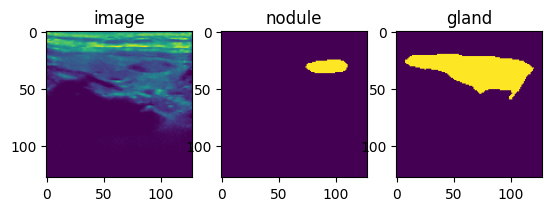

 62%|██████▏   | 1226/1992 [34:04<05:18,  2.41it/s]

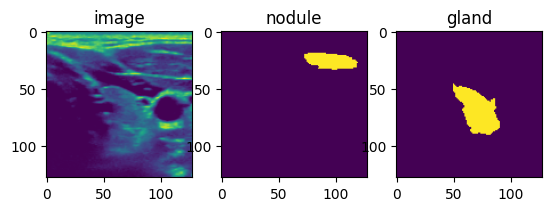

 62%|██████▏   | 1231/1992 [34:05<02:24,  5.27it/s]

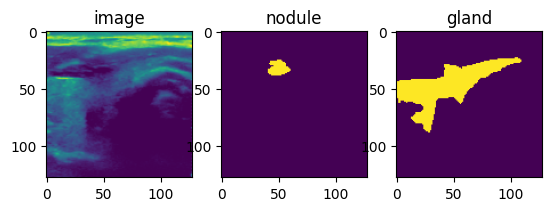

 62%|██████▏   | 1236/1992 [34:06<02:12,  5.71it/s]

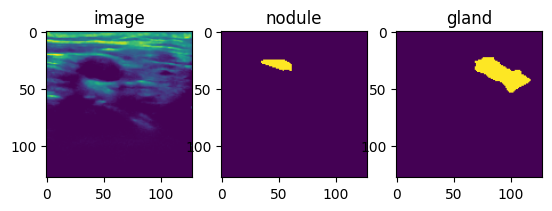

 62%|██████▏   | 1240/1992 [34:09<06:25,  1.95it/s]

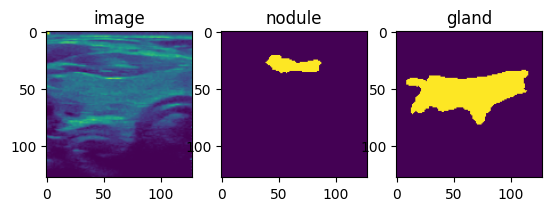

 63%|██████▎   | 1246/1992 [34:11<05:09,  2.41it/s]

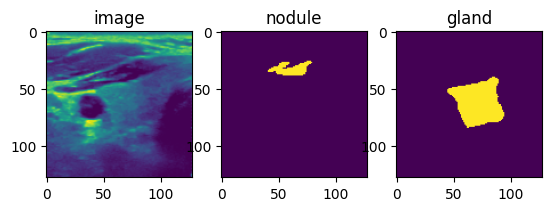

 63%|██████▎   | 1251/1992 [34:13<03:52,  3.19it/s]

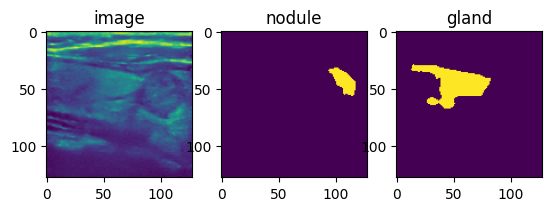

 63%|██████▎   | 1255/1992 [34:14<03:53,  3.16it/s]

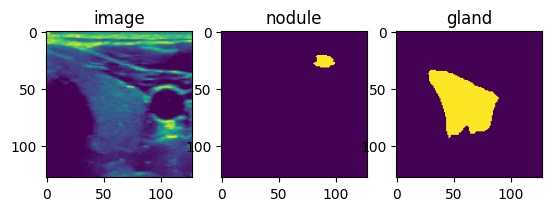

 63%|██████▎   | 1261/1992 [34:16<03:01,  4.03it/s]

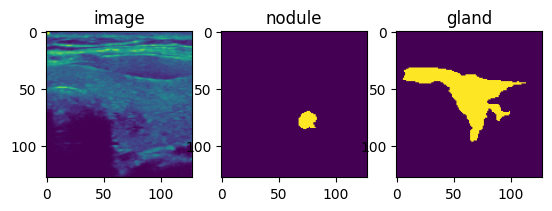

 64%|██████▎   | 1266/1992 [34:18<03:11,  3.79it/s]

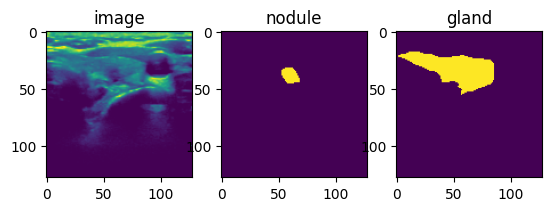

 64%|██████▍   | 1271/1992 [34:22<09:11,  1.31it/s]

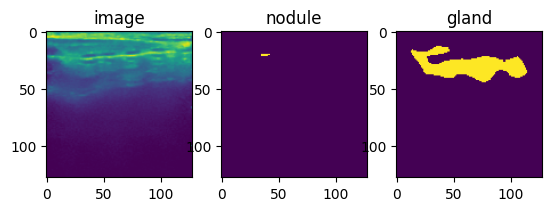

 64%|██████▍   | 1276/1992 [34:24<06:07,  1.95it/s]

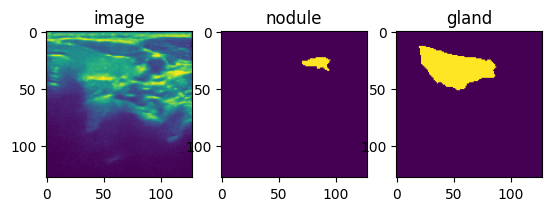

 64%|██████▍   | 1280/1992 [34:26<05:31,  2.15it/s]

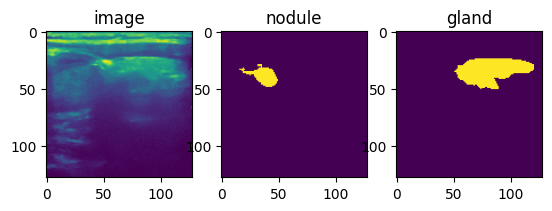

 65%|██████▍   | 1286/1992 [34:28<04:21,  2.70it/s]

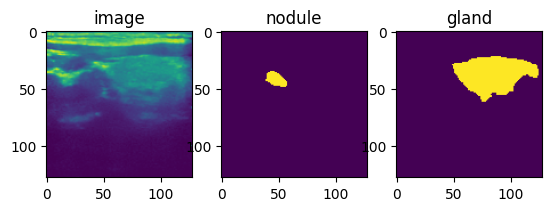

 65%|██████▍   | 1291/1992 [34:30<03:56,  2.97it/s]

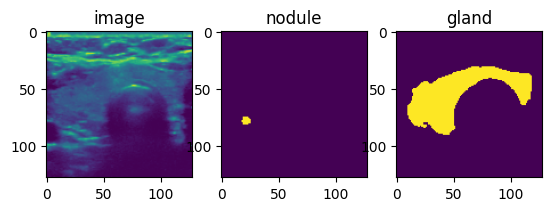

 65%|██████▌   | 1296/1992 [34:32<06:12,  1.87it/s]

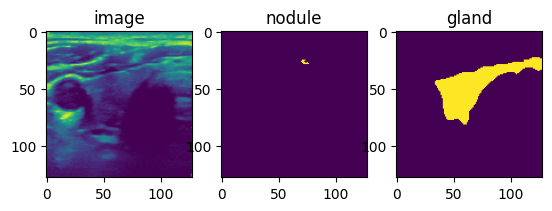

 65%|██████▌   | 1301/1992 [34:35<06:13,  1.85it/s]

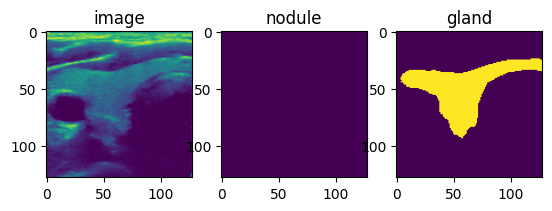

 66%|██████▌   | 1305/1992 [34:37<03:40,  3.11it/s]

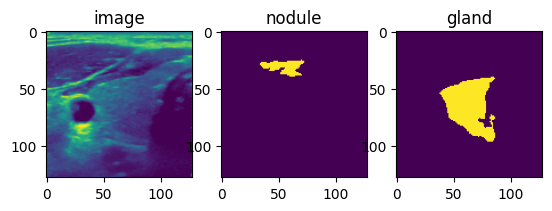

 66%|██████▌   | 1310/1992 [34:38<03:18,  3.44it/s]

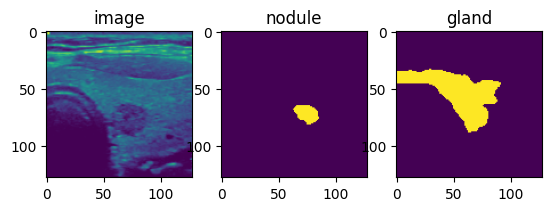

 66%|██████▌   | 1316/1992 [34:39<02:23,  4.72it/s]

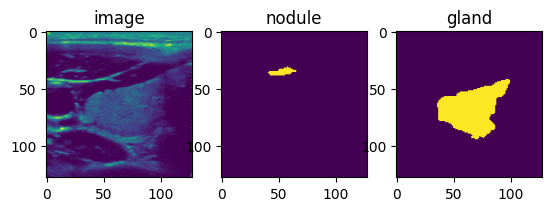

 66%|██████▋   | 1321/1992 [34:41<03:01,  3.69it/s]

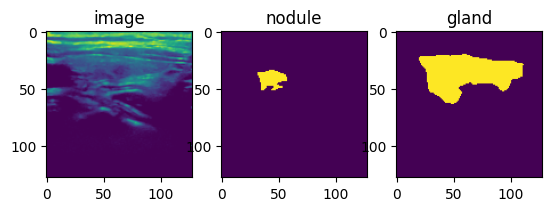

 67%|██████▋   | 1326/1992 [34:44<06:03,  1.83it/s]

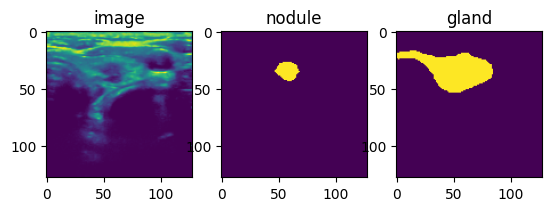

 67%|██████▋   | 1331/1992 [34:45<02:41,  4.09it/s]

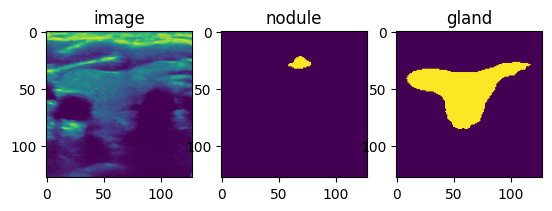

 67%|██████▋   | 1336/1992 [34:47<03:28,  3.15it/s]

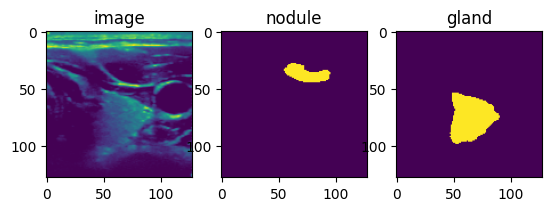

 67%|██████▋   | 1341/1992 [34:49<04:29,  2.41it/s]

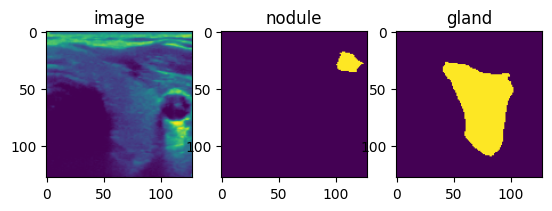

 68%|██████▊   | 1346/1992 [34:52<05:11,  2.07it/s]

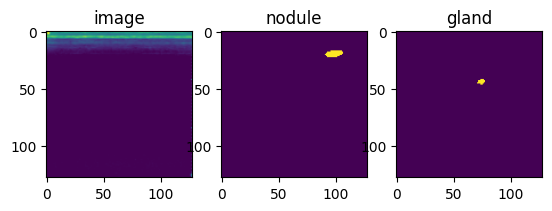

 68%|██████▊   | 1350/1992 [34:53<02:52,  3.71it/s]

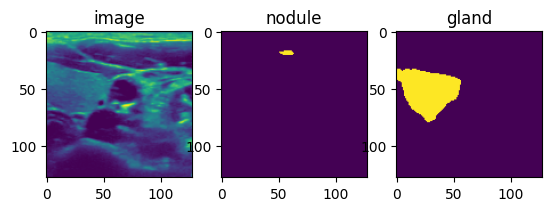

 68%|██████▊   | 1356/1992 [34:54<03:42,  2.86it/s]

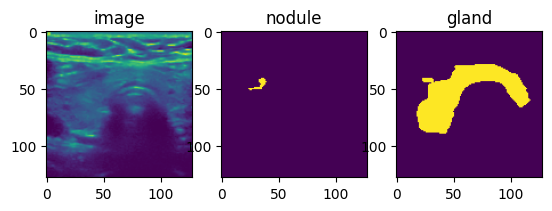

 68%|██████▊   | 1360/1992 [34:56<03:57,  2.66it/s]

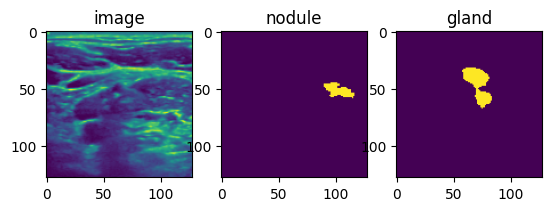

 69%|██████▊   | 1366/1992 [35:00<08:53,  1.17it/s]

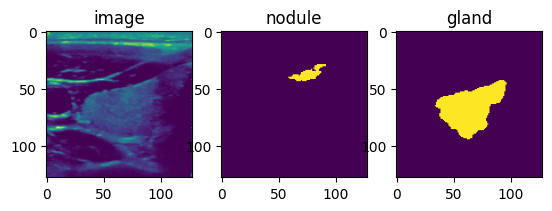

 69%|██████▉   | 1371/1992 [35:01<04:54,  2.11it/s]

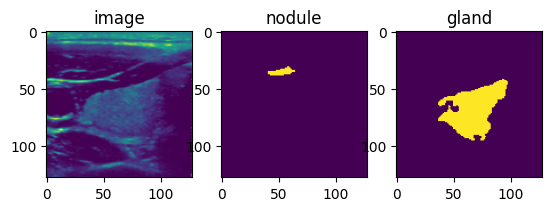

 69%|██████▉   | 1376/1992 [35:03<02:53,  3.55it/s]

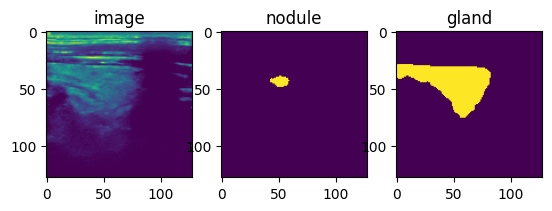

 69%|██████▉   | 1380/1992 [35:04<02:51,  3.58it/s]

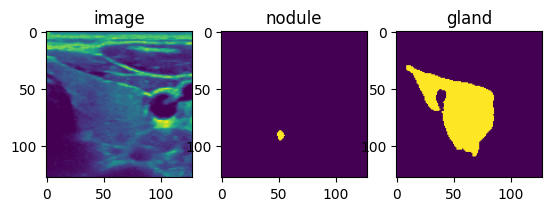

 70%|██████▉   | 1386/1992 [35:06<03:12,  3.15it/s]

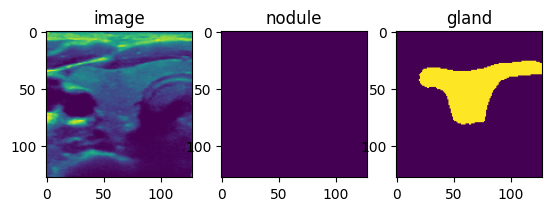

 70%|██████▉   | 1391/1992 [35:09<06:01,  1.66it/s]

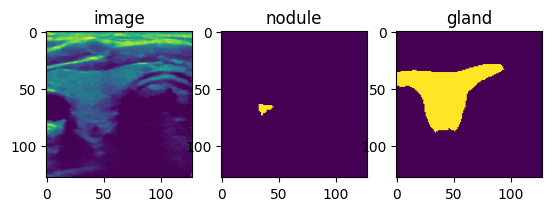

 70%|███████   | 1396/1992 [35:09<02:15,  4.40it/s]

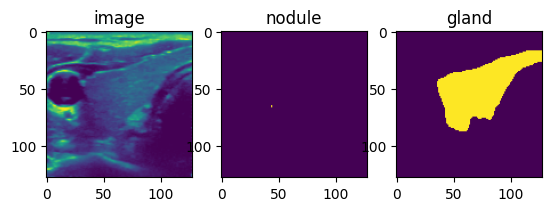

 70%|███████   | 1401/1992 [35:11<03:50,  2.56it/s]

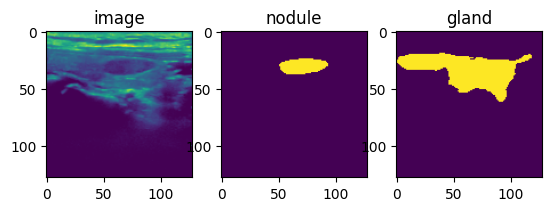

 71%|███████   | 1406/1992 [35:12<01:51,  5.27it/s]

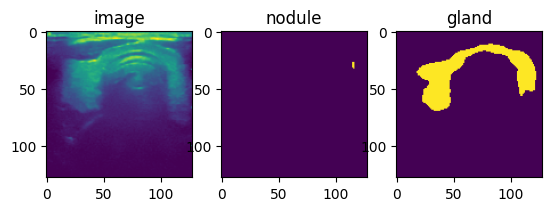

 71%|███████   | 1411/1992 [35:14<03:15,  2.97it/s]

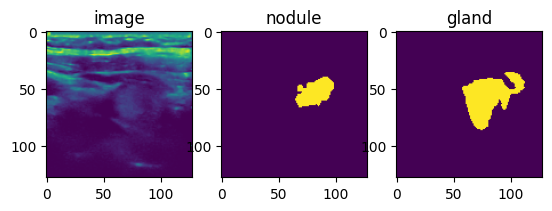

 71%|███████   | 1415/1992 [35:16<03:59,  2.41it/s]

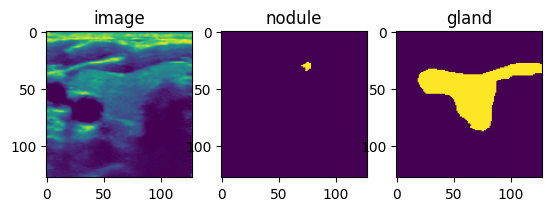

 71%|███████▏  | 1421/1992 [35:19<05:02,  1.89it/s]

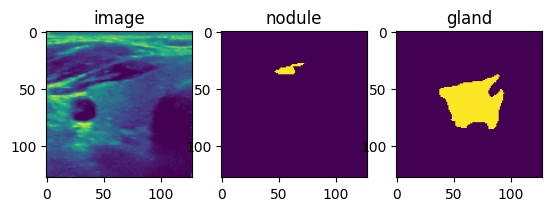

 72%|███████▏  | 1426/1992 [35:20<02:01,  4.67it/s]

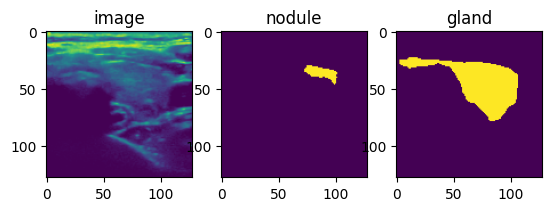

 72%|███████▏  | 1431/1992 [35:22<04:37,  2.02it/s]

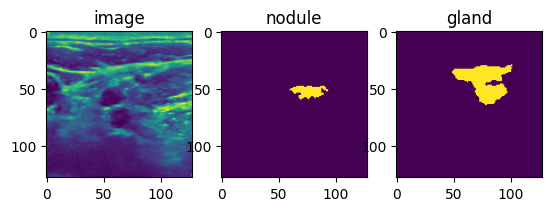

 72%|███████▏  | 1435/1992 [35:23<03:20,  2.77it/s]

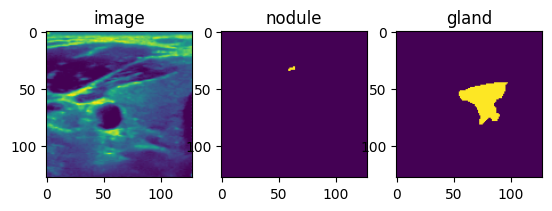

 72%|███████▏  | 1441/1992 [35:24<02:05,  4.39it/s]

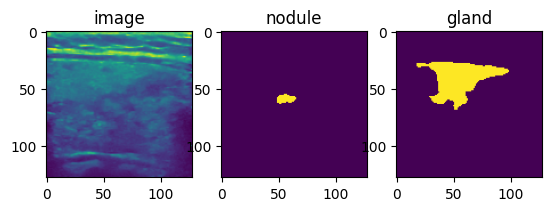

 73%|███████▎  | 1446/1992 [35:26<04:05,  2.23it/s]

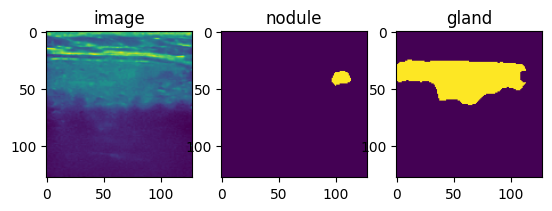

 73%|███████▎  | 1450/1992 [35:28<04:02,  2.24it/s]

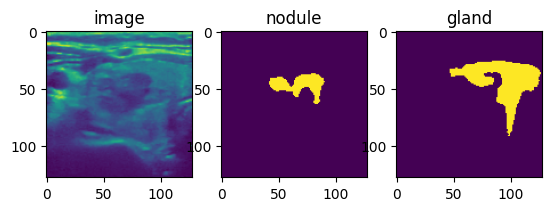

 73%|███████▎  | 1456/1992 [35:29<02:16,  3.92it/s]

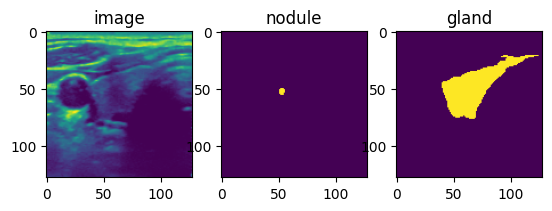

 73%|███████▎  | 1461/1992 [35:31<03:44,  2.37it/s]

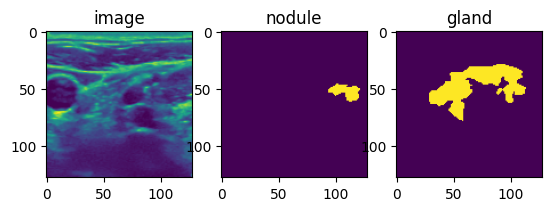

 74%|███████▎  | 1465/1992 [35:32<02:03,  4.27it/s]

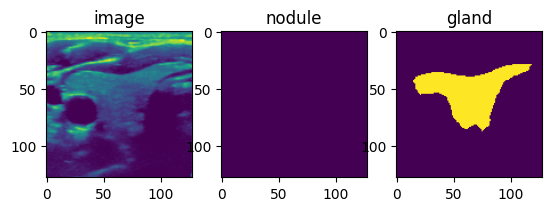

 74%|███████▍  | 1471/1992 [35:36<04:10,  2.08it/s]

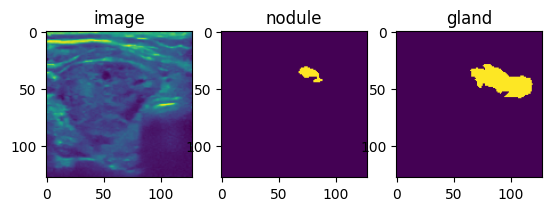

 74%|███████▍  | 1476/1992 [35:38<04:02,  2.13it/s]

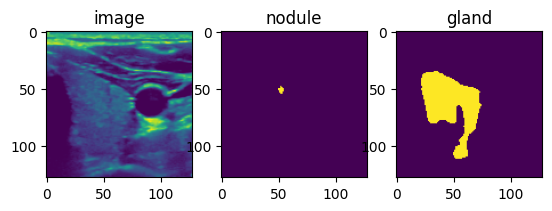

 74%|███████▍  | 1481/1992 [35:39<03:07,  2.73it/s]

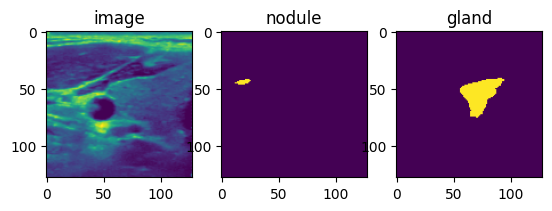

 75%|███████▍  | 1486/1992 [35:42<02:30,  3.35it/s]

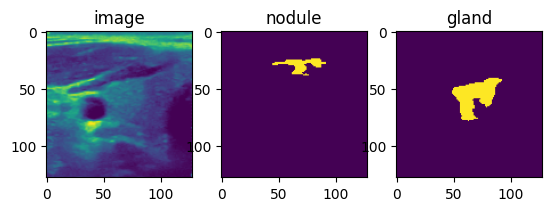

 75%|███████▍  | 1491/1992 [35:43<01:42,  4.88it/s]

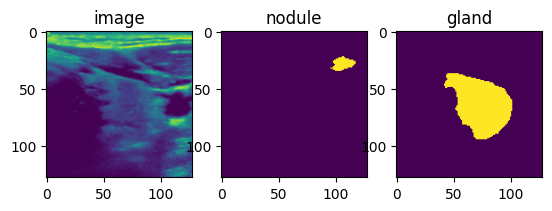

 75%|███████▌  | 1496/1992 [35:44<02:36,  3.16it/s]

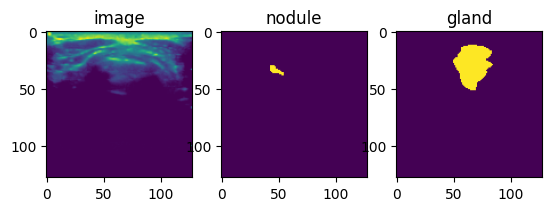

 75%|███████▌  | 1501/1992 [35:45<01:52,  4.36it/s]

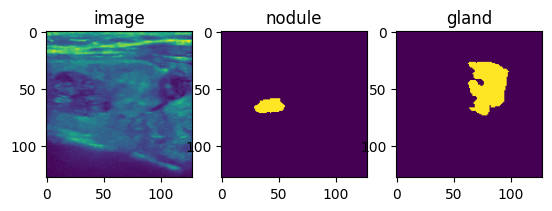

 76%|███████▌  | 1506/1992 [35:46<01:51,  4.35it/s]

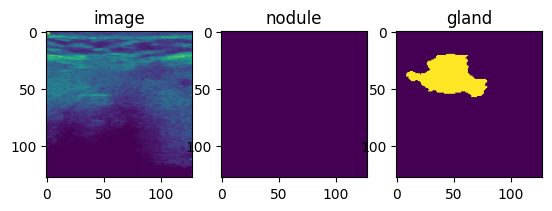

 76%|███████▌  | 1511/1992 [35:48<01:39,  4.84it/s]

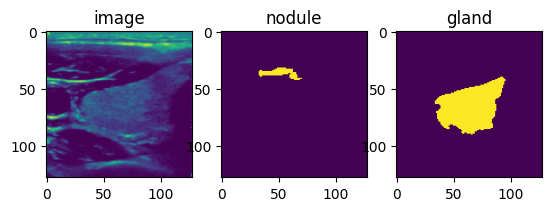

 76%|███████▌  | 1516/1992 [35:50<04:43,  1.68it/s]

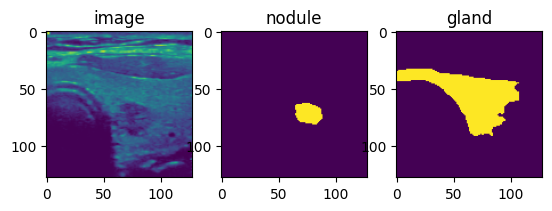

 76%|███████▋  | 1521/1992 [35:54<04:49,  1.63it/s]

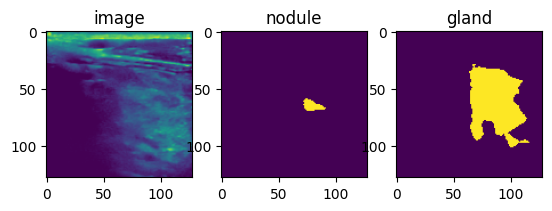

 77%|███████▋  | 1525/1992 [35:55<02:55,  2.66it/s]

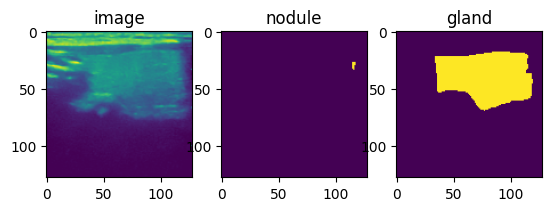

 77%|███████▋  | 1531/1992 [35:57<02:56,  2.61it/s]

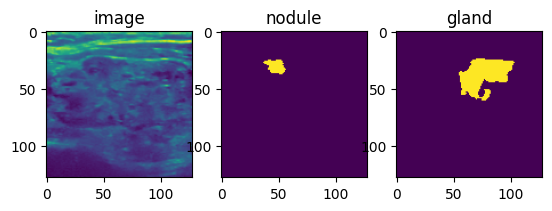

 77%|███████▋  | 1535/1992 [35:59<02:46,  2.74it/s]

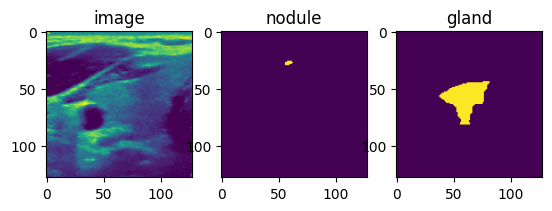

 77%|███████▋  | 1540/1992 [36:00<02:21,  3.20it/s]

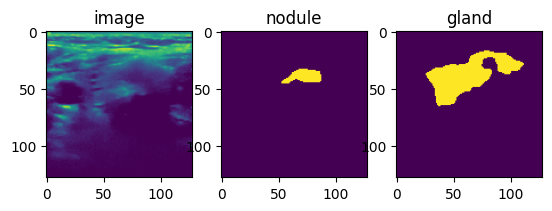

 78%|███████▊  | 1545/1992 [36:01<02:08,  3.47it/s]

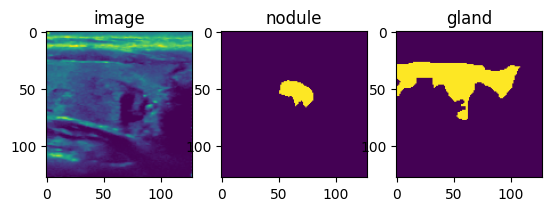

 78%|███████▊  | 1550/1992 [36:02<01:36,  4.56it/s]

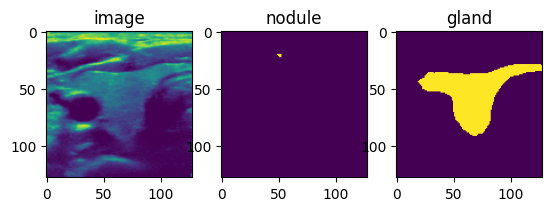

 78%|███████▊  | 1556/1992 [36:06<04:14,  1.72it/s]

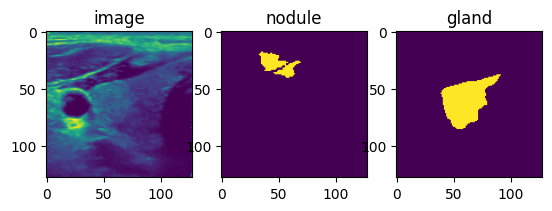

 78%|███████▊  | 1561/1992 [36:07<02:14,  3.21it/s]

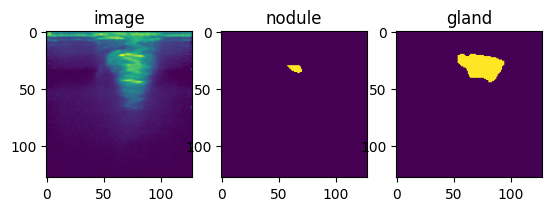

 79%|███████▊  | 1566/1992 [36:09<02:21,  3.01it/s]

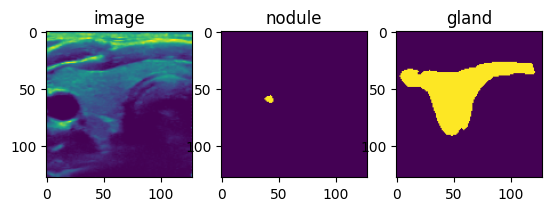

 79%|███████▉  | 1570/1992 [36:10<02:02,  3.45it/s]

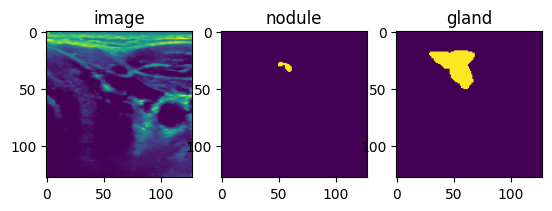

 79%|███████▉  | 1575/1992 [36:13<03:08,  2.21it/s]

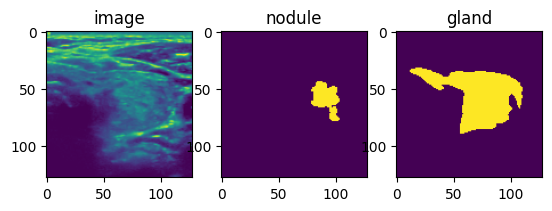

 79%|███████▉  | 1581/1992 [36:18<05:28,  1.25it/s]

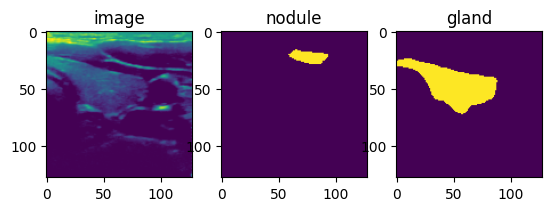

 80%|███████▉  | 1585/1992 [36:19<02:38,  2.57it/s]

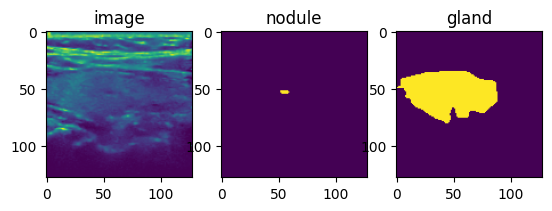

 80%|███████▉  | 1590/1992 [36:20<01:40,  3.98it/s]

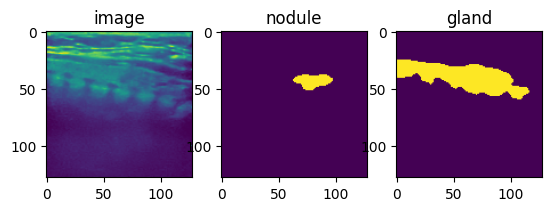

 80%|████████  | 1596/1992 [36:23<02:39,  2.48it/s]

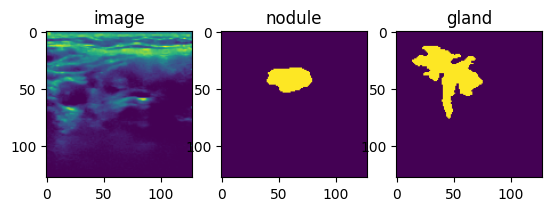

 80%|████████  | 1600/1992 [36:24<02:16,  2.88it/s]

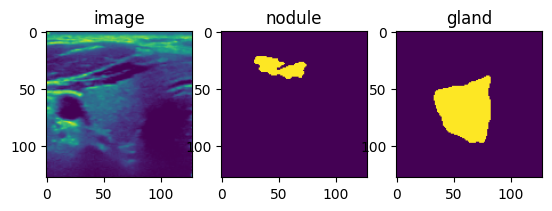

 81%|████████  | 1606/1992 [36:27<02:31,  2.55it/s]

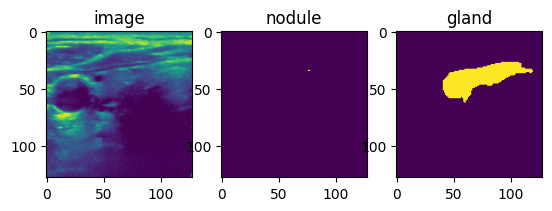

 81%|████████  | 1611/1992 [36:28<01:28,  4.30it/s]

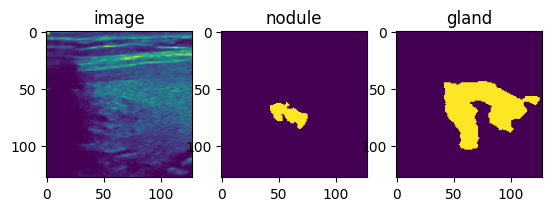

 81%|████████  | 1616/1992 [36:30<03:15,  1.93it/s]

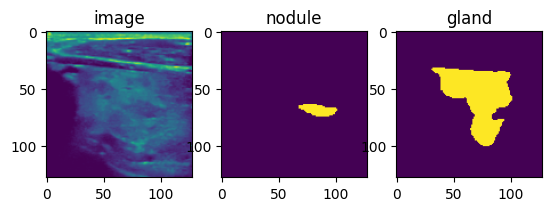

 81%|████████▏ | 1620/1992 [36:32<02:49,  2.20it/s]

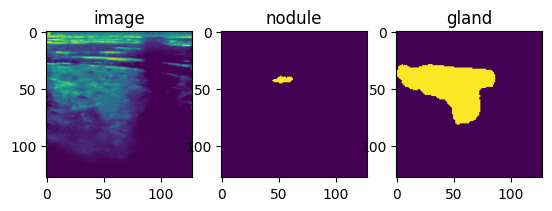

 82%|████████▏ | 1626/1992 [36:34<02:06,  2.89it/s]

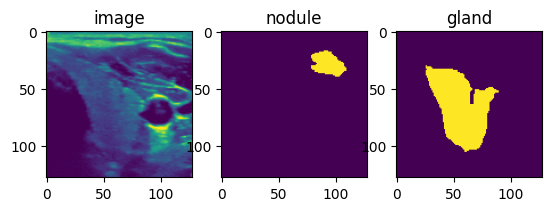

 82%|████████▏ | 1631/1992 [36:35<01:53,  3.19it/s]

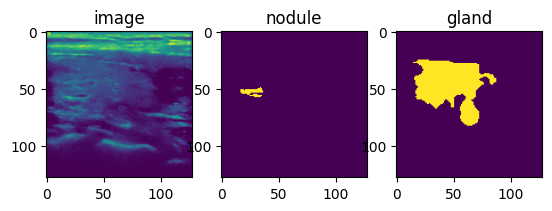

 82%|████████▏ | 1636/1992 [36:36<01:15,  4.70it/s]

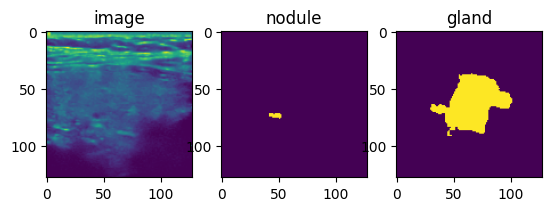

 82%|████████▏ | 1641/1992 [36:37<01:06,  5.29it/s]

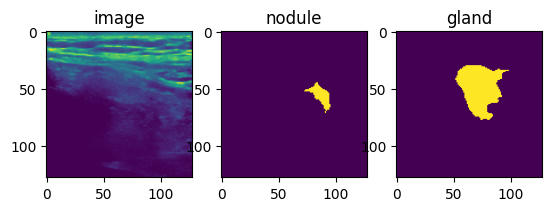

 83%|████████▎ | 1646/1992 [36:39<01:52,  3.07it/s]

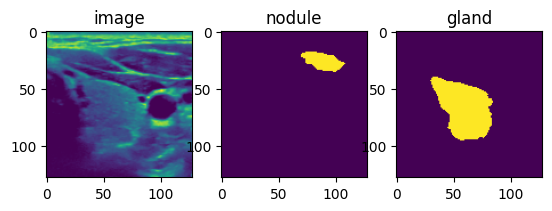

 83%|████████▎ | 1650/1992 [36:41<01:50,  3.09it/s]

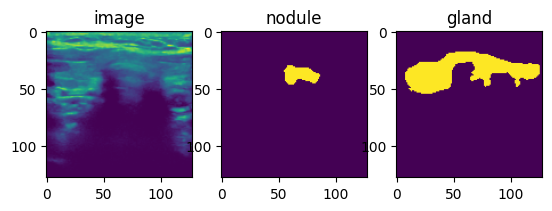

 83%|████████▎ | 1656/1992 [36:44<02:55,  1.91it/s]

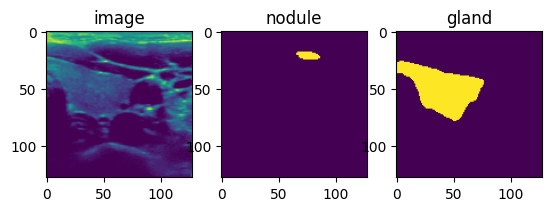

 83%|████████▎ | 1660/1992 [36:46<03:00,  1.84it/s]

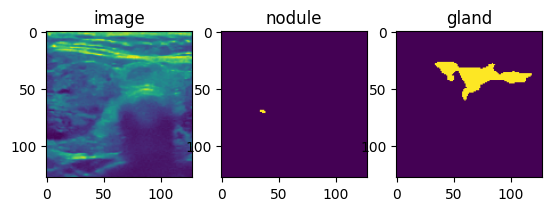

 84%|████████▎ | 1666/1992 [36:52<04:30,  1.21it/s]

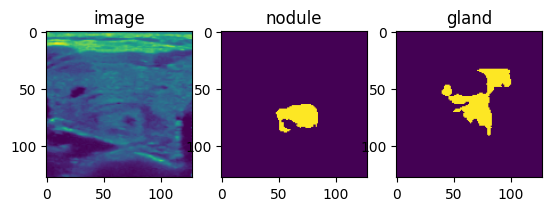

 84%|████████▍ | 1671/1992 [36:56<03:39,  1.47it/s]

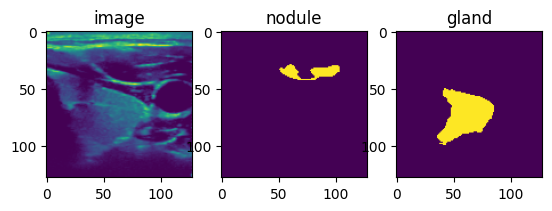

 84%|████████▍ | 1676/1992 [36:57<01:52,  2.82it/s]

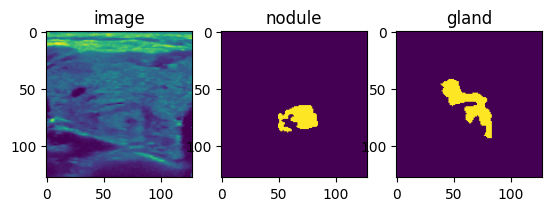

 84%|████████▍ | 1681/1992 [36:59<01:53,  2.75it/s]

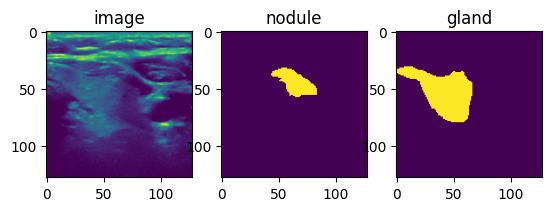

 85%|████████▍ | 1686/1992 [37:02<03:12,  1.59it/s]

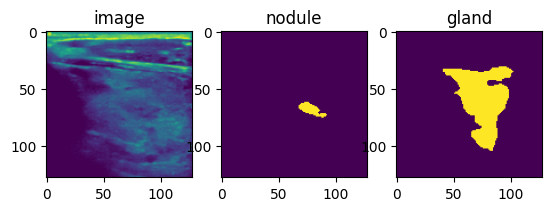

 85%|████████▍ | 1691/1992 [37:04<02:25,  2.07it/s]

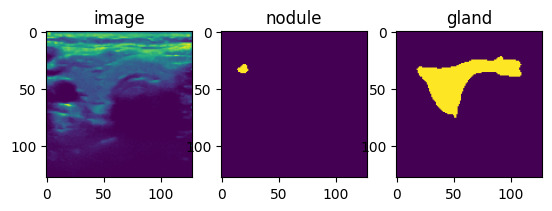

 85%|████████▌ | 1695/1992 [37:05<01:44,  2.84it/s]

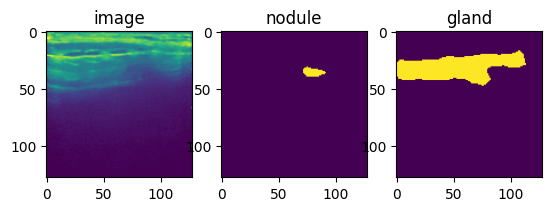

 85%|████████▌ | 1701/1992 [37:07<01:26,  3.38it/s]

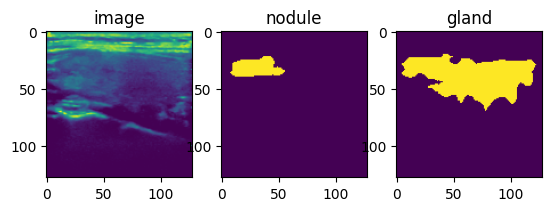

 86%|████████▌ | 1706/1992 [37:08<01:03,  4.51it/s]

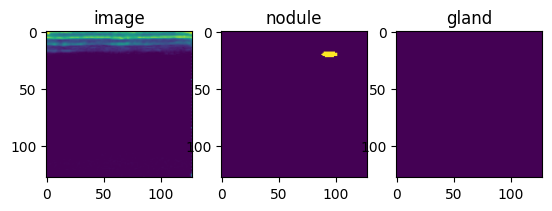

 86%|████████▌ | 1711/1992 [37:12<02:28,  1.89it/s]

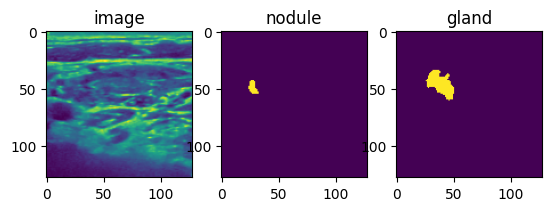

 86%|████████▌ | 1716/1992 [37:13<01:16,  3.63it/s]

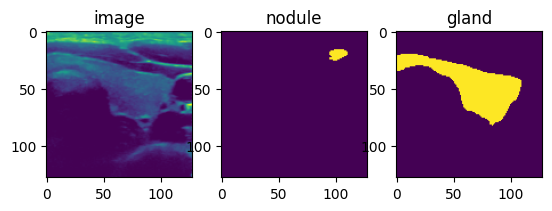

 86%|████████▋ | 1721/1992 [37:13<00:44,  6.14it/s]

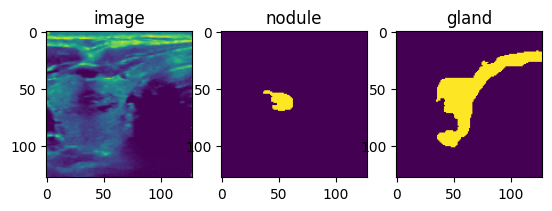

 87%|████████▋ | 1726/1992 [37:16<01:25,  3.11it/s]

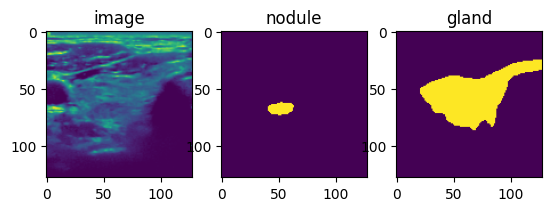

 87%|████████▋ | 1731/1992 [37:17<01:23,  3.14it/s]

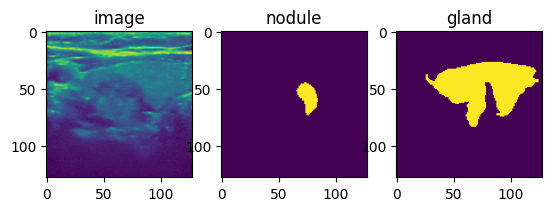

 87%|████████▋ | 1736/1992 [37:19<01:14,  3.46it/s]

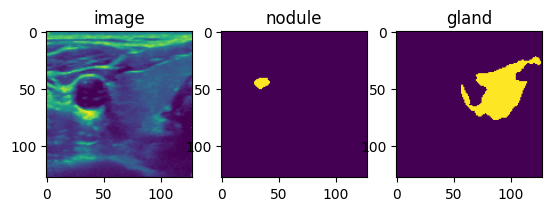

 87%|████████▋ | 1741/1992 [37:20<00:50,  5.01it/s]

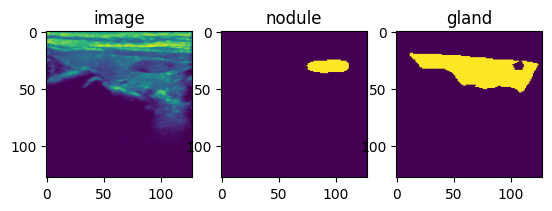

 88%|████████▊ | 1745/1992 [37:22<01:31,  2.71it/s]

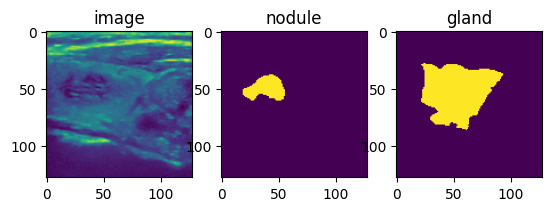

 88%|████████▊ | 1751/1992 [37:23<01:15,  3.19it/s]

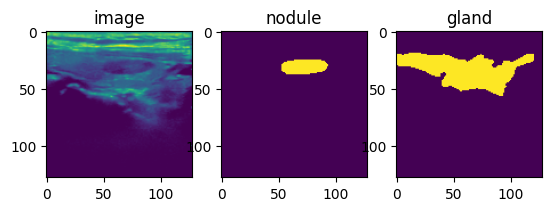

 88%|████████▊ | 1756/1992 [37:27<03:09,  1.24it/s]

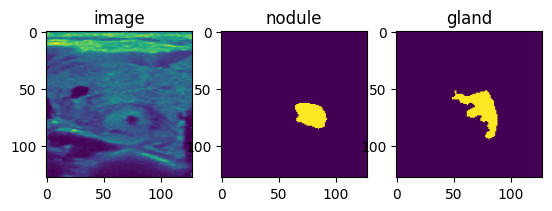

 88%|████████▊ | 1761/1992 [37:29<01:28,  2.62it/s]

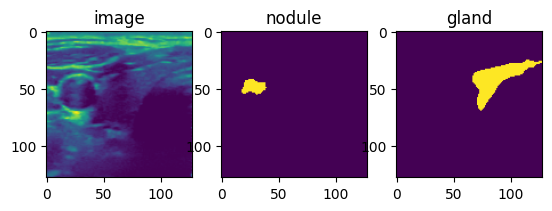

 89%|████████▊ | 1765/1992 [37:32<02:08,  1.77it/s]

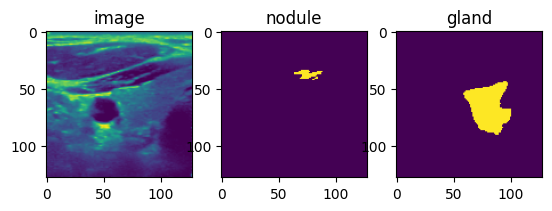

 89%|████████▉ | 1771/1992 [37:33<01:10,  3.15it/s]

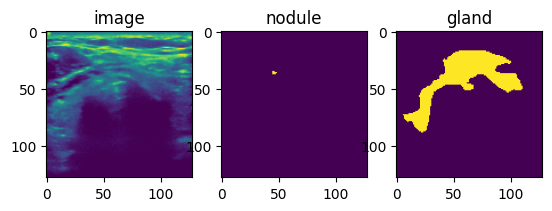

 89%|████████▉ | 1776/1992 [37:35<01:15,  2.87it/s]

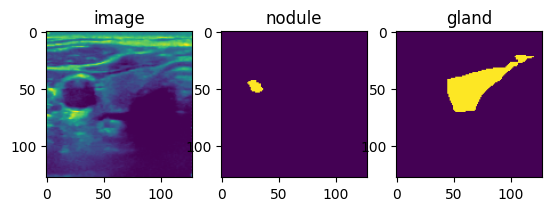

 89%|████████▉ | 1781/1992 [37:36<00:44,  4.70it/s]

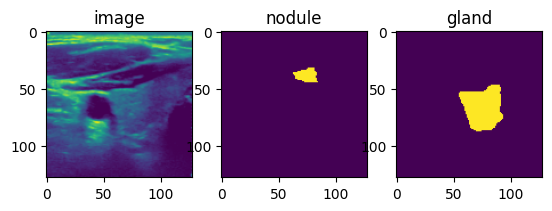

 90%|████████▉ | 1786/1992 [37:38<01:07,  3.04it/s]

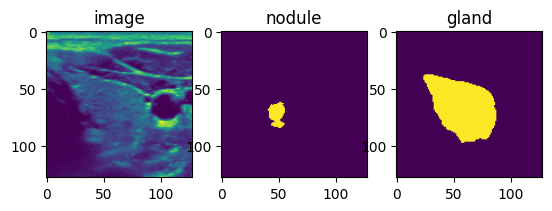

 90%|████████▉ | 1791/1992 [37:41<01:50,  1.81it/s]

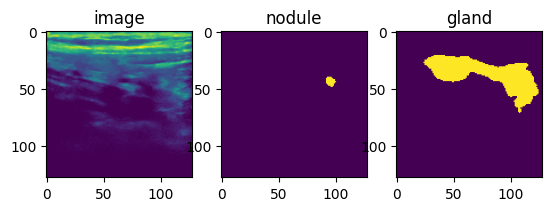

 90%|█████████ | 1796/1992 [37:42<01:04,  3.06it/s]

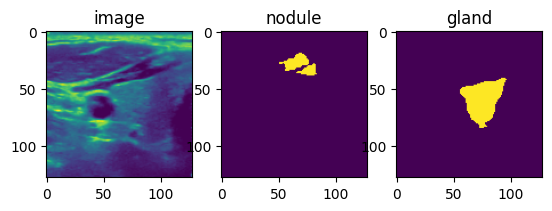

 90%|█████████ | 1800/1992 [37:45<01:59,  1.61it/s]

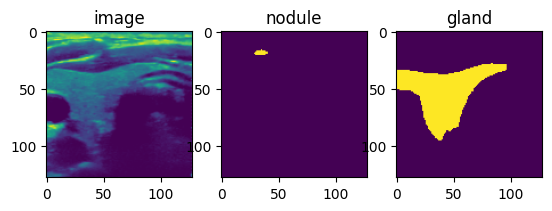

 91%|█████████ | 1806/1992 [37:49<01:40,  1.85it/s]

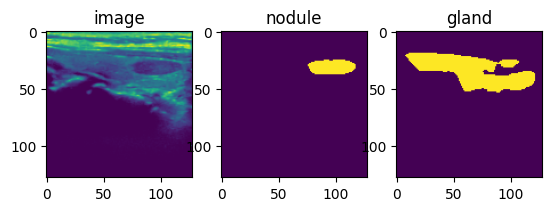

 91%|█████████ | 1811/1992 [37:51<01:19,  2.28it/s]

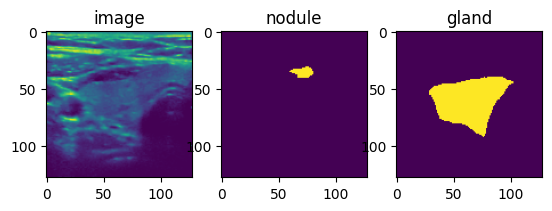

 91%|█████████ | 1816/1992 [37:52<00:33,  5.19it/s]

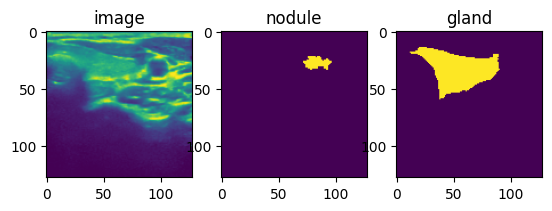

 91%|█████████▏| 1821/1992 [37:54<01:03,  2.71it/s]

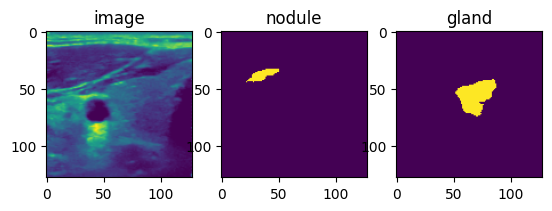

 92%|█████████▏| 1825/1992 [37:56<01:29,  1.86it/s]

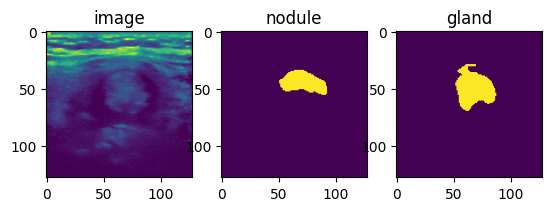

 92%|█████████▏| 1831/1992 [37:58<00:45,  3.58it/s]

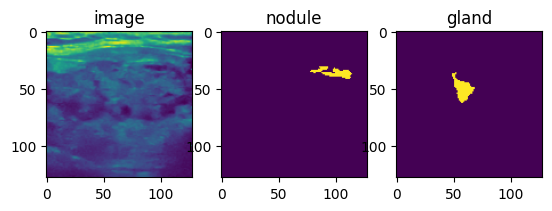

 92%|█████████▏| 1835/1992 [37:59<00:32,  4.89it/s]

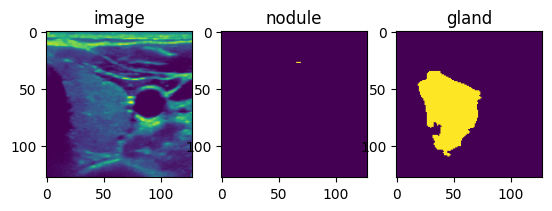

 92%|█████████▏| 1840/1992 [38:03<01:39,  1.53it/s]

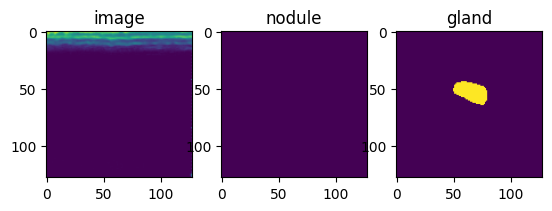

 93%|█████████▎| 1845/1992 [38:06<01:18,  1.87it/s]

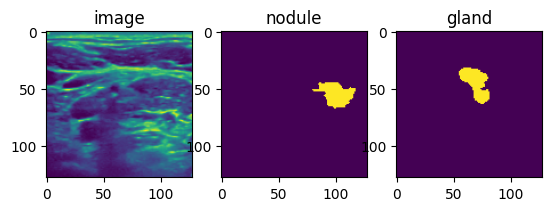

 93%|█████████▎| 1850/1992 [38:07<00:46,  3.04it/s]

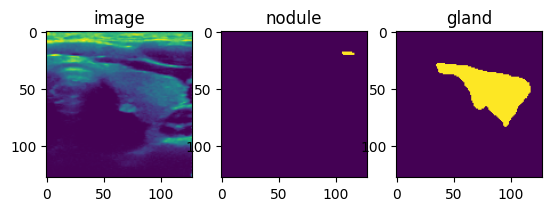

 93%|█████████▎| 1855/1992 [38:08<00:34,  4.01it/s]

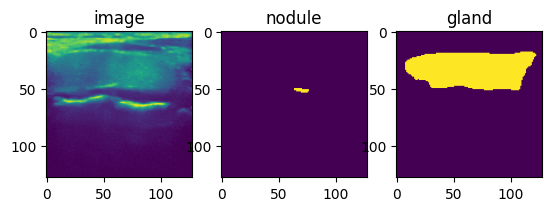

 93%|█████████▎| 1861/1992 [38:09<00:17,  7.30it/s]

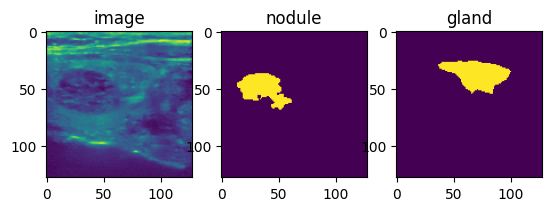

 94%|█████████▎| 1866/1992 [38:10<00:12,  9.80it/s]

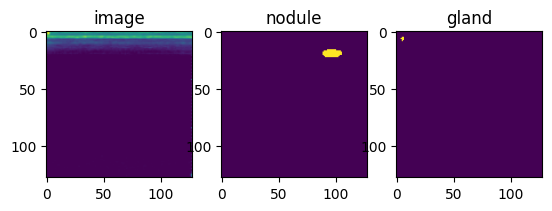

 94%|█████████▍| 1870/1992 [38:10<00:12,  9.72it/s]

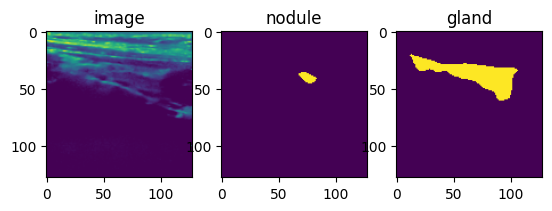

 94%|█████████▍| 1876/1992 [38:11<00:10, 10.65it/s]

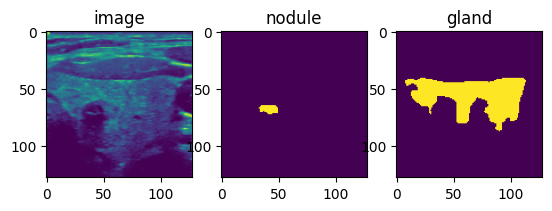

 94%|█████████▍| 1880/1992 [38:11<00:12,  9.29it/s]

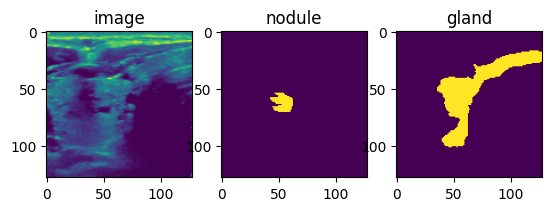

 95%|█████████▍| 1886/1992 [38:12<00:10, 10.20it/s]

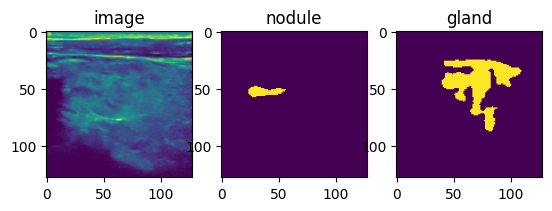

 95%|█████████▍| 1890/1992 [38:12<00:10,  9.73it/s]

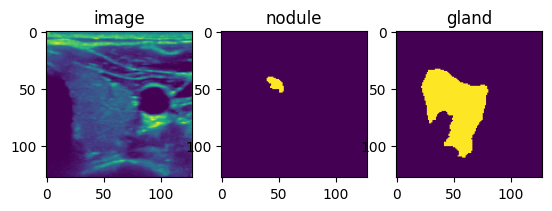

 95%|█████████▌| 1896/1992 [38:13<00:09, 10.64it/s]

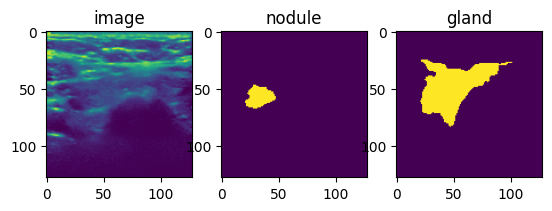

 95%|█████████▌| 1900/1992 [38:13<00:09,  9.84it/s]

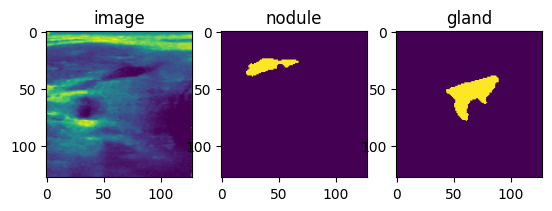

 96%|█████████▌| 1906/1992 [38:14<00:08,  9.78it/s]

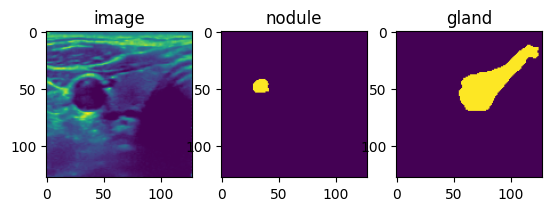

 96%|█████████▌| 1911/1992 [38:14<00:08,  9.00it/s]

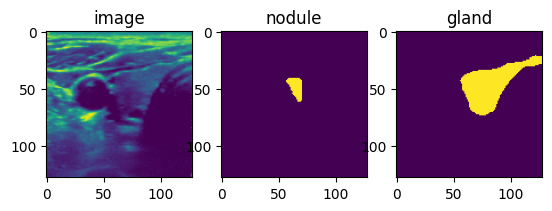

 96%|█████████▌| 1916/1992 [38:15<00:07,  9.86it/s]

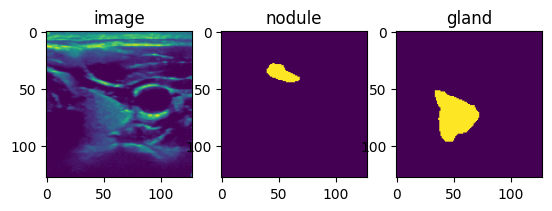

 96%|█████████▋| 1920/1992 [38:16<00:07,  9.27it/s]

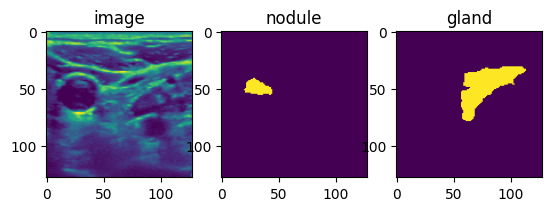

 97%|█████████▋| 1926/1992 [38:16<00:06,  9.87it/s]

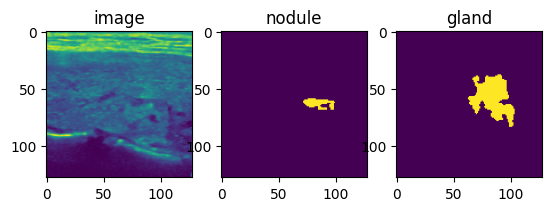

 97%|█████████▋| 1930/1992 [38:17<00:06,  9.85it/s]

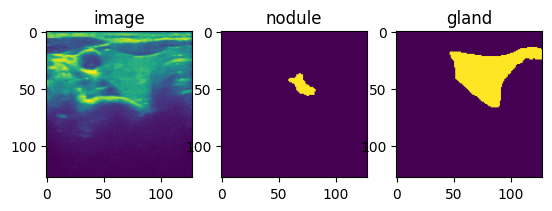

 97%|█████████▋| 1936/1992 [38:17<00:05, 10.29it/s]

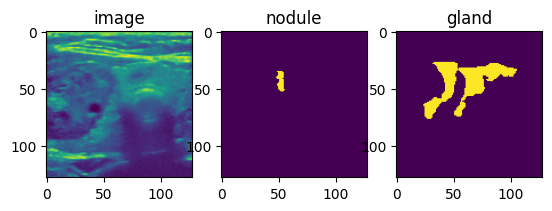

 97%|█████████▋| 1940/1992 [38:18<00:05,  9.50it/s]

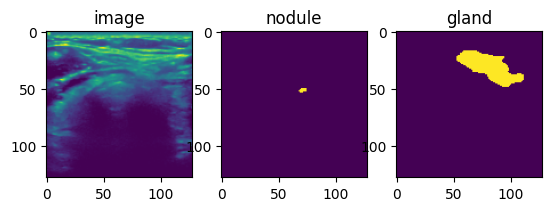

 98%|█████████▊| 1946/1992 [38:19<00:05,  7.90it/s]

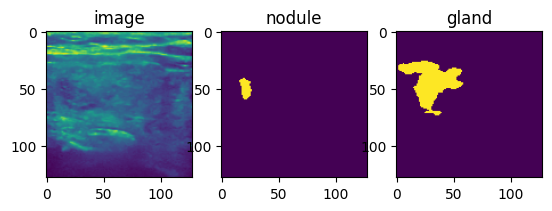

 98%|█████████▊| 1950/1992 [38:19<00:05,  7.46it/s]

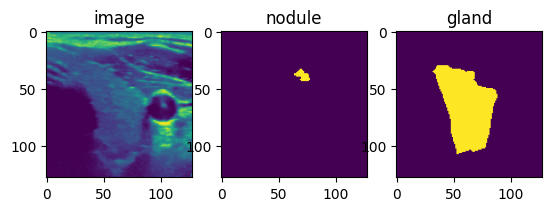

 98%|█████████▊| 1956/1992 [38:20<00:03,  9.53it/s]

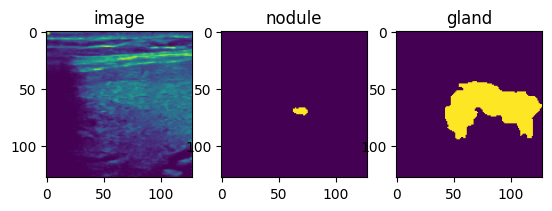

 98%|█████████▊| 1960/1992 [38:20<00:03,  9.09it/s]

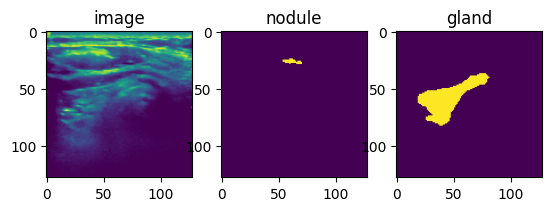

 99%|█████████▊| 1966/1992 [38:21<00:02, 10.25it/s]

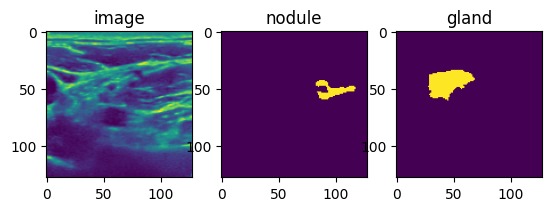

 99%|█████████▉| 1970/1992 [38:22<00:02,  9.74it/s]

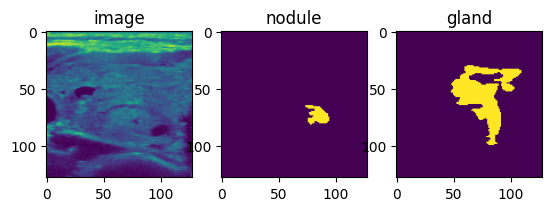

 99%|█████████▉| 1976/1992 [38:22<00:01, 10.61it/s]

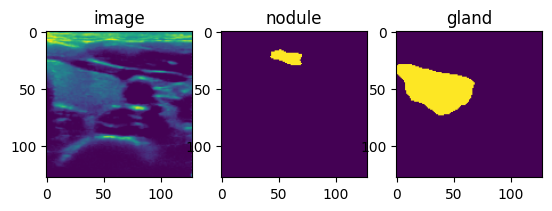

 99%|█████████▉| 1980/1992 [38:23<00:01,  9.65it/s]

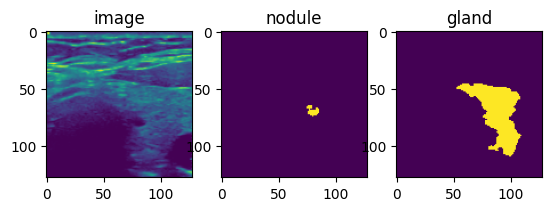

100%|█████████▉| 1986/1992 [38:25<00:01,  3.84it/s]

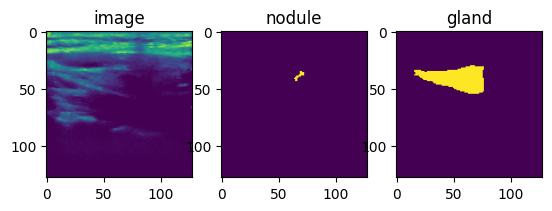

100%|█████████▉| 1991/1992 [38:26<00:00,  4.50it/s]

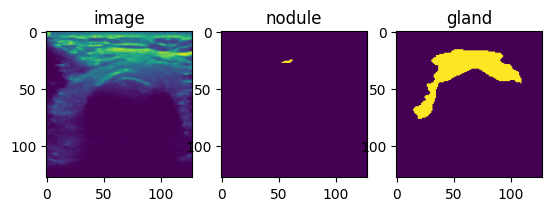

100%|██████████| 1992/1992 [38:26<00:00,  1.16s/it]


In [46]:
count = 0
for i in tqdm(range(len(image_dir))):
    image_name = image_dir[i]
    if not "png" in image_name:
        continue
    image_path = f"images/{image_name}"
    image = Image.open(image_path).convert("L")

    resize = T.Resize((image_size, image_size))
    image = resize(image)

    image_tensor = tx.to_tensor(image)

    # If standardization
    mean = image_tensor.mean()
    std = image_tensor.std()
    std = std if std > 0 else 1.0  # avoid division by zero
    image_tensor = (image_tensor - mean) / std
    image = image_tensor.unsqueeze(0)
    output = model(image)
    
    nodule_output = output[:, 0:1]
    gland_output = output[:, 1:2]

    # nodule_output = torch.sigmoid(nodule_output)
    nodule_output = postprocess_logits_with_fill(nodule_output, 0.99)

    gland_output = postprocess_logits_with_fill(gland_output, 0.9)
    # print(gland_output.shape)

    nodule_image = Image.fromarray(nodule_output[0][0].detach().cpu().numpy())
    gland_image = Image.fromarray(gland_output[0][0].detach().cpu().numpy())

    # nodule_image.save(f"inference_mask_v2/nodule/{image_name}")
    # gland_image.save(f"inference_mask_v2/gland/{image_name}")


    if count%5 == 0:
        plt.subplot(1,3,1)
        plt.imshow(image[0][0].detach().cpu().numpy())
        plt.title("image")
        plt.subplot(1,3,2)
        plt.imshow(nodule_output[0][0].detach().cpu().numpy())
        plt.title("nodule")
        plt.subplot(1,3,3)
        plt.imshow(gland_output[0][0].detach().cpu().numpy())
        plt.title("gland")
        plt.show()
    count+=1
    # if count > 30:
    #     break
    # break

In [39]:
np.unique(gland_output)

array([False,  True])

In [40]:
np.unique(nodule_output)\

array([False,  True])

In [25]:
from HarDMSEG import HarDMSEG
model = HarDMSEG()

state_dict = torch.load('./best.pth')
model.load_state_dict(state_dict)
# model.to(device)
model.eval()
img_transform = transforms.Compose([
                        transforms.Resize((256,256)),
                        transforms.ToTensor(),
                        transforms.Normalize([0.485, 0.456, 0.406],
                           [0.229, 0.224, 0.225])])

68 LOADED
68 LOADED READY


  0%|          | 0/1992 [00:00<?, ?it/s]

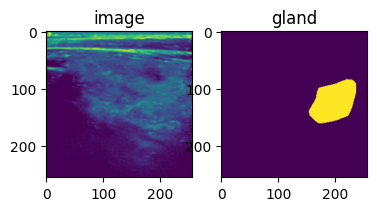

  0%|          | 1/1992 [00:00<19:45,  1.68it/s]

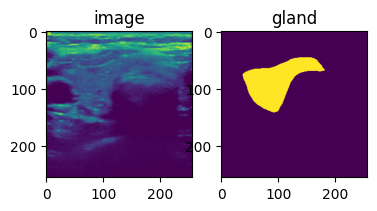

  0%|          | 2/1992 [00:00<13:42,  2.42it/s]

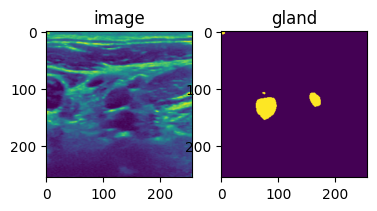

  0%|          | 3/1992 [00:01<11:51,  2.80it/s]

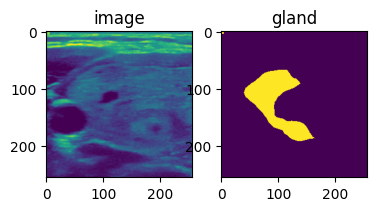

  0%|          | 4/1992 [00:01<11:00,  3.01it/s]

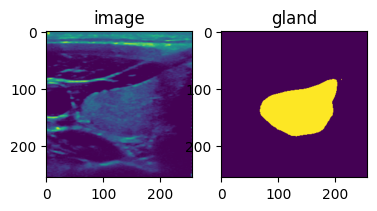

  0%|          | 5/1992 [00:01<10:29,  3.16it/s]

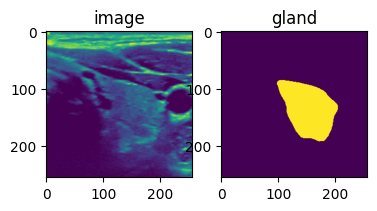

  0%|          | 6/1992 [00:02<10:10,  3.25it/s]

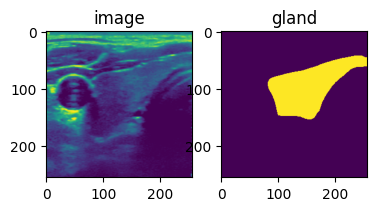

  0%|          | 7/1992 [00:02<14:08,  2.34it/s]

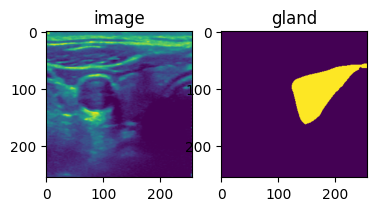

  0%|          | 8/1992 [00:03<17:23,  1.90it/s]

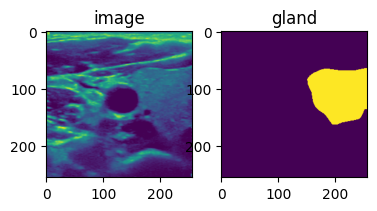

  0%|          | 9/1992 [00:03<15:43,  2.10it/s]

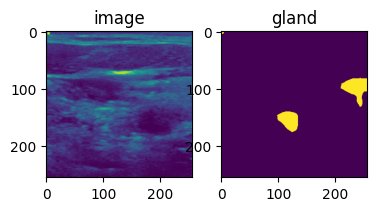

  1%|          | 10/1992 [00:04<20:49,  1.59it/s]

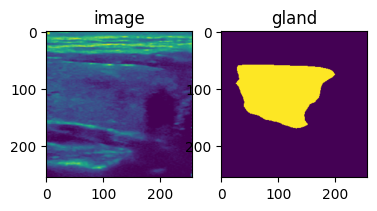

  1%|          | 11/1992 [00:05<23:02,  1.43it/s]

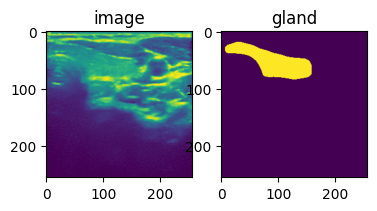

  1%|          | 12/1992 [00:06<21:27,  1.54it/s]

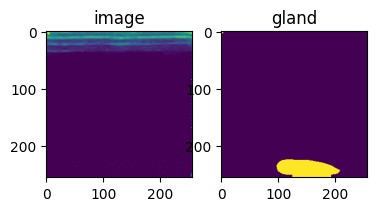

  1%|          | 13/1992 [00:08<36:23,  1.10s/it]

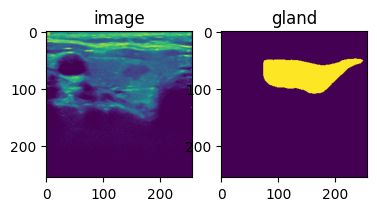

  1%|          | 14/1992 [00:08<31:05,  1.06it/s]

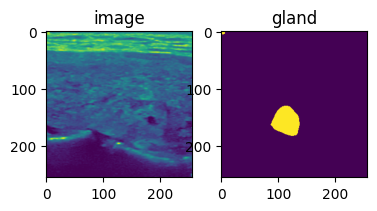

  1%|          | 15/1992 [00:09<27:51,  1.18it/s]

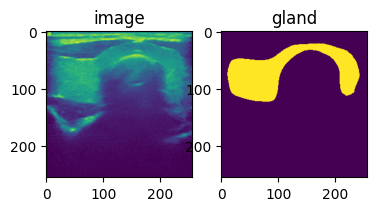

  1%|          | 16/1992 [00:10<25:13,  1.31it/s]

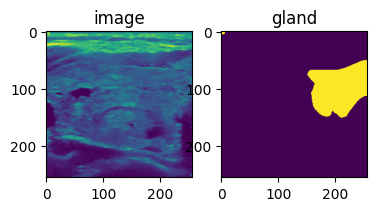

  1%|          | 17/1992 [00:10<25:46,  1.28it/s]

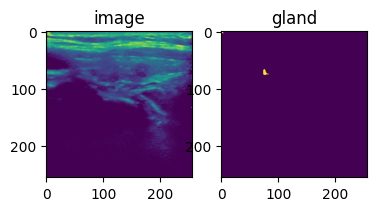

  1%|          | 18/1992 [00:11<23:26,  1.40it/s]

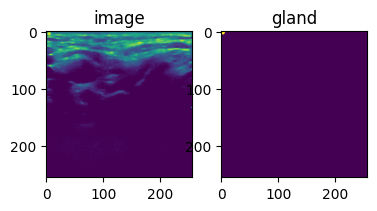

  1%|          | 19/1992 [00:12<25:14,  1.30it/s]

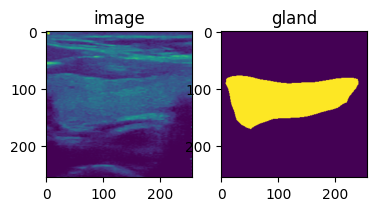

  1%|          | 20/1992 [00:12<20:26,  1.61it/s]

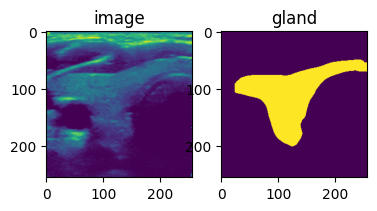

  1%|          | 21/1992 [00:13<22:49,  1.44it/s]

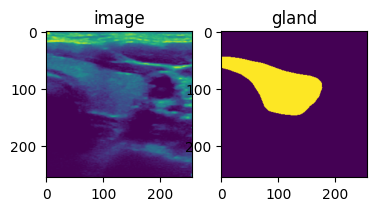

  1%|          | 22/1992 [00:13<19:00,  1.73it/s]

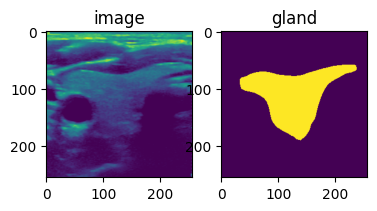

  1%|          | 23/1992 [00:15<27:35,  1.19it/s]

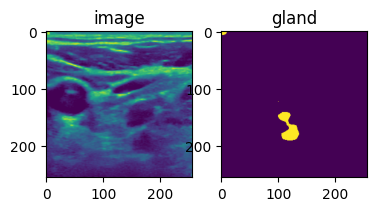

  1%|          | 24/1992 [00:15<22:09,  1.48it/s]

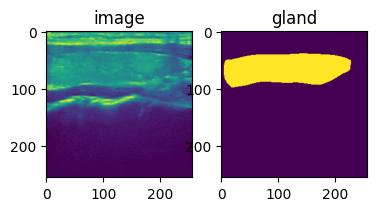

  1%|▏         | 25/1992 [00:16<22:52,  1.43it/s]

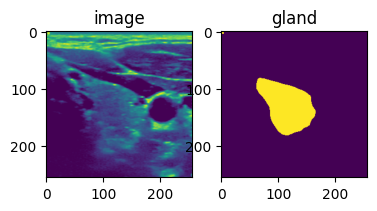

  1%|▏         | 26/1992 [00:16<19:14,  1.70it/s]

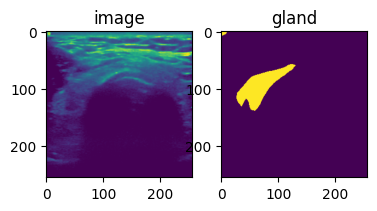

  1%|▏         | 27/1992 [00:17<17:15,  1.90it/s]

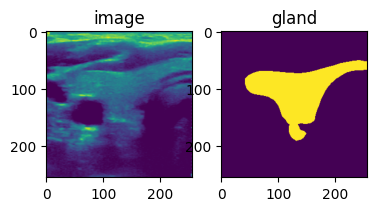

  1%|▏         | 28/1992 [00:17<21:15,  1.54it/s]

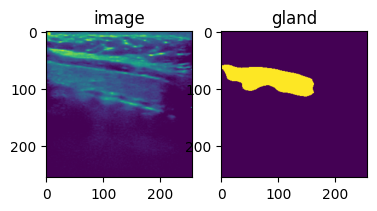

  1%|▏         | 29/1992 [00:18<24:09,  1.35it/s]

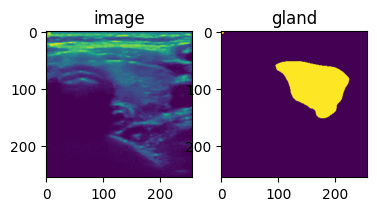

  2%|▏         | 30/1992 [00:19<19:38,  1.66it/s]

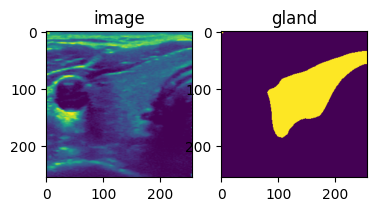

  2%|▏         | 31/1992 [00:19<16:47,  1.95it/s]

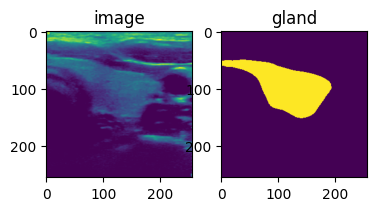

  2%|▏         | 32/1992 [00:19<14:40,  2.23it/s]

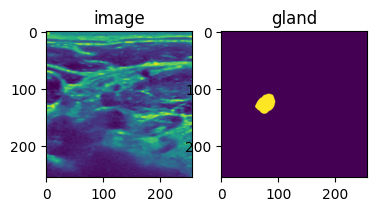

  2%|▏         | 33/1992 [00:20<13:08,  2.49it/s]

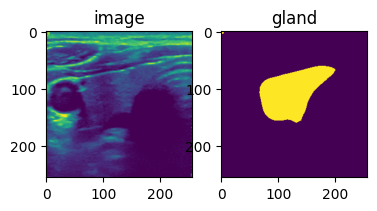

  2%|▏         | 34/1992 [00:20<12:00,  2.72it/s]

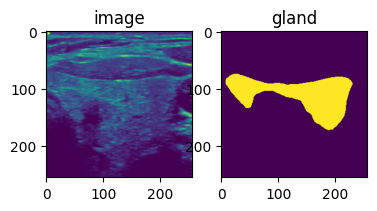

  2%|▏         | 35/1992 [00:20<13:31,  2.41it/s]

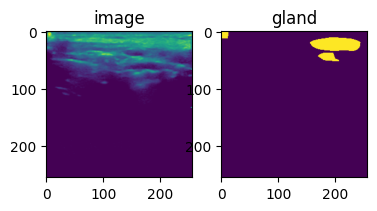

  2%|▏         | 36/1992 [00:21<12:13,  2.67it/s]

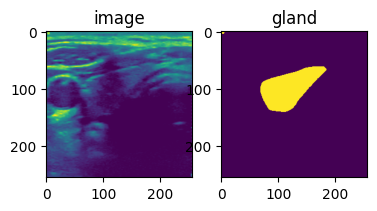

  2%|▏         | 37/1992 [00:21<11:39,  2.80it/s]

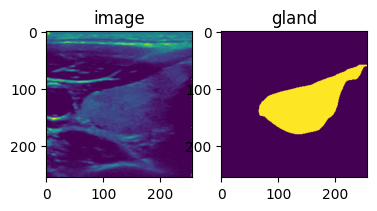

  2%|▏         | 38/1992 [00:22<20:38,  1.58it/s]

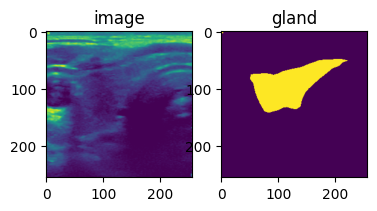

  2%|▏         | 39/1992 [00:23<22:20,  1.46it/s]

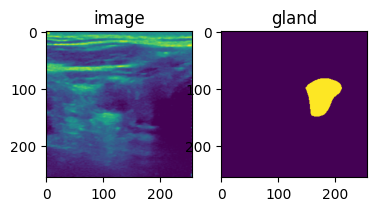

  2%|▏         | 40/1992 [00:23<18:27,  1.76it/s]

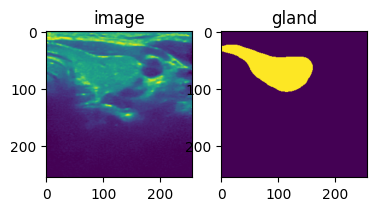

  2%|▏         | 41/1992 [00:24<15:44,  2.07it/s]

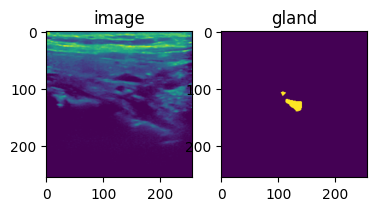

  2%|▏         | 42/1992 [00:24<14:01,  2.32it/s]

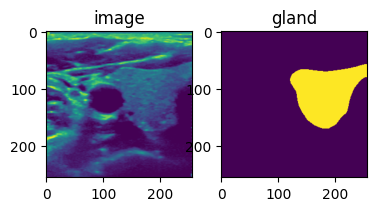

  2%|▏         | 43/1992 [00:25<16:57,  1.92it/s]

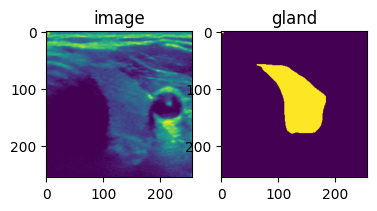

  2%|▏         | 44/1992 [00:26<23:34,  1.38it/s]

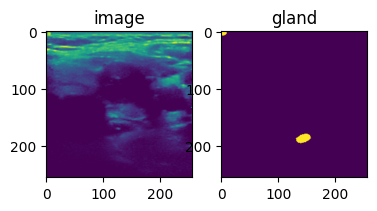

  2%|▏         | 45/1992 [00:26<21:25,  1.51it/s]

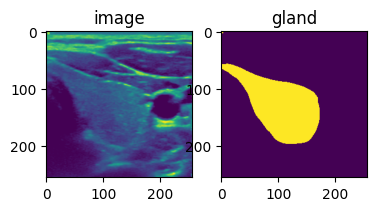

  2%|▏         | 46/1992 [00:28<25:39,  1.26it/s]

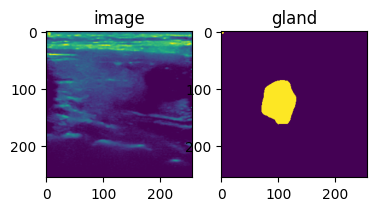

  2%|▏         | 47/1992 [00:29<32:10,  1.01it/s]

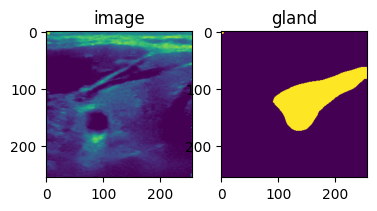

  2%|▏         | 48/1992 [00:29<25:27,  1.27it/s]

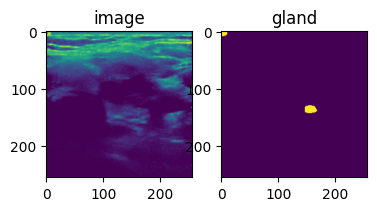

  2%|▏         | 49/1992 [00:30<20:32,  1.58it/s]

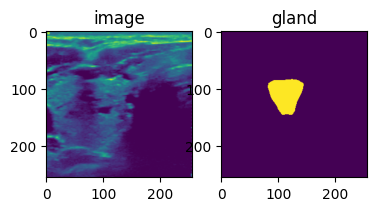

  3%|▎         | 50/1992 [00:31<25:22,  1.28it/s]

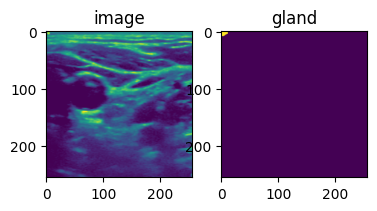

  3%|▎         | 51/1992 [00:31<20:59,  1.54it/s]

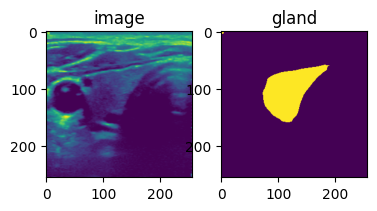

  3%|▎         | 52/1992 [00:32<26:59,  1.20it/s]

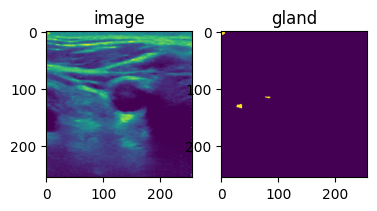

  3%|▎         | 53/1992 [00:33<21:42,  1.49it/s]

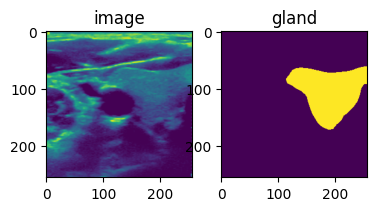

  3%|▎         | 54/1992 [00:33<18:01,  1.79it/s]

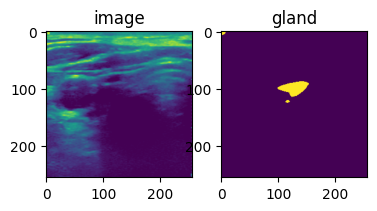

  3%|▎         | 55/1992 [00:33<17:49,  1.81it/s]

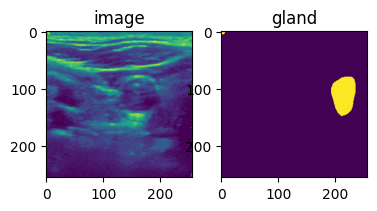

  3%|▎         | 56/1992 [00:34<18:04,  1.79it/s]

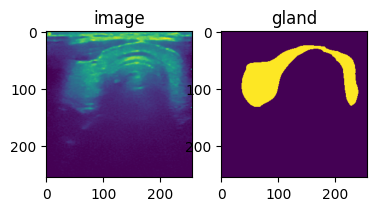

  3%|▎         | 57/1992 [00:34<15:50,  2.04it/s]

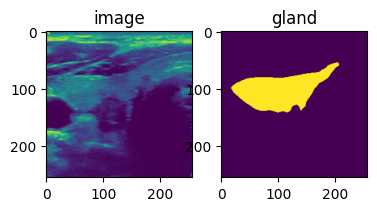

  3%|▎         | 58/1992 [00:35<16:58,  1.90it/s]

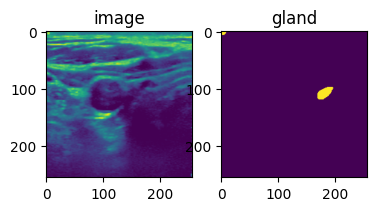

  3%|▎         | 59/1992 [00:37<27:58,  1.15it/s]

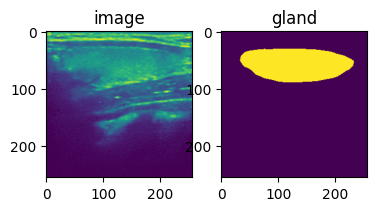

  3%|▎         | 60/1992 [00:37<23:28,  1.37it/s]

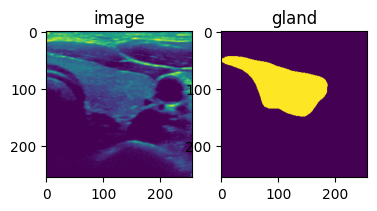

  3%|▎         | 61/1992 [00:38<27:27,  1.17it/s]

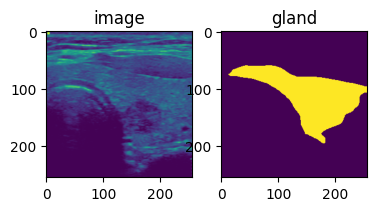

  3%|▎         | 62/1992 [00:40<32:36,  1.01s/it]

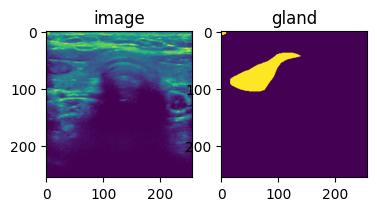

  3%|▎         | 63/1992 [00:40<25:37,  1.25it/s]

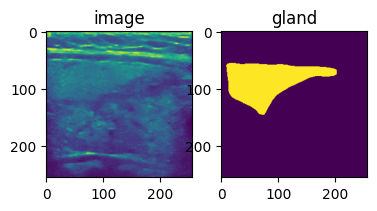

  3%|▎         | 64/1992 [00:40<20:40,  1.55it/s]

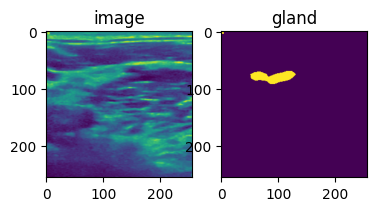

  3%|▎         | 65/1992 [00:40<17:20,  1.85it/s]

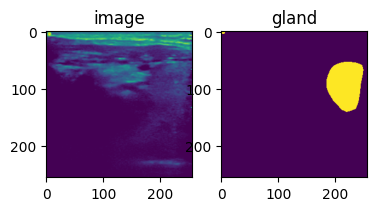

  3%|▎         | 66/1992 [00:42<30:22,  1.06it/s]

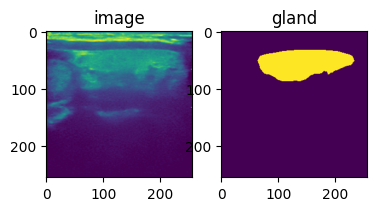

  3%|▎         | 67/1992 [00:43<29:33,  1.09it/s]

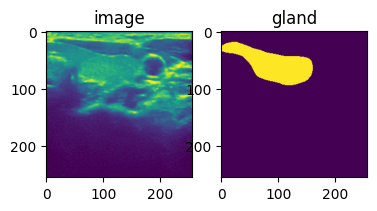

  3%|▎         | 68/1992 [00:44<31:12,  1.03it/s]

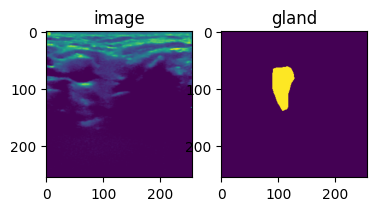

  3%|▎         | 69/1992 [00:45<24:37,  1.30it/s]

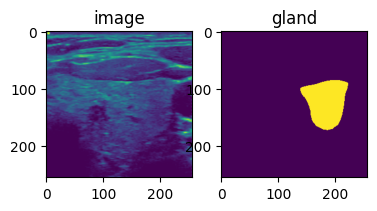

  4%|▎         | 70/1992 [00:45<20:20,  1.57it/s]

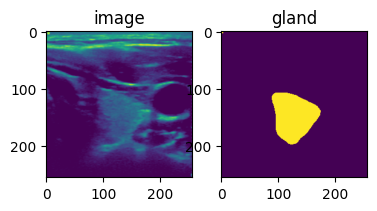

  4%|▎         | 71/1992 [00:45<17:55,  1.79it/s]

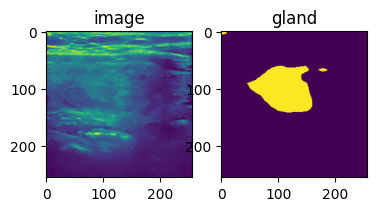

  4%|▎         | 72/1992 [00:46<15:15,  2.10it/s]

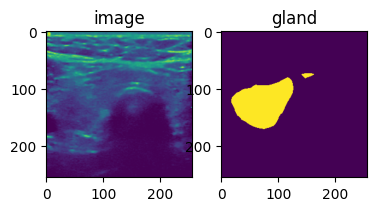

  4%|▎         | 73/1992 [00:46<19:05,  1.68it/s]

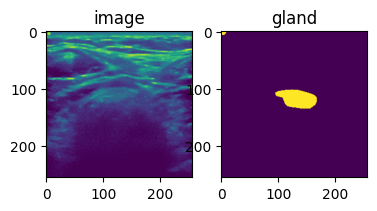

  4%|▎         | 74/1992 [00:48<26:50,  1.19it/s]

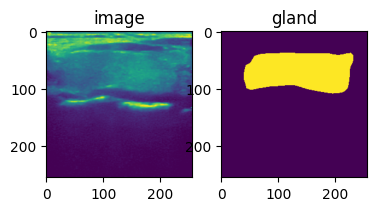

  4%|▍         | 75/1992 [00:48<23:16,  1.37it/s]

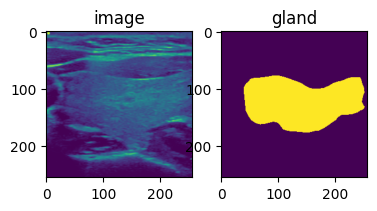

  4%|▍         | 76/1992 [00:49<23:27,  1.36it/s]

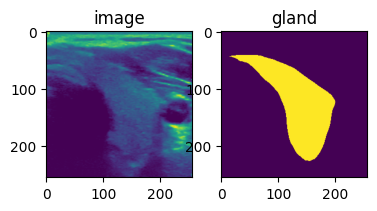

  4%|▍         | 77/1992 [00:50<24:38,  1.30it/s]

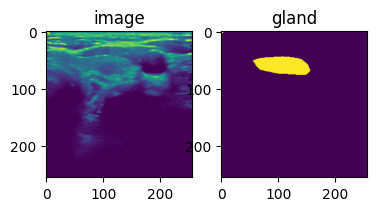

  4%|▍         | 78/1992 [00:50<21:10,  1.51it/s]

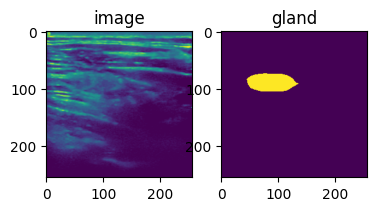

  4%|▍         | 79/1992 [00:51<20:22,  1.56it/s]

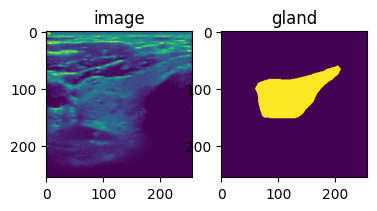

  4%|▍         | 80/1992 [00:51<17:57,  1.77it/s]

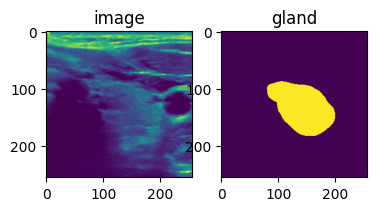

  4%|▍         | 81/1992 [00:52<20:26,  1.56it/s]

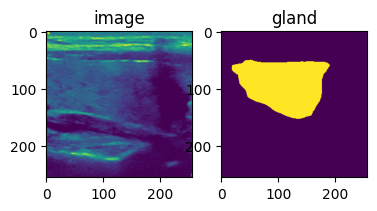

  4%|▍         | 82/1992 [00:54<31:13,  1.02it/s]

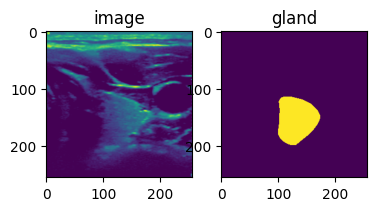

  4%|▍         | 83/1992 [00:54<26:12,  1.21it/s]

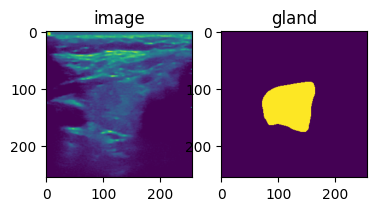

  4%|▍         | 84/1992 [00:56<30:39,  1.04it/s]

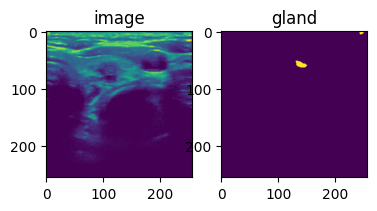

  4%|▍         | 85/1992 [00:56<26:15,  1.21it/s]

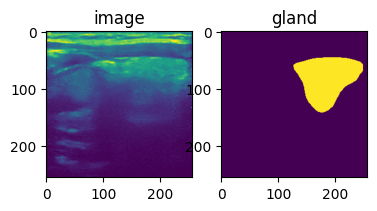

  4%|▍         | 86/1992 [00:57<27:07,  1.17it/s]

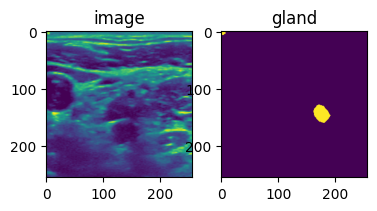

  4%|▍         | 87/1992 [00:58<28:46,  1.10it/s]

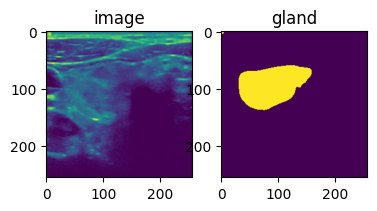

  4%|▍         | 88/1992 [00:59<27:33,  1.15it/s]

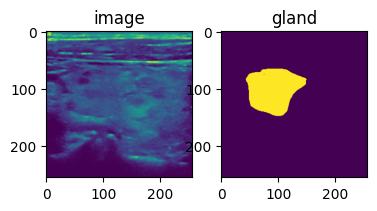

  4%|▍         | 89/1992 [01:00<30:04,  1.05it/s]

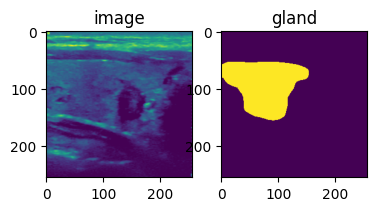

  5%|▍         | 90/1992 [01:00<23:56,  1.32it/s]

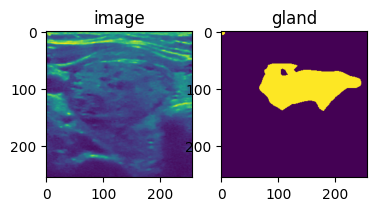

  5%|▍         | 91/1992 [01:03<41:01,  1.29s/it]

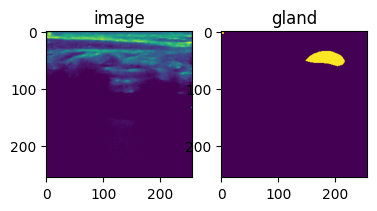

  5%|▍         | 92/1992 [01:04<34:58,  1.10s/it]

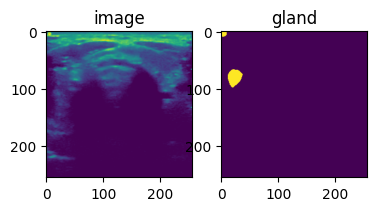

  5%|▍         | 93/1992 [01:04<27:16,  1.16it/s]

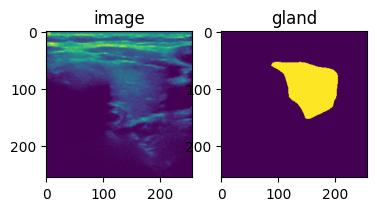

  5%|▍         | 94/1992 [01:06<35:49,  1.13s/it]

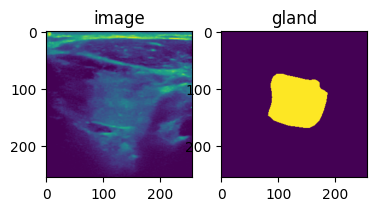

  5%|▍         | 95/1992 [01:06<27:46,  1.14it/s]

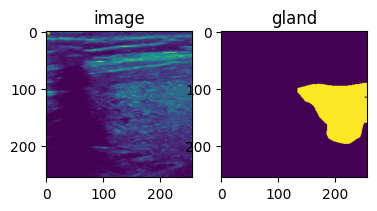

  5%|▍         | 96/1992 [01:06<22:28,  1.41it/s]

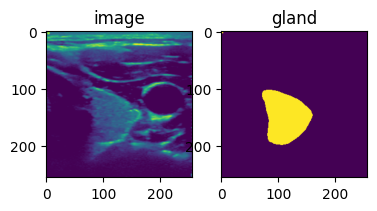

  5%|▍         | 97/1992 [01:07<23:53,  1.32it/s]

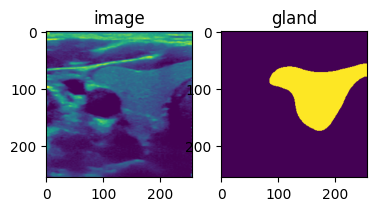

  5%|▍         | 98/1992 [01:07<19:31,  1.62it/s]

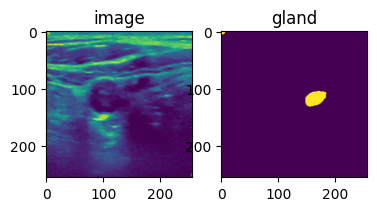

  5%|▍         | 99/1992 [01:08<16:27,  1.92it/s]

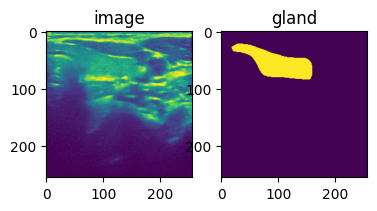

  5%|▌         | 100/1992 [01:08<14:28,  2.18it/s]

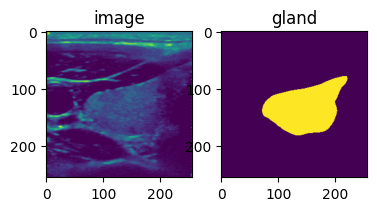

  5%|▌         | 100/1992 [01:10<22:04,  1.43it/s]


In [28]:
count = 0
for i in tqdm(range(len(image_dir))):
    image_name = image_dir[i]
    if not "png" in image_name:
        continue
    image_path = f"images/{image_name}"
    image = Image.open(image_path)
    
    image = img_transform(image)
    image = np.asarray(image)
    input_frame = np.expand_dims(image, axis=0)
    image = torch.tensor(input_frame)

    output = model(image)
    output = torch.sigmoid(output)
    output = output > 0.5
    
    
    plt.subplot(1,3,1)
    plt.imshow(image[0][0].detach().cpu().numpy())
    plt.title("image")
    plt.subplot(1,3,2)
    plt.imshow(output[0][0].detach().cpu().numpy())
    plt.title("gland")
    plt.show()
    count+=1
    if count > 100:
        break
    # break

In [27]:
torch.unique(output)

tensor([-58.8556, -58.7904, -58.4700,  ...,  12.0592,  12.0649,  12.1262],
       grad_fn=<Unique2Backward0>)